# **Uploading the zip file and reading it**
We will be following the below mentioned steps for EDA( Exploratory Data Analysis) :


*   Upload a zip folder containing csv file for all 5 dates
*   Rename it as 'data.zip' before extracting just for simplicity purposes
*   Extract the zip and read all the csv files separately
*   Merge all the files to form 'df'





In [ ]:
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

In [ ]:
import zipfile
with zipfile.ZipFile("data.zip","r") as zip_ref:
    zip_ref.extractall("targetdir")

In [ ]:
import pandas as pd

date1 = pd.read_csv("/content/targetdir/Report_01-04-2021.csv")
date2 = pd.read_csv("/content/targetdir/Report_02-04-2021.csv")
date3 = pd.read_csv("/content/targetdir/Report_03-04-2021.csv")
date4 = pd.read_csv("/content/targetdir/Report_04-04-2021.csv")
date5 = pd.read_csv("/content/targetdir/Report_05-04-2021.csv")

print(date1.head())


            Date_Time  AssetName  AC Power  ...  GHI  Module Temp  GTI
0  4/1/21 12:00:00 AM  ICR1_INV1       0.0  ...  NaN          NaN  NaN
1  4/1/21 12:05:00 AM  ICR1_INV1       0.0  ...  NaN          NaN  NaN
2  4/1/21 12:10:00 AM  ICR1_INV1       0.0  ...  NaN          NaN  NaN
3  4/1/21 12:15:00 AM  ICR1_INV1       0.0  ...  NaN          NaN  NaN
4  4/1/21 12:20:00 AM  ICR1_INV1       0.0  ...  NaN          NaN  NaN

[5 rows x 21 columns]


# Merging all CSV

In [ ]:
import os
import glob

path = r'/content/targetdir'                     
all_files = glob.glob(os.path.join(path, "*.csv"))     

df_from_each_file = (pd.read_csv(f) for f in all_files)
df   = pd.concat(df_from_each_file, ignore_index=True)
df['Date_Time'] = pd.to_datetime(df['Date_Time'])
df.sort_values(by='Date_Time', inplace=True, ascending=True)
df.head()

,Date_Time,AssetName,AC Power,DC Power,AC Current Phase12,AC Current Phase23,AC Current Phase31,AC voltage Phase12,AC voltage Phase23,AC voltage Phase31,MCR Export Power,MCR AC Voltage Phase1,MCR AC Voltage Phase2,MCR AC Voltage Phase3,MCR AC Current Phase1,MCR AC Current Phase2,MCR AC Current Phase3,Ambient Temp,GHI,Module Temp,GTI
21600,2021-04-01,ICR1_INV4,0.0,0.0,4.0,1.0,1.0,644.0,639.0,637.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
24768,2021-04-01,ICR4_INV3,0.0,0.0,1.0,3.0,2.0,648.0,637.0,643.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
23616,2021-04-01,ICR3_INV3,0.0,0.0,1.0,1.0,2.0,643.0,637.0,640.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25344,2021-04-01,ICR5_INV1,0.0,0.0,2.0,2.0,1.0,640.0,636.0,638.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
23904,2021-04-01,ICR3_INV4,0.0,0.0,1.0,1.0,4.0,644.0,635.0,639.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# EDA

# **EDA for features wrt datetime and varying AssetName**

In [ ]:
df.AssetName.describe()

count         34560
unique           24
top       ICR6_INV1
freq           1440
Name: AssetName, dtype: object

In [ ]:
df

,Date_Time,AssetName,AC Power,DC Power,AC Current Phase12,AC Current Phase23,AC Current Phase31,AC voltage Phase12,AC voltage Phase23,AC voltage Phase31,MCR Export Power,MCR AC Voltage Phase1,MCR AC Voltage Phase2,MCR AC Voltage Phase3,MCR AC Current Phase1,MCR AC Current Phase2,MCR AC Current Phase3,Ambient Temp,GHI,Module Temp,GTI
21600,2021-04-01 00:00:00,ICR1_INV4,0.0,0.0,4.0,1.0,1.0,644.0,639.0,637.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
24768,2021-04-01 00:00:00,ICR4_INV3,0.0,0.0,1.0,3.0,2.0,648.0,637.0,643.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
23616,2021-04-01 00:00:00,ICR3_INV3,0.0,0.0,1.0,1.0,2.0,643.0,637.0,640.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25344,2021-04-01 00:00:00,ICR5_INV1,0.0,0.0,2.0,2.0,1.0,640.0,636.0,638.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
23904,2021-04-01 00:00:00,ICR3_INV4,0.0,0.0,1.0,1.0,4.0,644.0,635.0,639.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28799,2021-04-05 23:55:00,ICR1_INV4,0.0,0.0,4.0,2.0,1.0,639.0,634.0,631.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
28511,2021-04-05 23:55:00,ICR1_INV3,0.0,0.0,2.0,1.0,2.0,649.0,643.0,644.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
28223,2021-04-05 23:55:00,ICR1_INV2,0.0,0.0,1.0,1.0,1.0,641.0,631.0,632.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31679,2021-04-05 23:55:00,ICR4_INV2,0.0,0.0,3.0,1.0,1.0,640.0,630.0,630.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


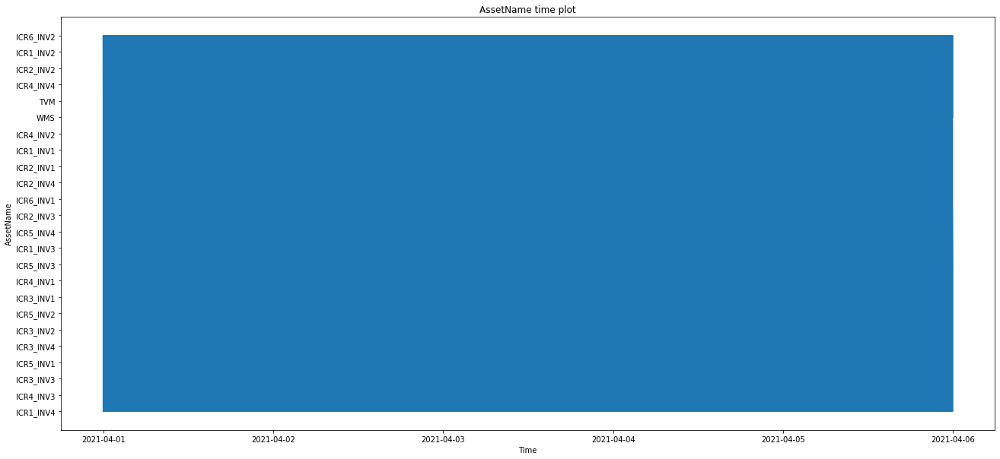

In [ ]:
import matplotlib.pyplot as plt

df['Date_Time'] = pd.to_datetime(df['Date_Time'])
plt.figure(figsize=(22,10))
plt.plot(df['Date_Time'], df['AssetName'])
plt.title('AssetName time plot')
plt.xlabel('Time')
plt.ylabel('AssetName')
plt.show()

# Conclusion of the above graph
It shows that we have AssetName with 24 unique values. The 24 values are available for each instance of time. Hence we can now take a look at other features such as current, voltage, temp, GTI, GHI etc. and analyse and make list of functions which we'll be using.<br>
**The output feature is 'DC Power'.** 

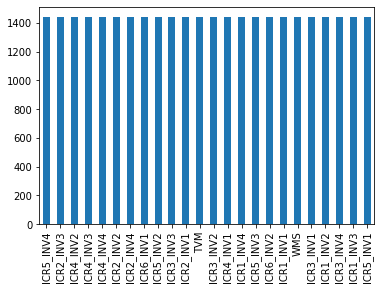

In [ ]:
pd.value_counts(df['AssetName']).plot.bar()

# Conclusion of the above graph
We have 1440 datetime points. We'll have to train and test our model by making divisions over this time period.

In [ ]:
assetnames = df['AssetName'].unique()

#**We'll take a look at how DC power varies along with each Asset name over time**

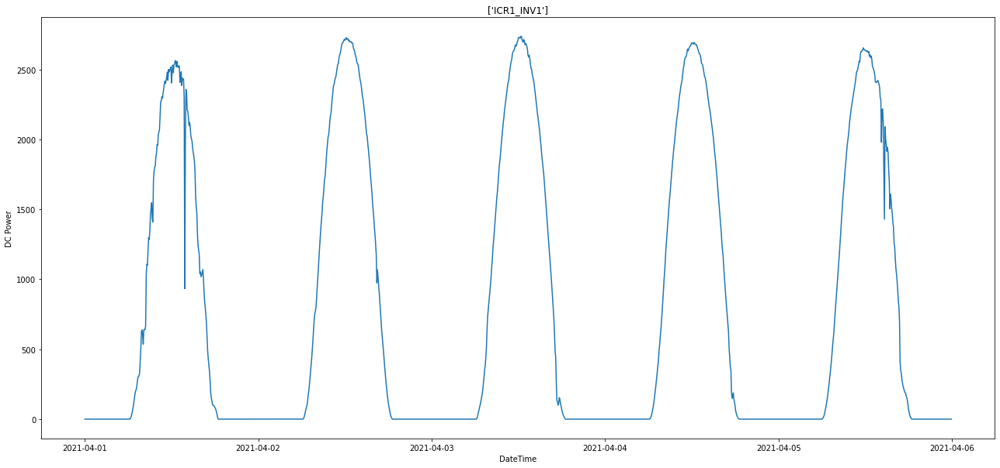

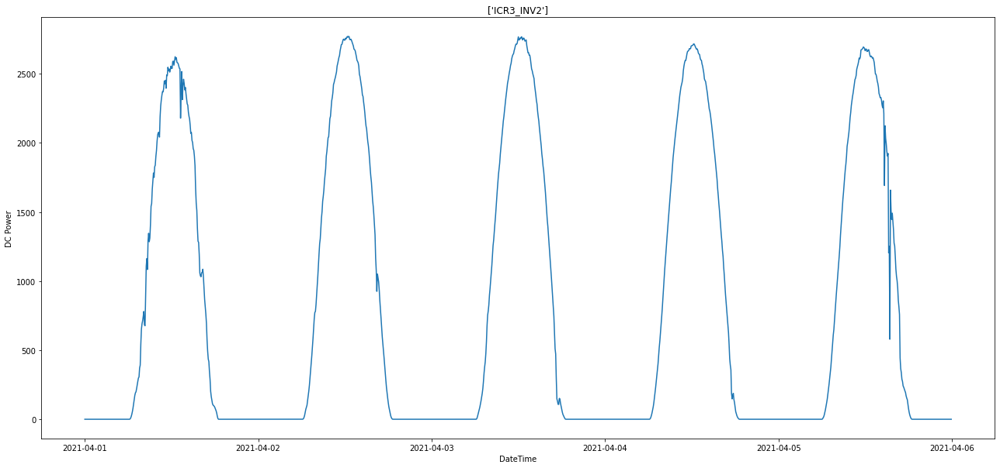

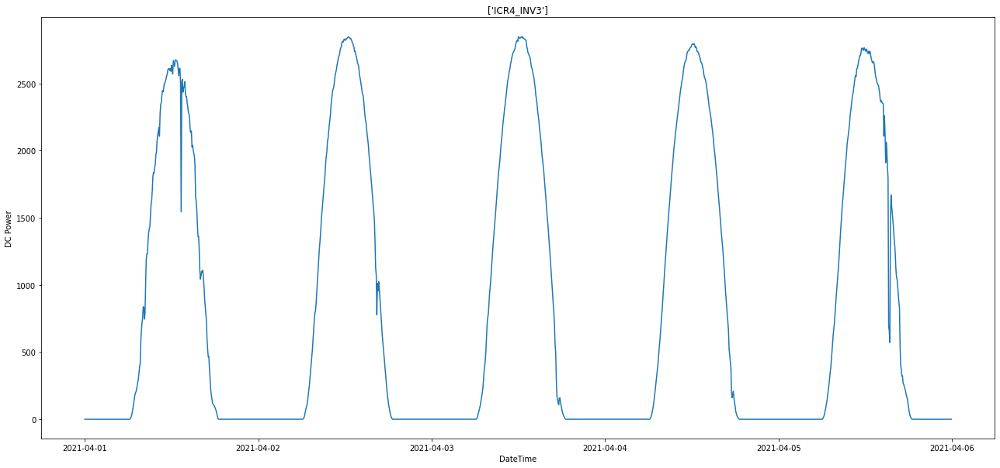

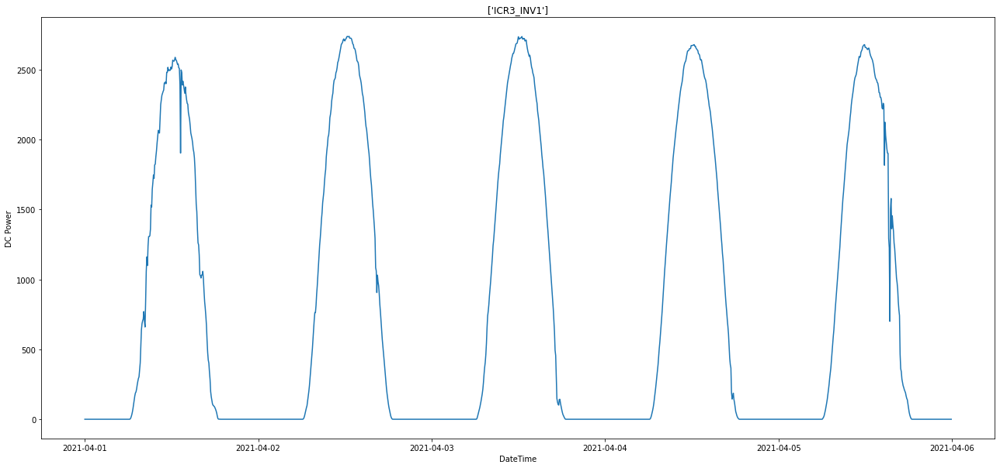

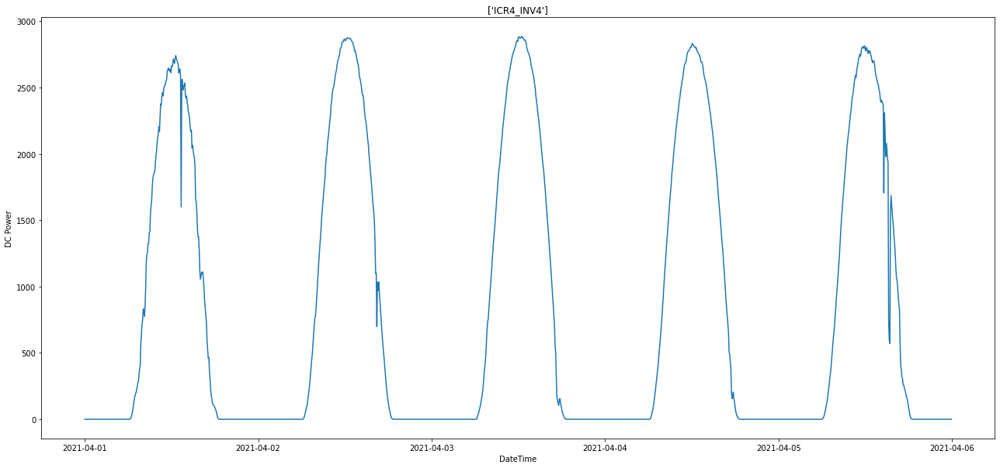

...

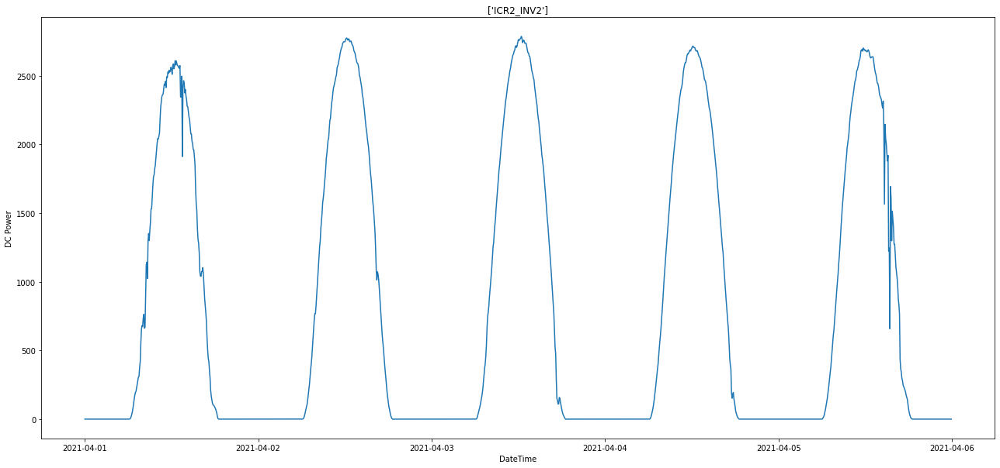

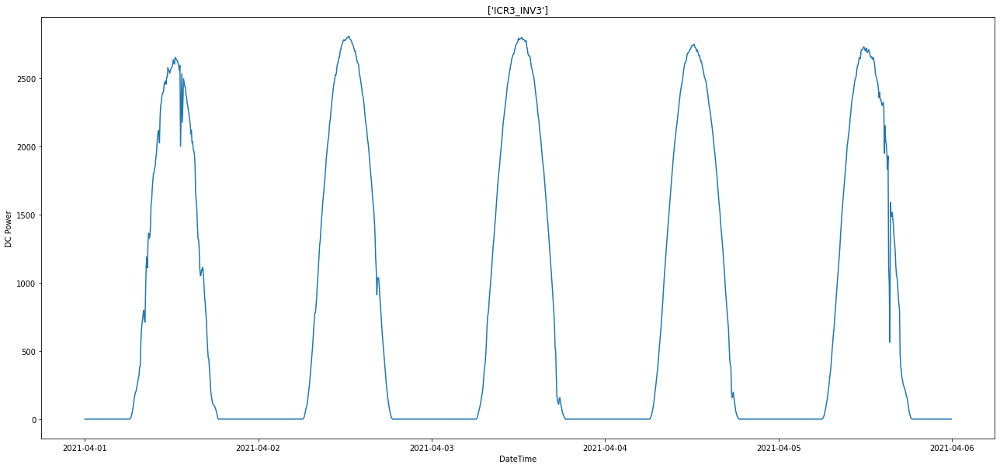

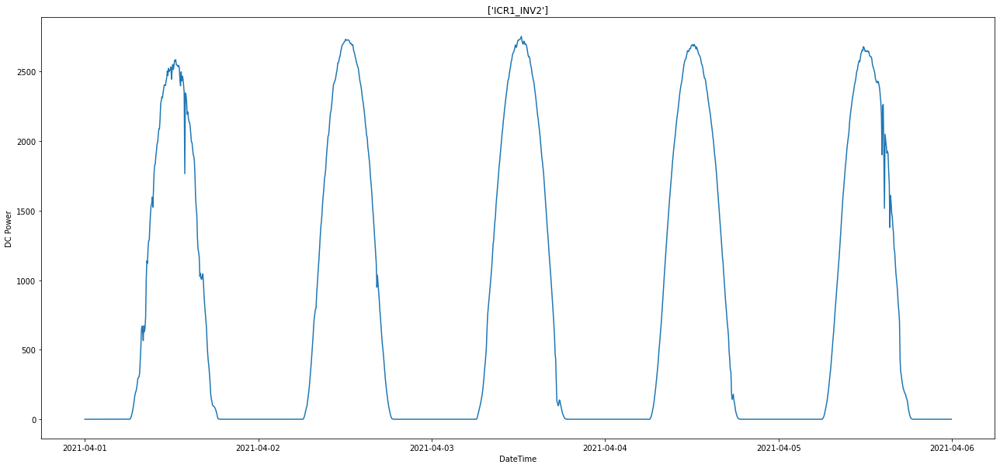

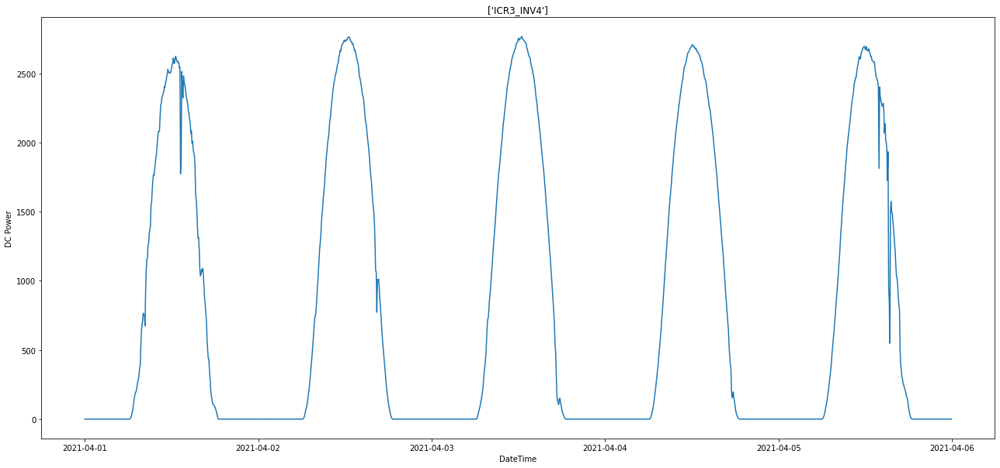

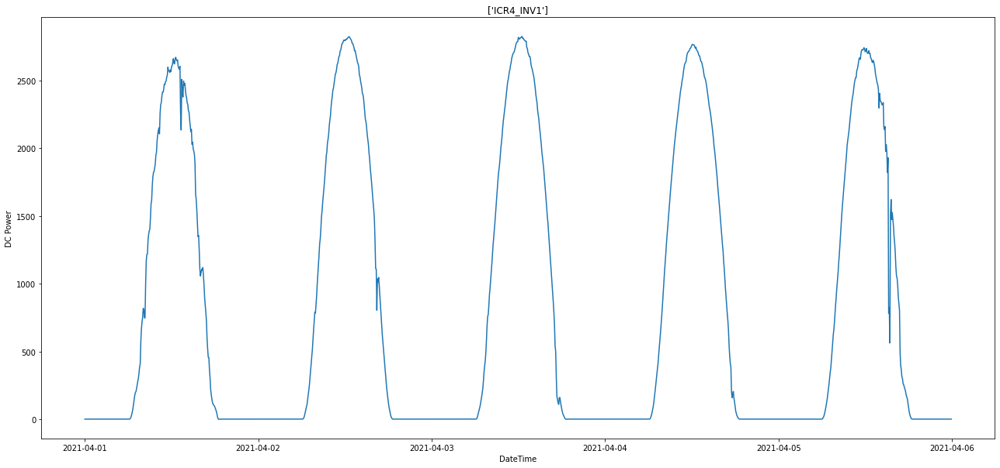

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['DC Power'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('DC Power')
  plt.show()
  #ICR1_INV1['DC Power'].describe()

# Conclusion : DC Power vs DateTime for various AssetNames
Except for WMS and TVM everything has non NaN values, but still it's better to keep it rather than deleting the rows. <br>
We can also see that the power output is zero for early morning and late night time periods, we can remove that part of data, or we can keep it incase we have datetime in this slot for our test set.

#**Analysis: Datetime vs Module temp and Ambient Temp for different Assetnames**

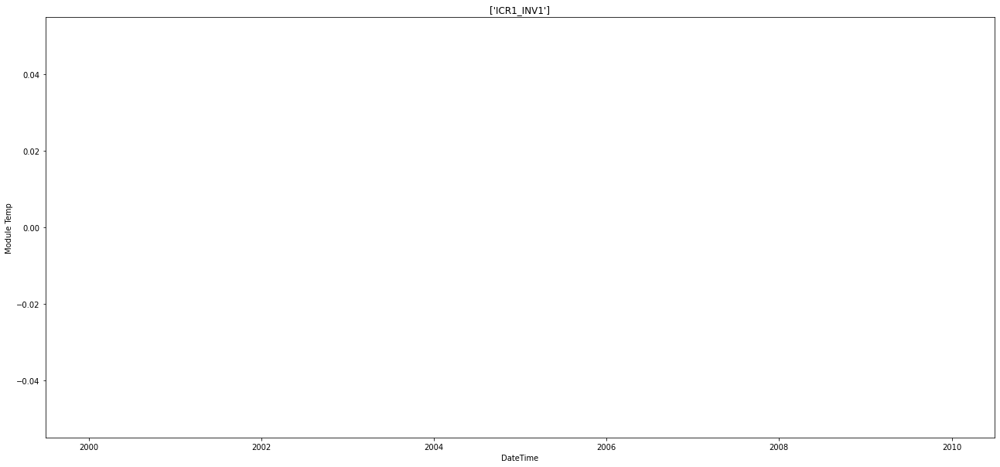

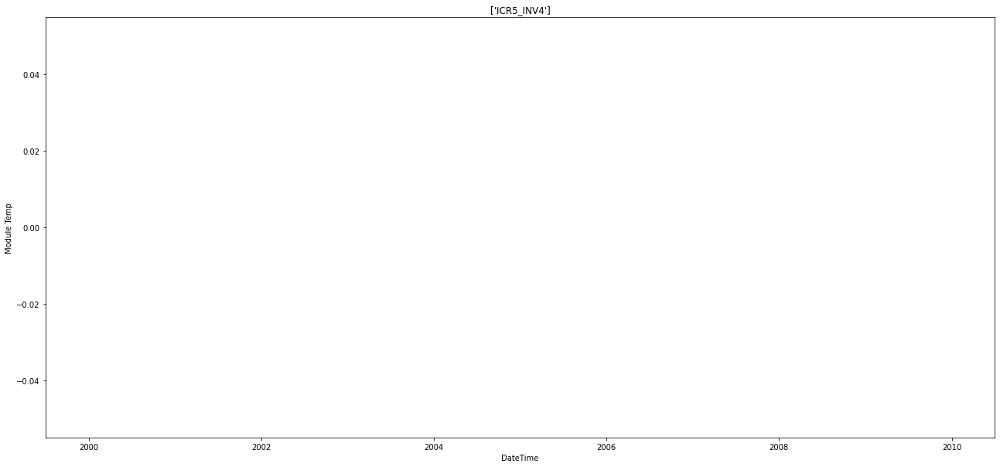

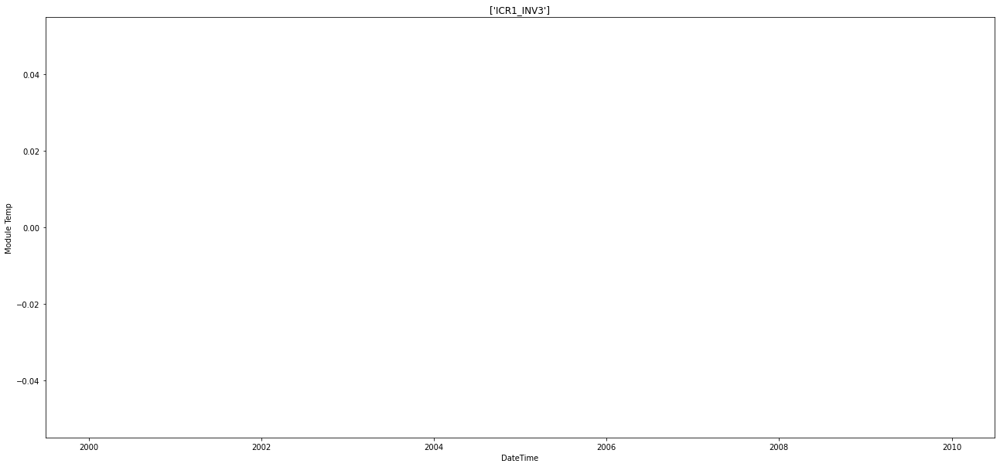

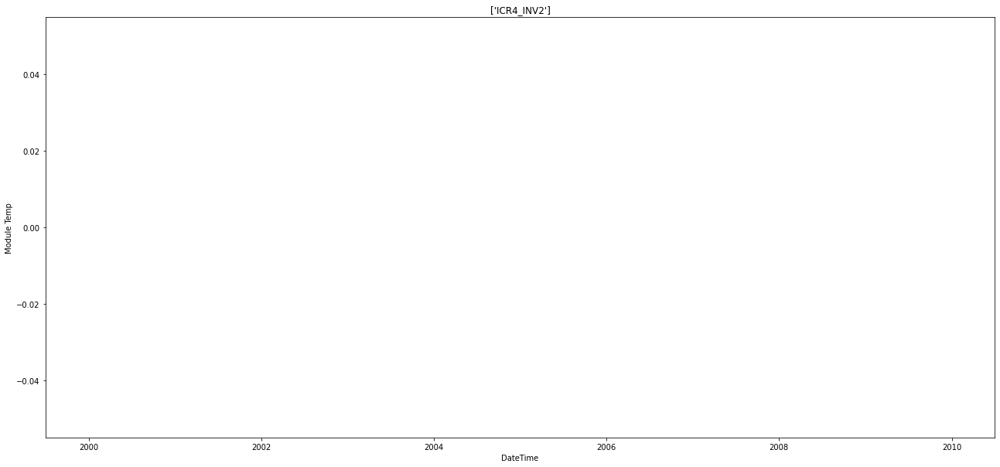

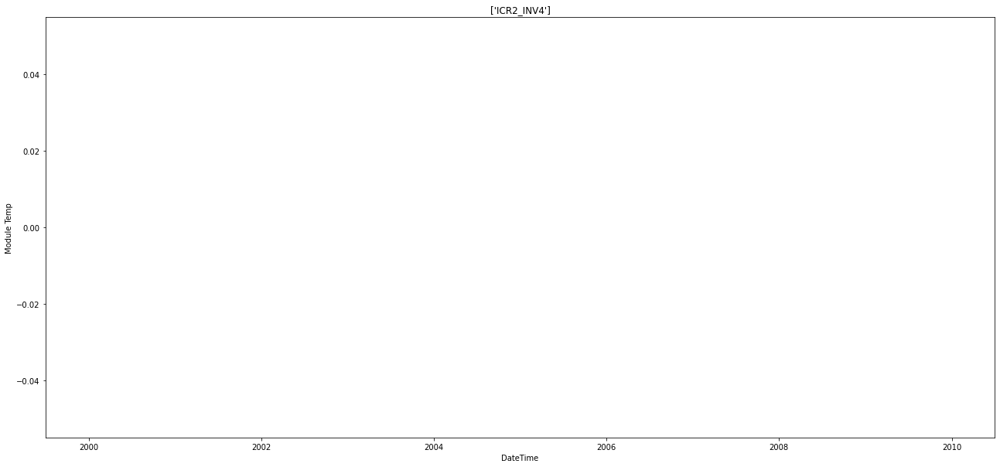

...

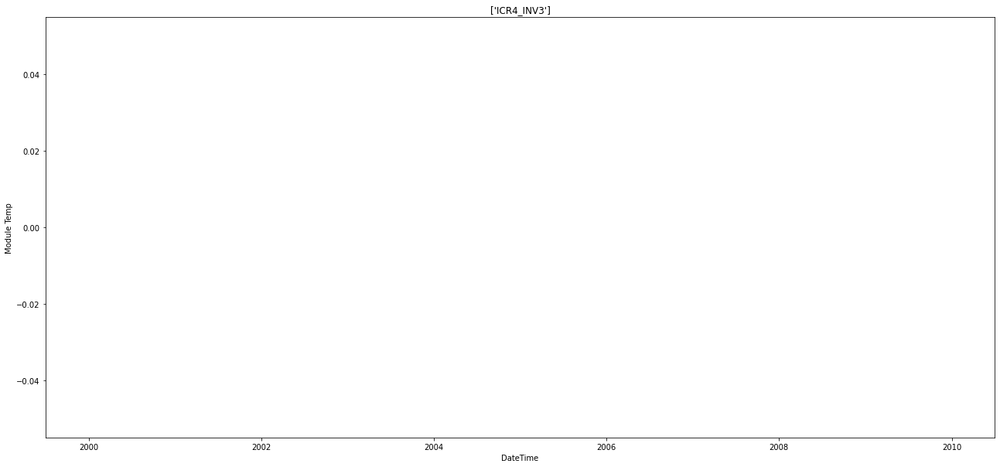

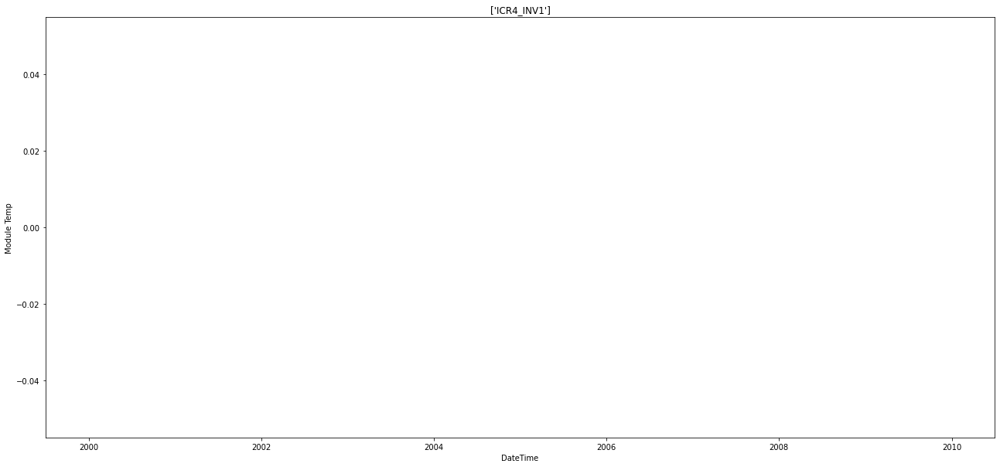

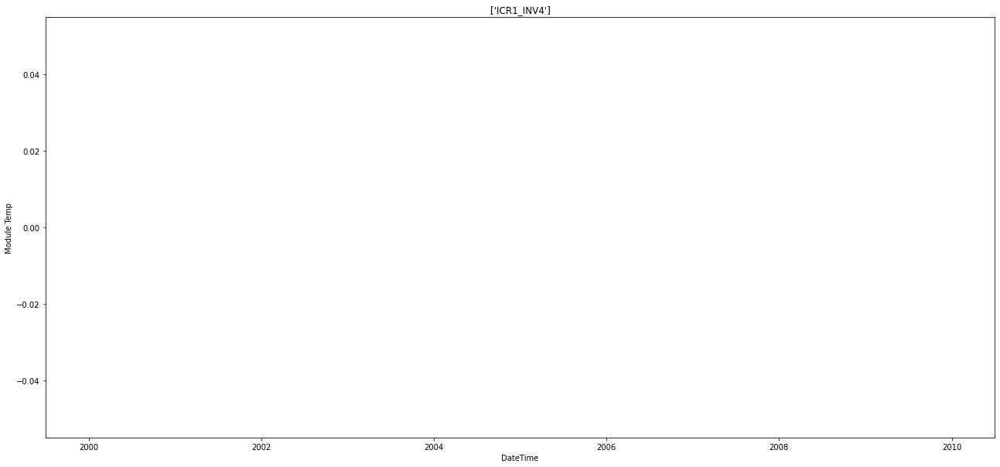

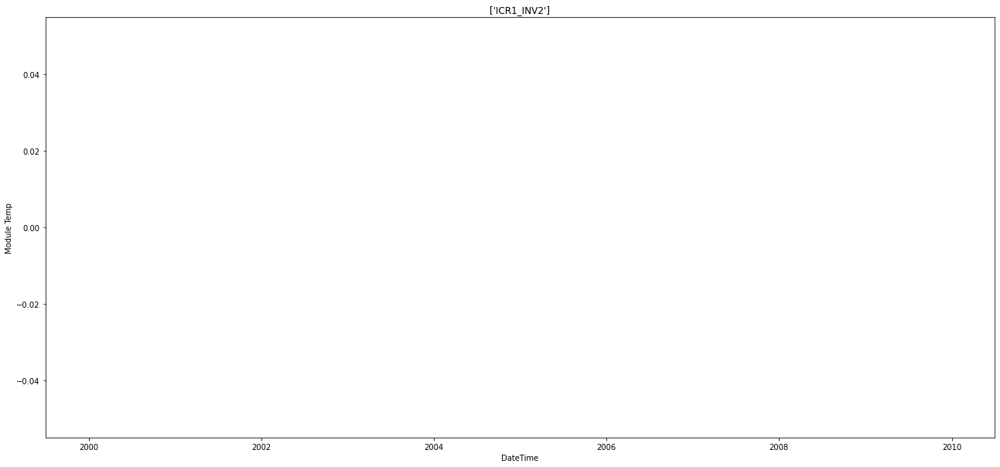

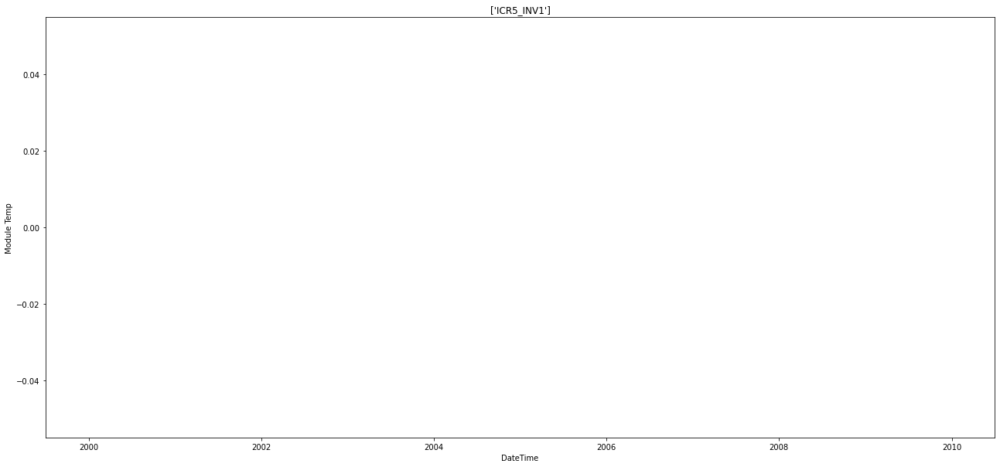

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['Module Temp'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('Module Temp')
  plt.show()

# Conclusion: Module Temp vs DateTime for different AssetNames

This shows that we have Module temp available only for AssetName 'WMS'. For other values it's NaN. We'll have to take a look at other temp to come to a final conclusion. 

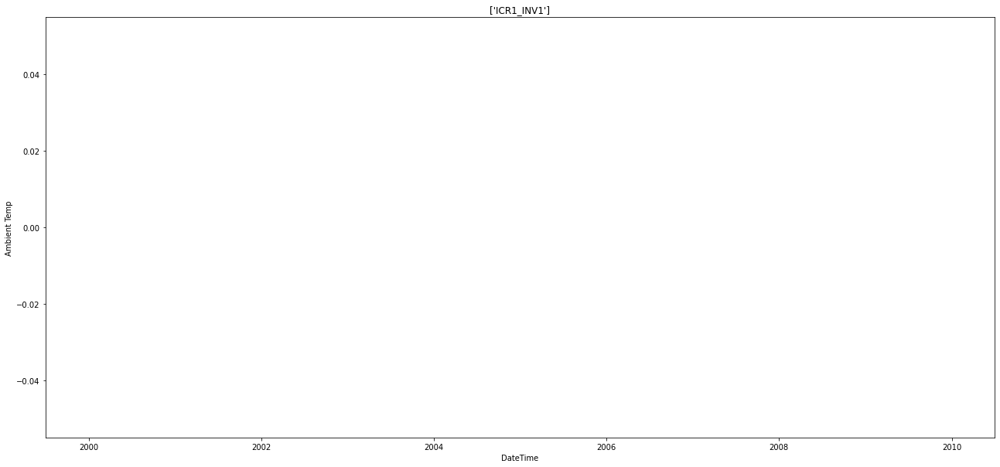

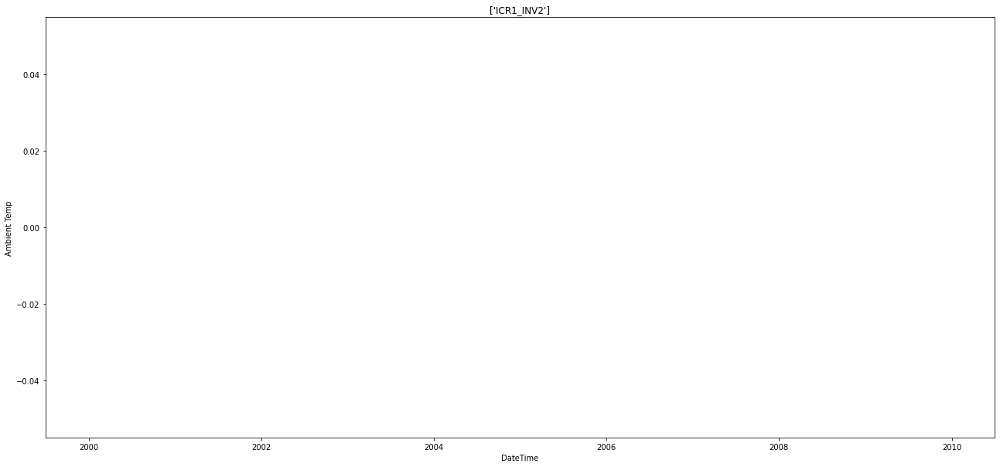

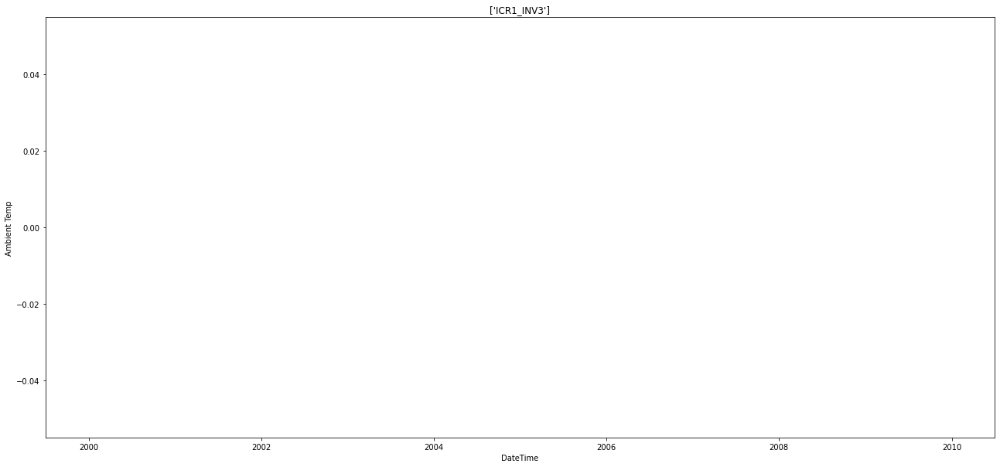

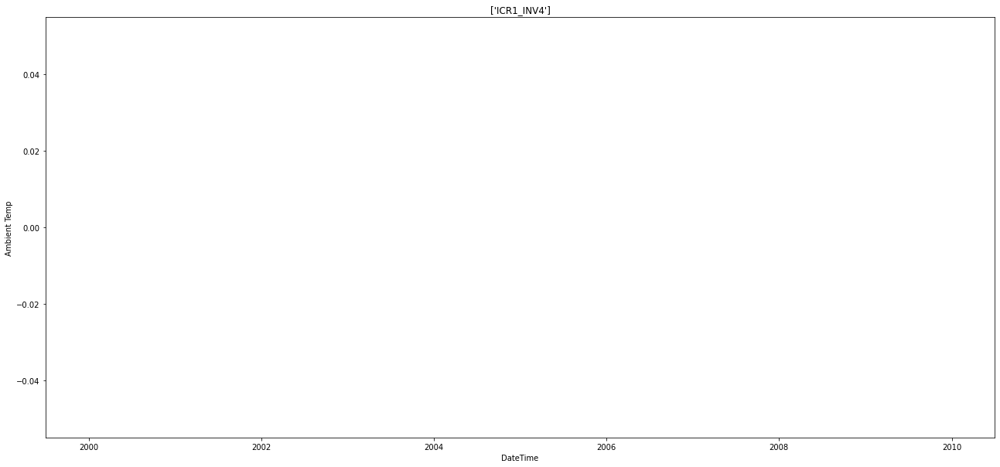

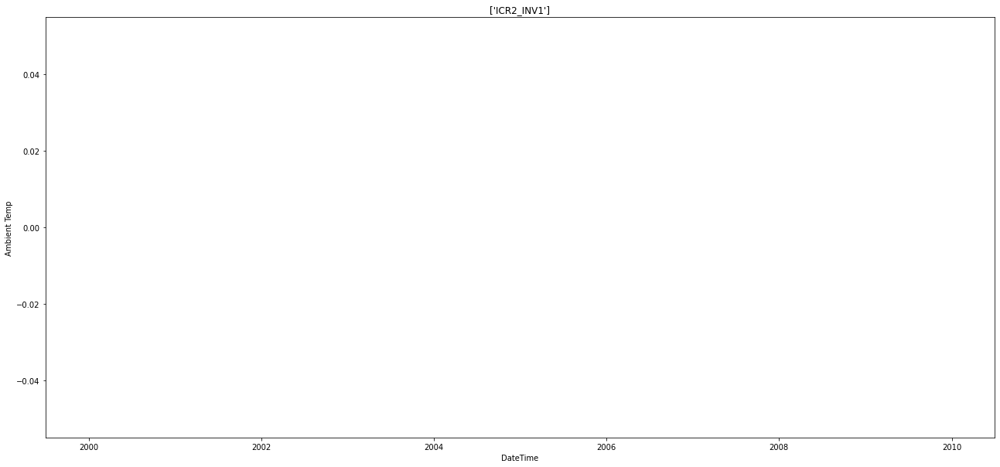

...

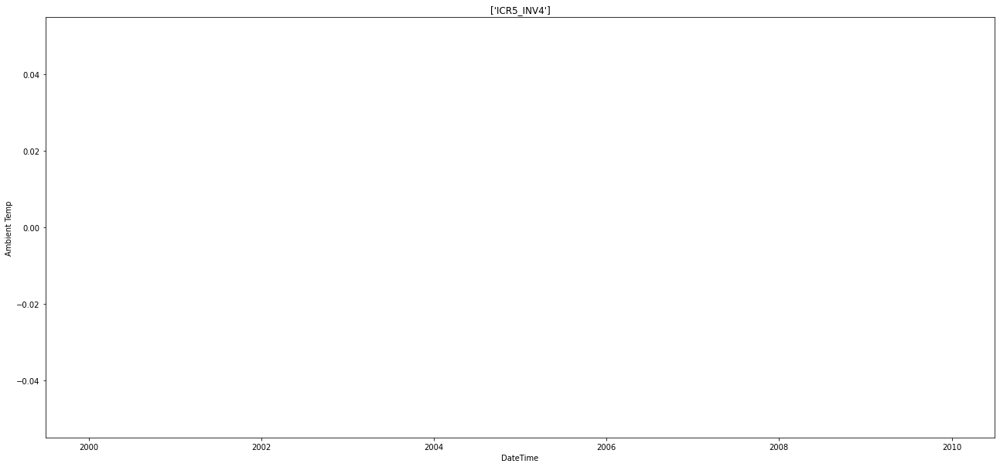

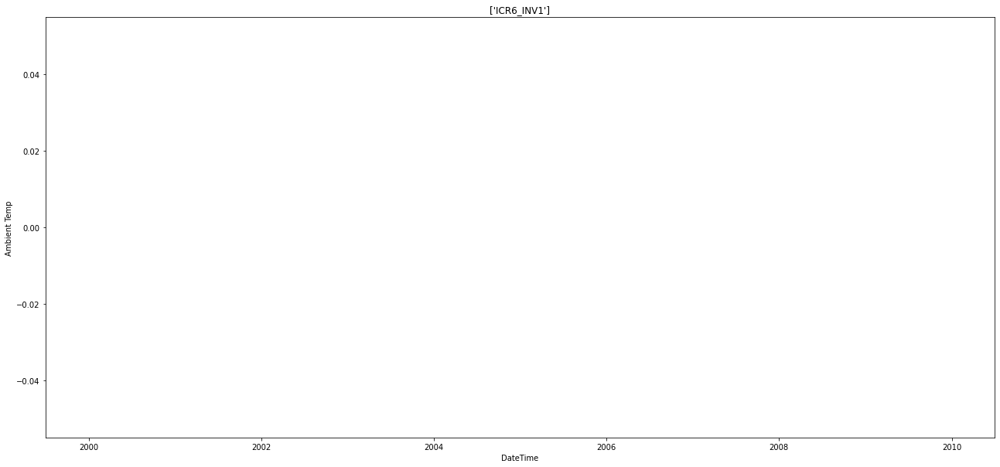

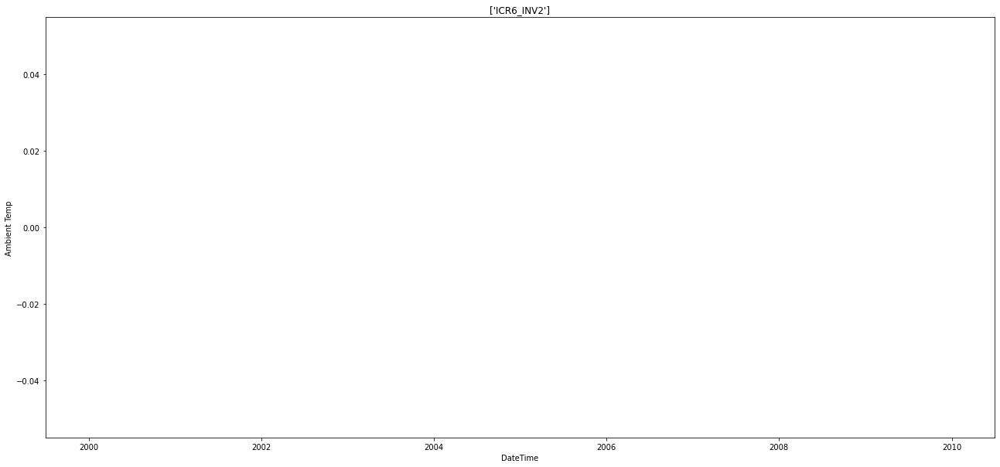

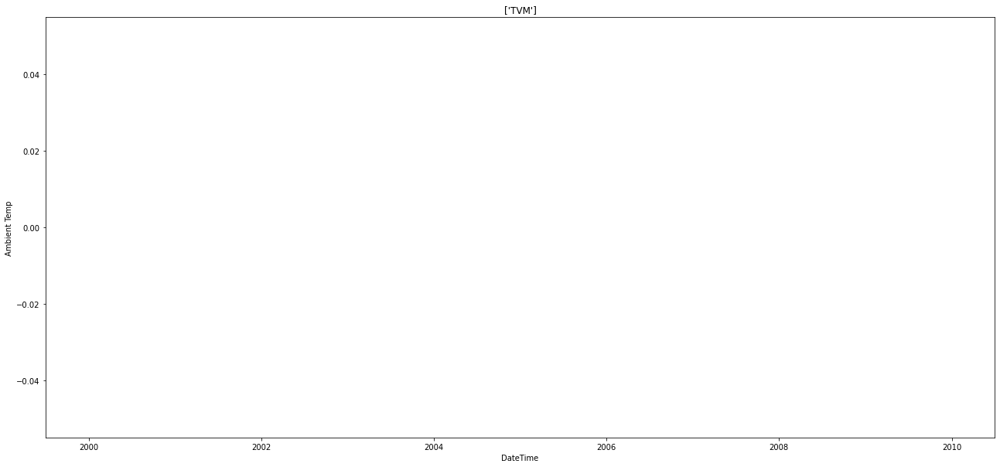

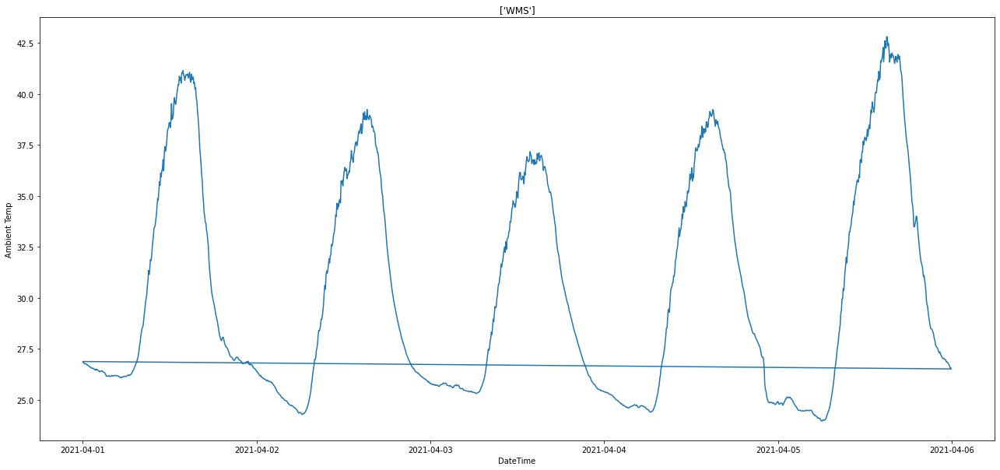

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['Ambient Temp'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('Ambient Temp')
  plt.show()


# Conclusion : DateTime vs Ambient Temp for various AssetNames

It also only varies with WMS and hence WMS becomes important part for analysis. It also shows us a very important result. All the 22 INC_INV values somewhat have the same value over datetime, hence AssetName might be the name for all different sensors of a machine each measuring different values, for example, INC_INV values measure electrical parameters such as power and current while WMS measures temperature.

#**Analysis: DateTime vs GHI and GTI for different AssetNames**

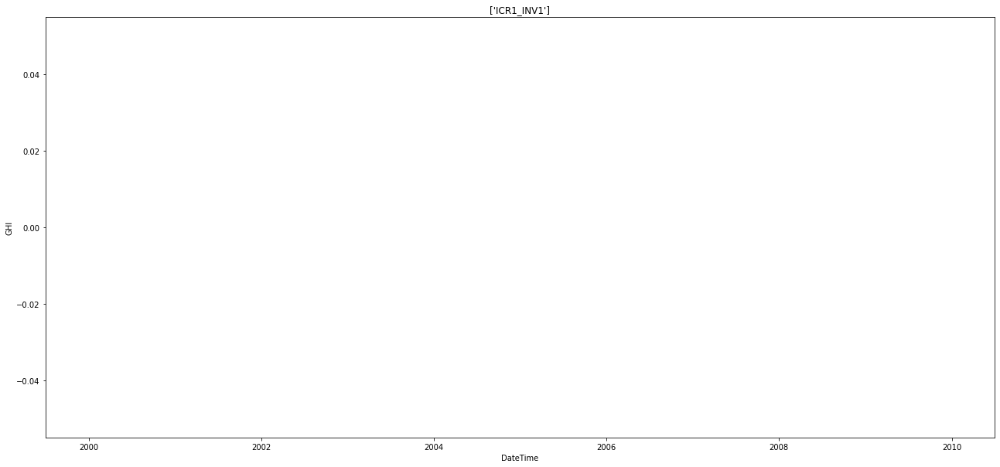

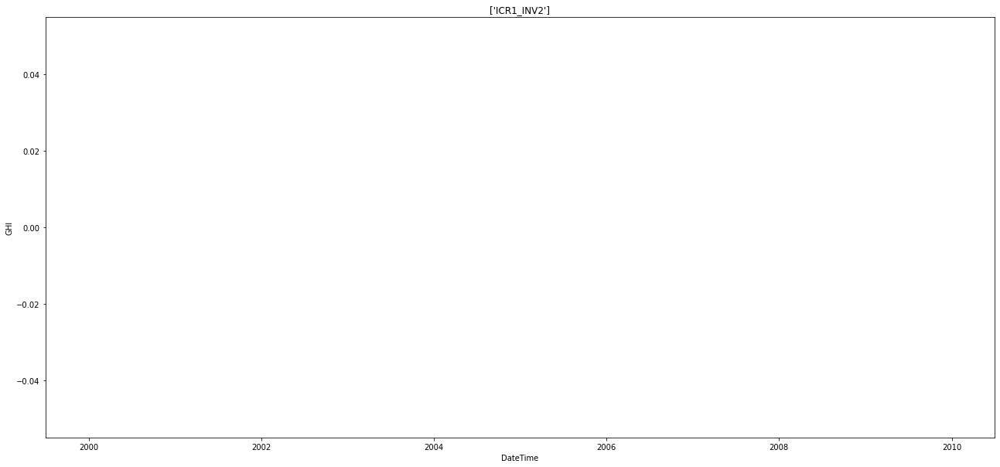

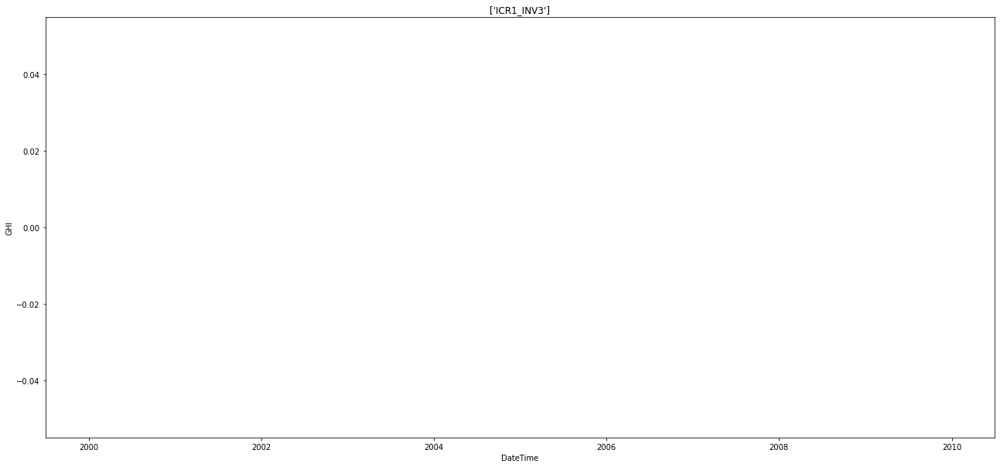

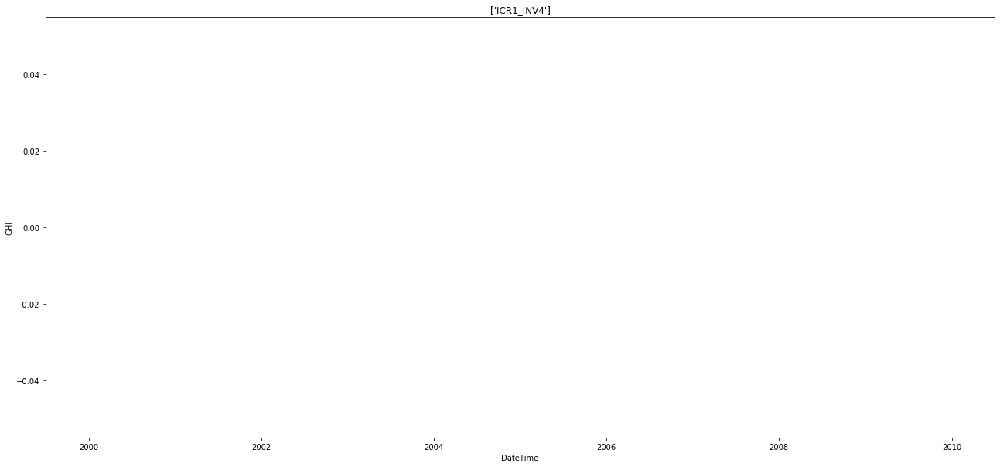

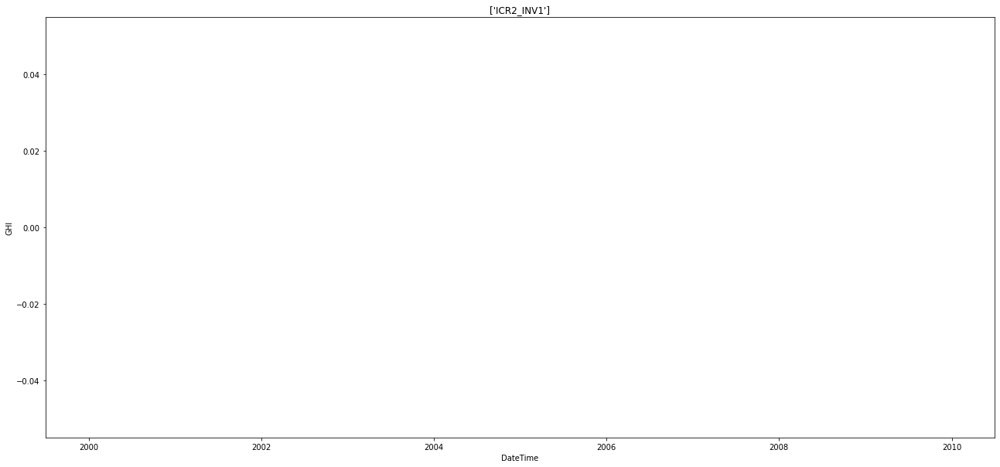

...

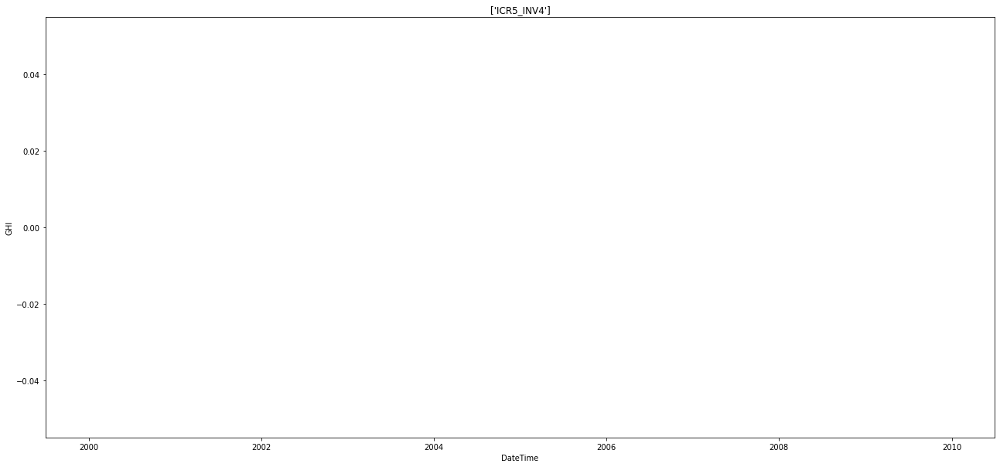

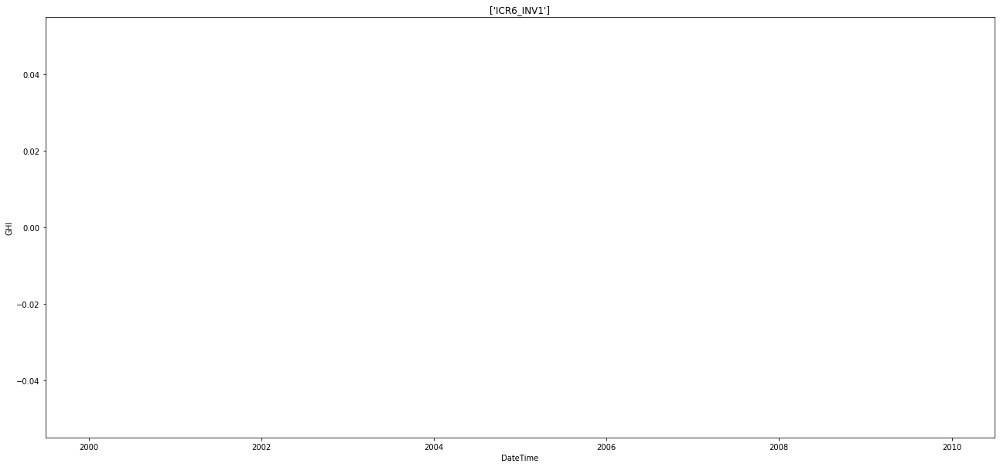

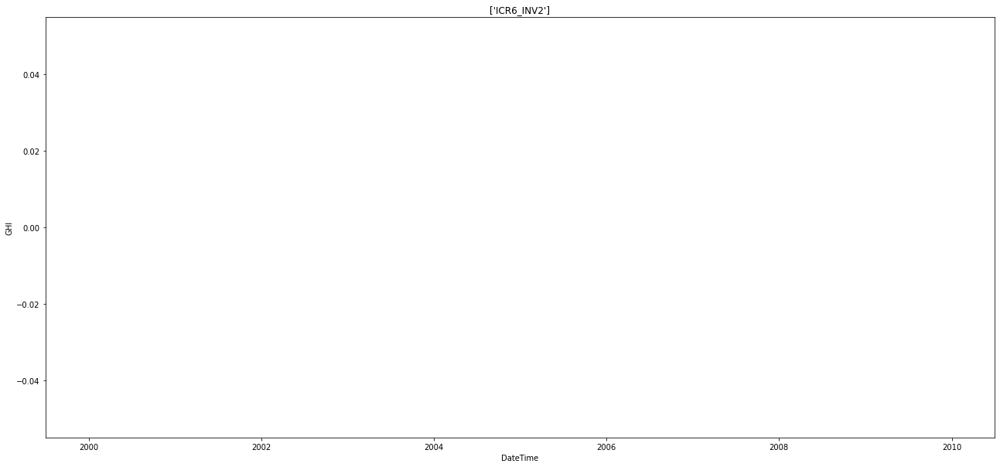

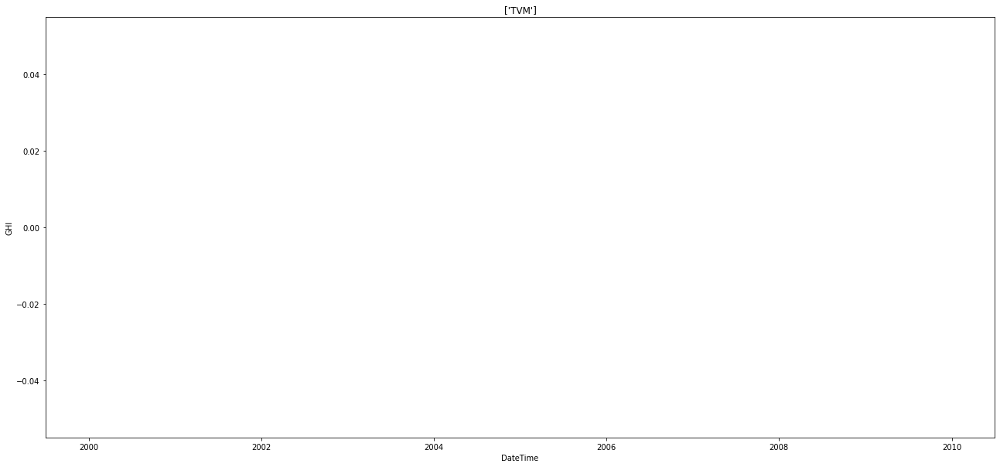

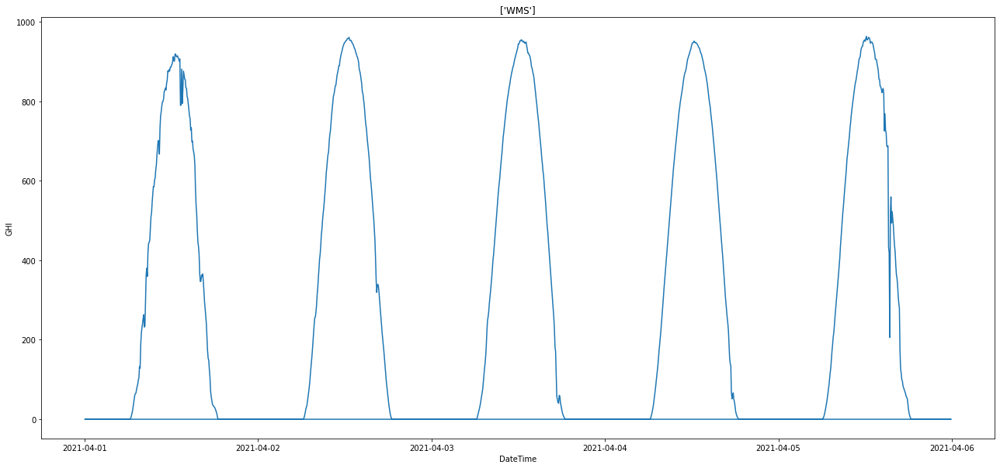

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['GHI'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('GHI')
  plt.show()

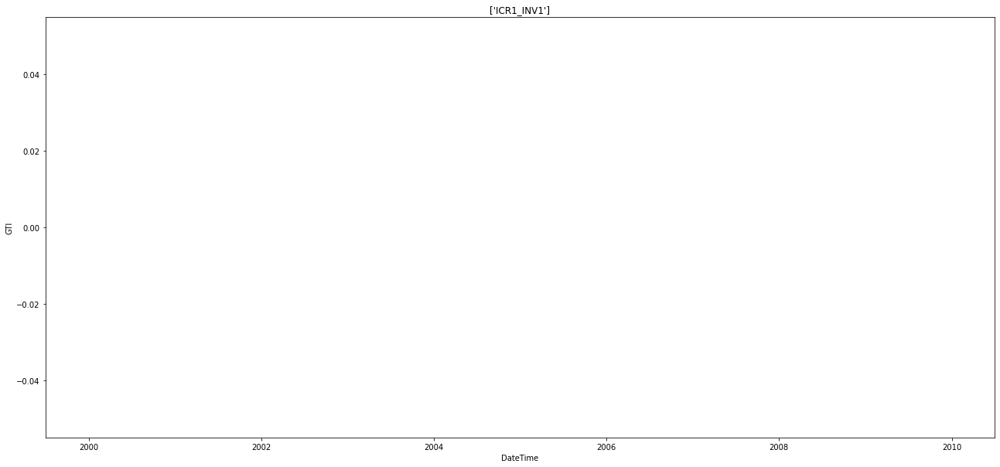

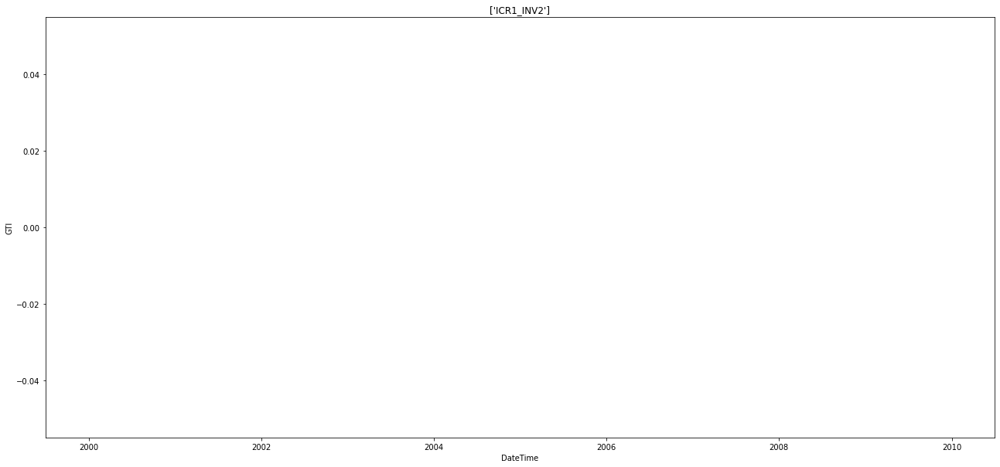

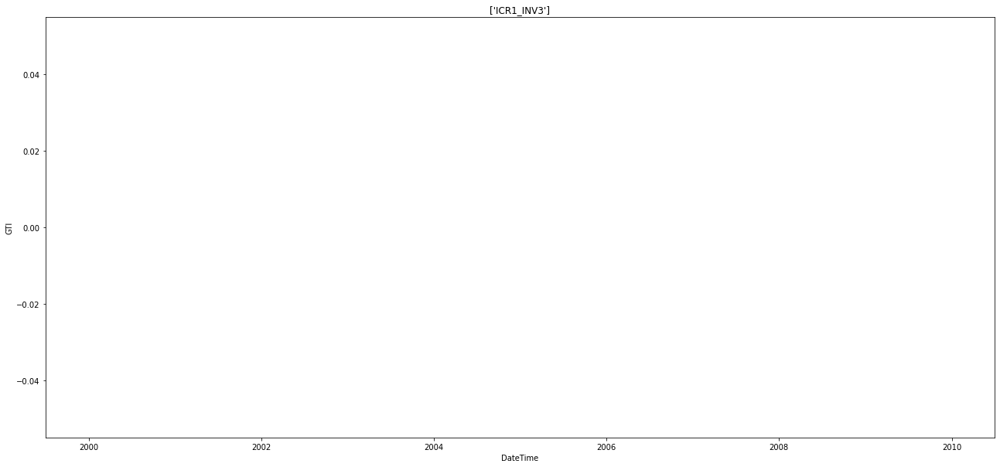

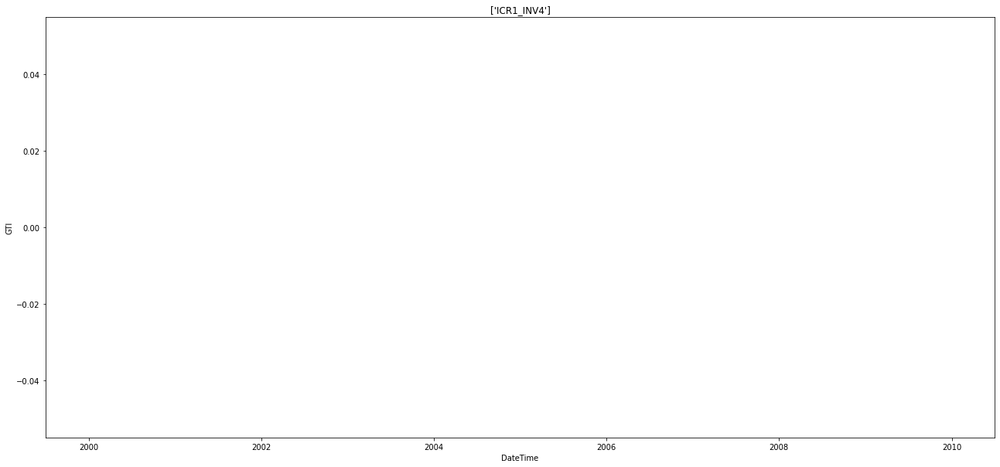

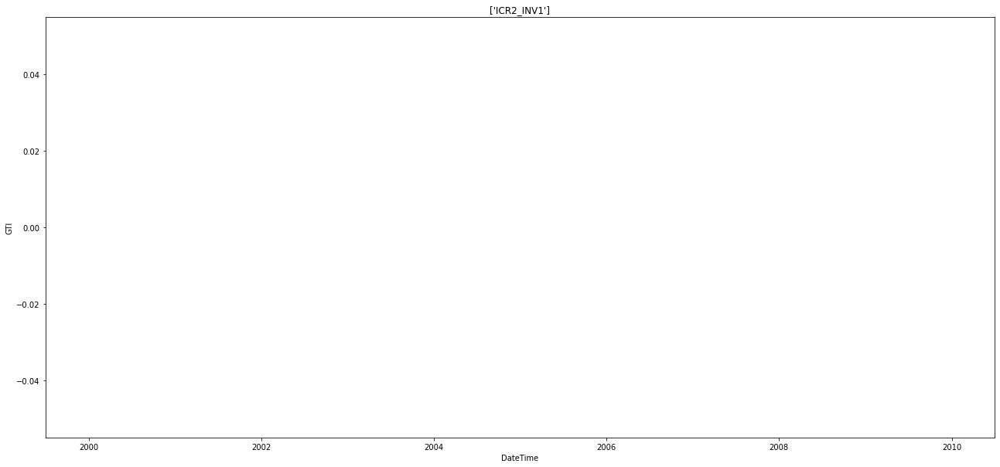

...

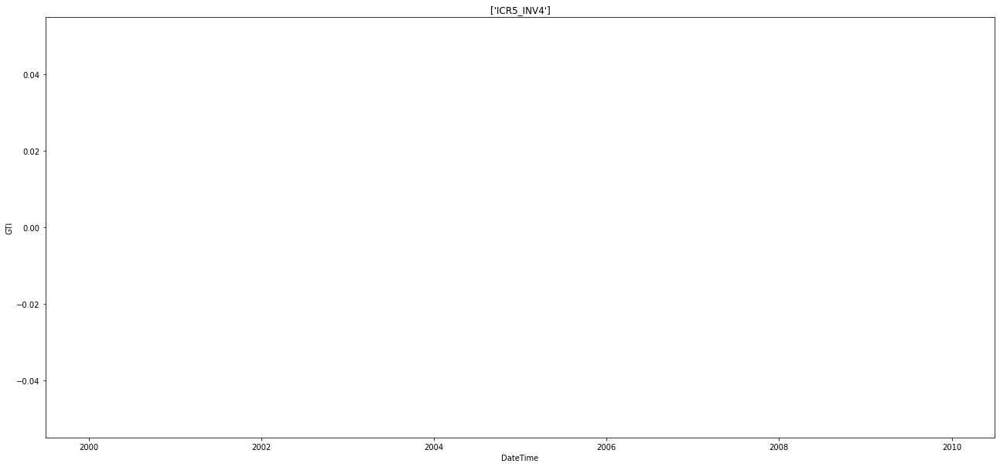

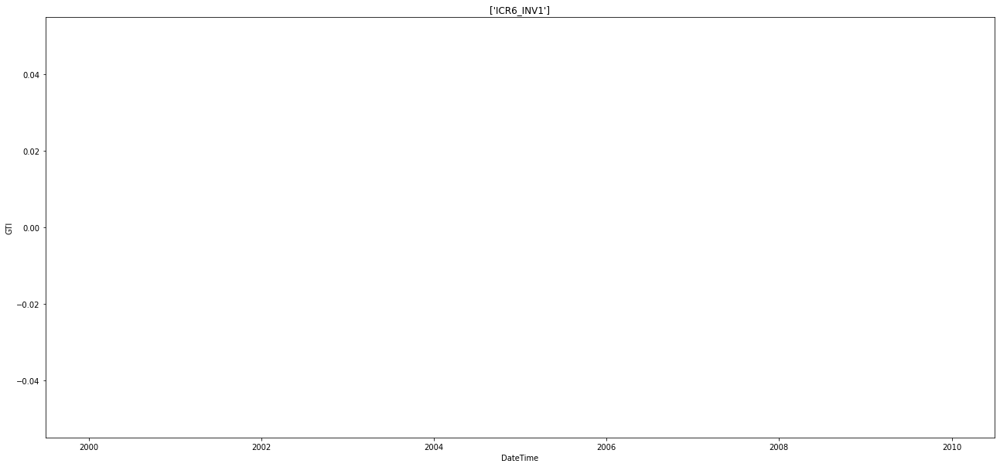

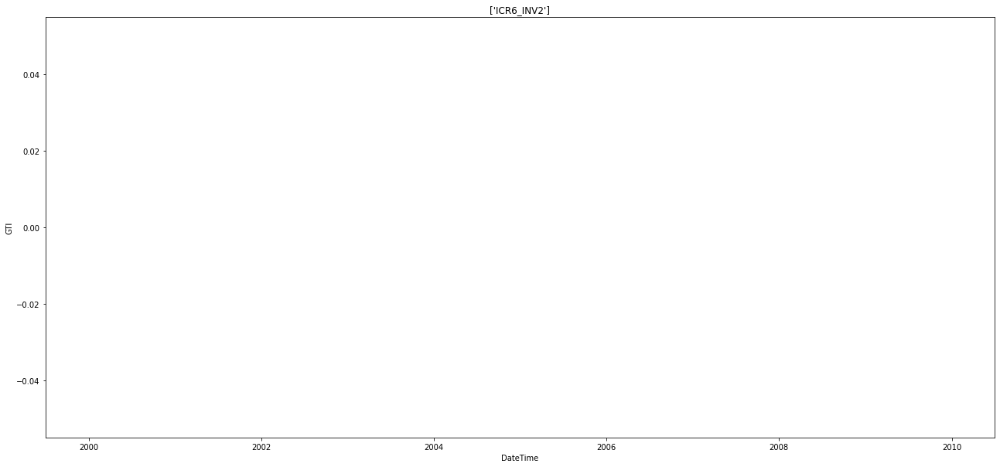

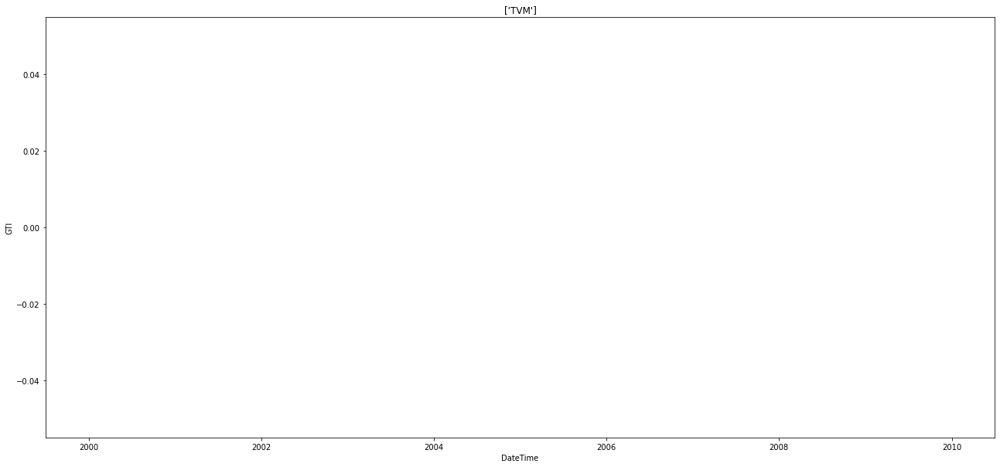

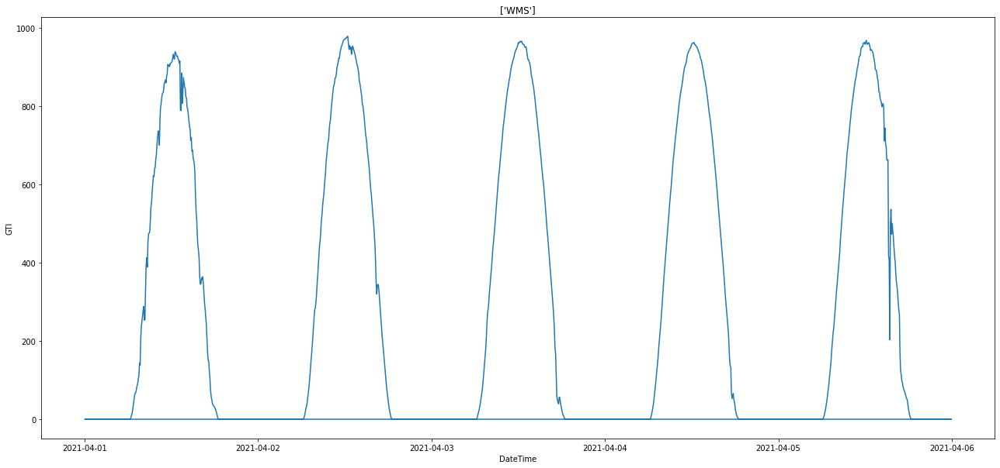

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['GTI'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('GTI')
  plt.show()

# Conclusion: DateTime vs GHI and GTI for different AssetNames

The assetname 'WMS' is the only one which keeps track of this data and hence we'll use it for creating our model.

#**Analysis: DateTime vs AC Current values(one of the three) for different AssetNames**



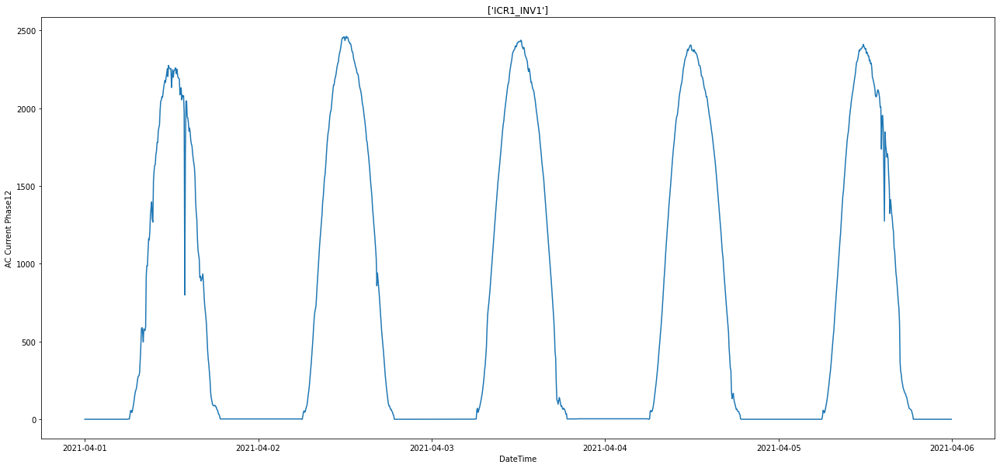

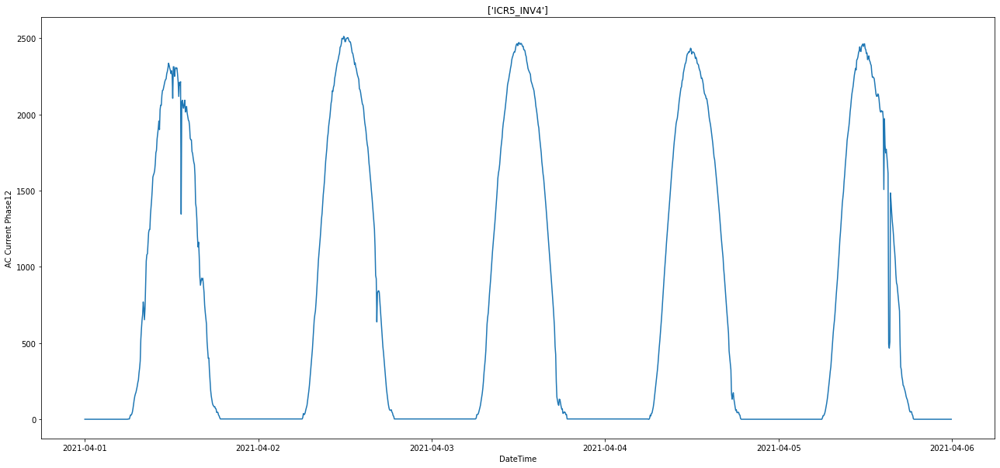

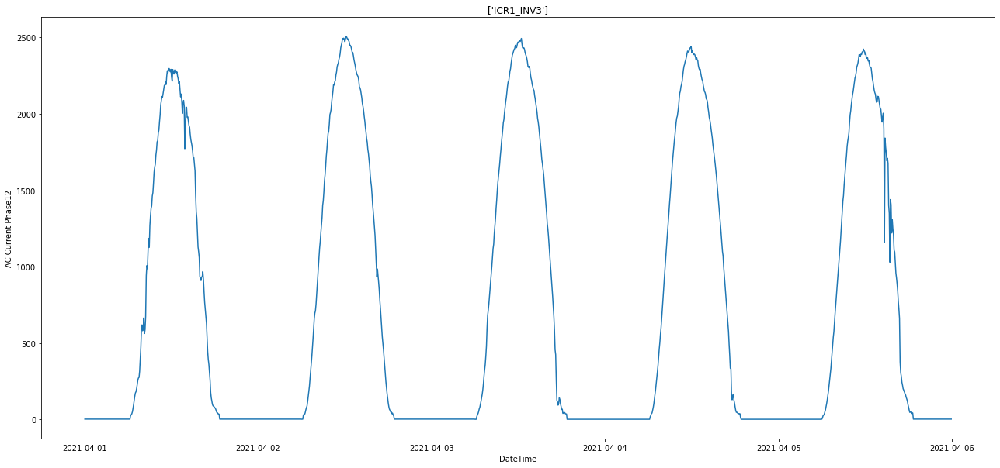

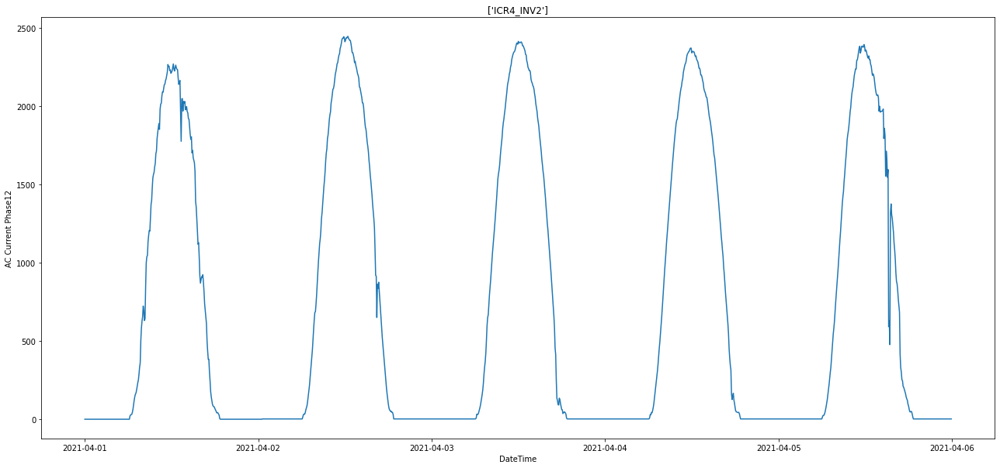

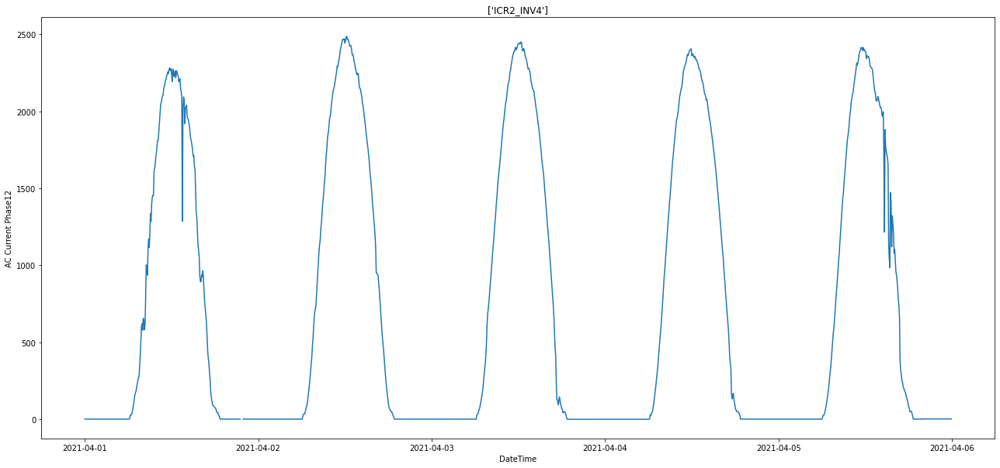

...

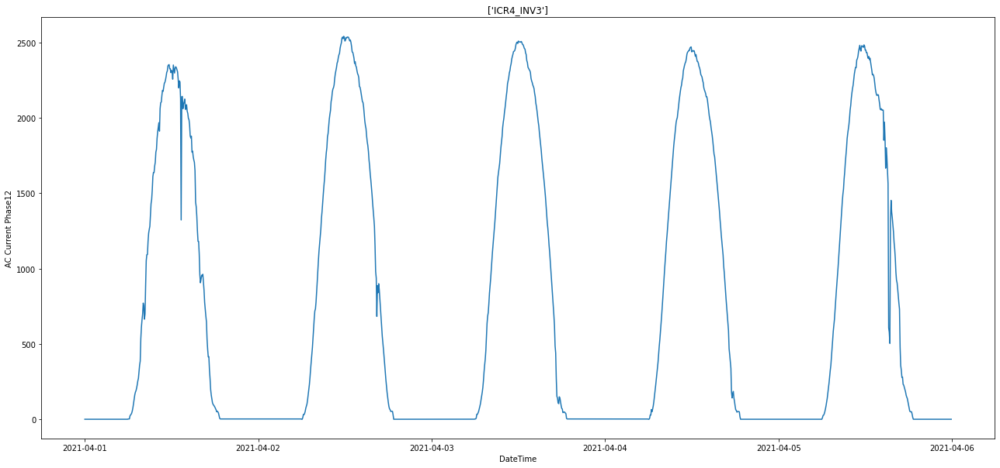

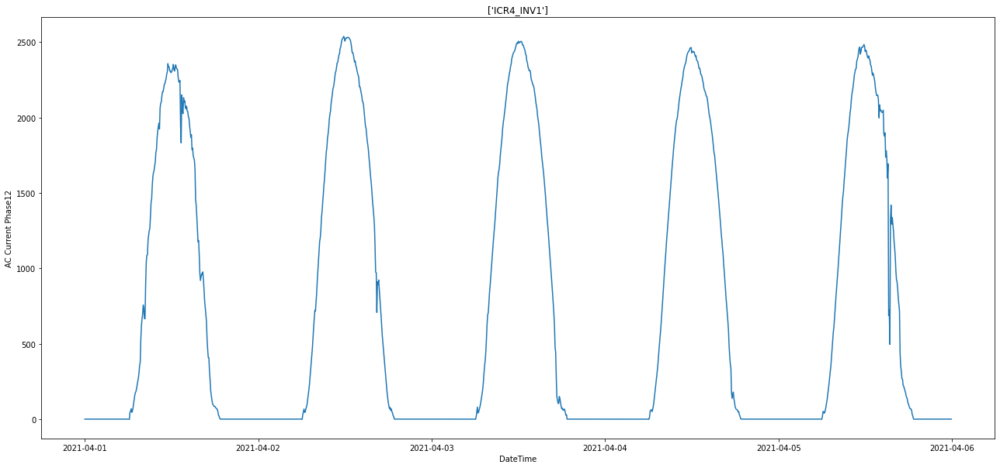

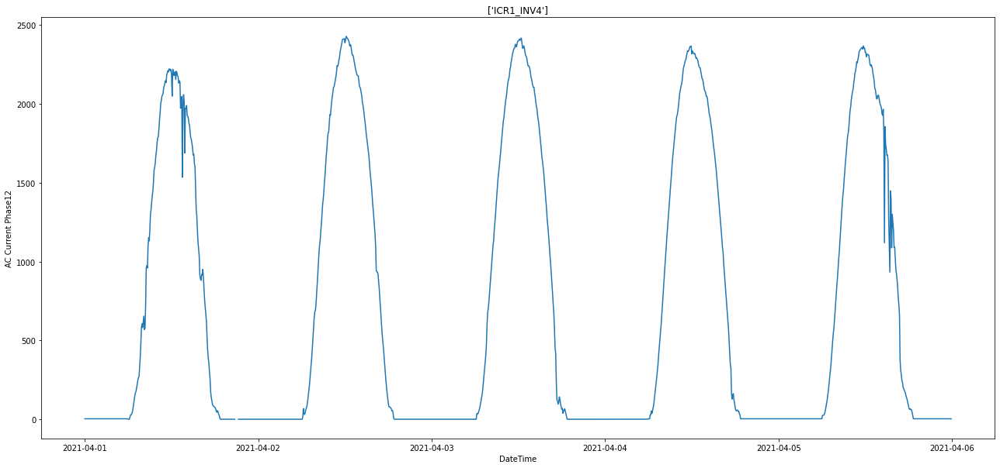

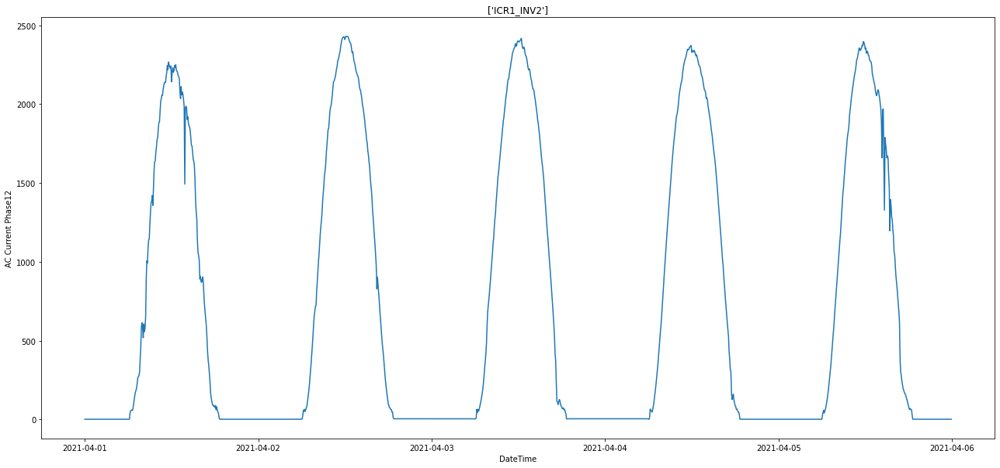

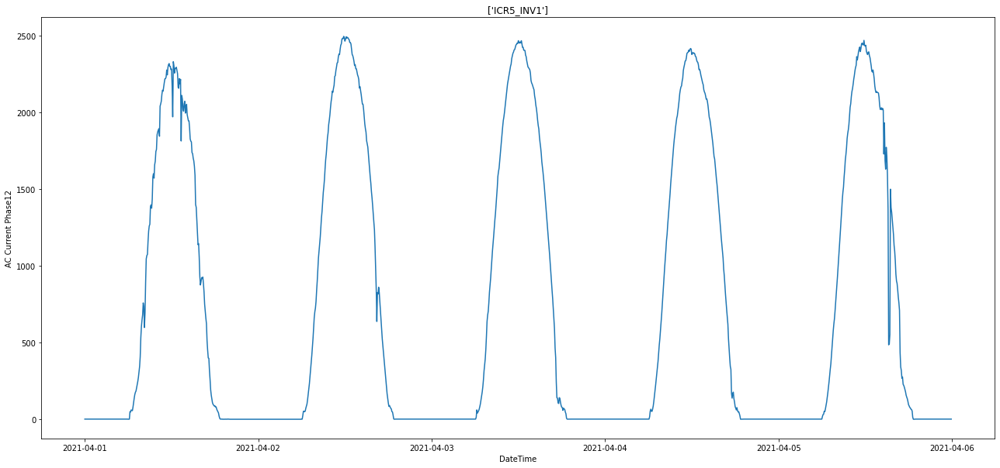

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['AC Current Phase12'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('AC Current Phase12')
  plt.show()

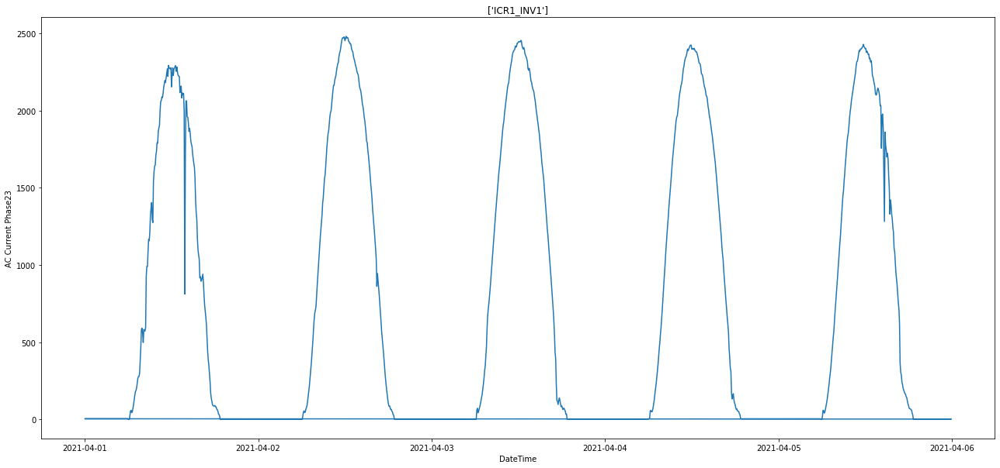

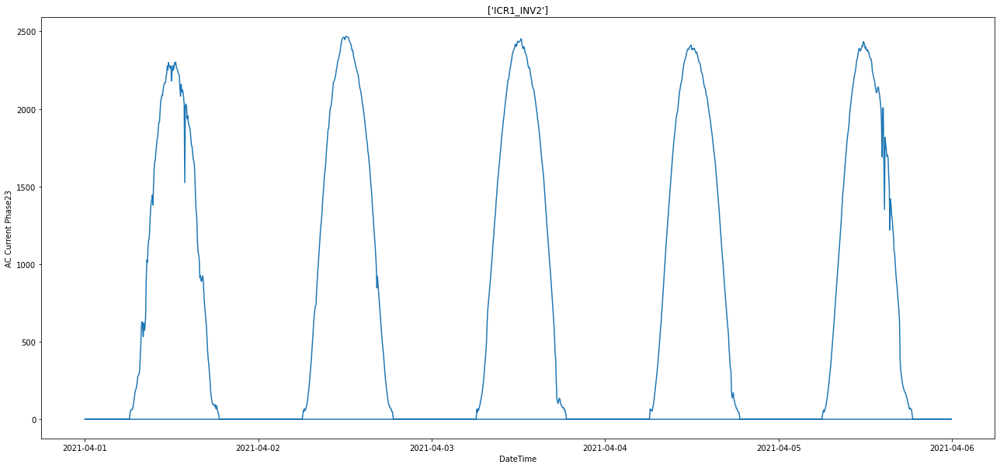

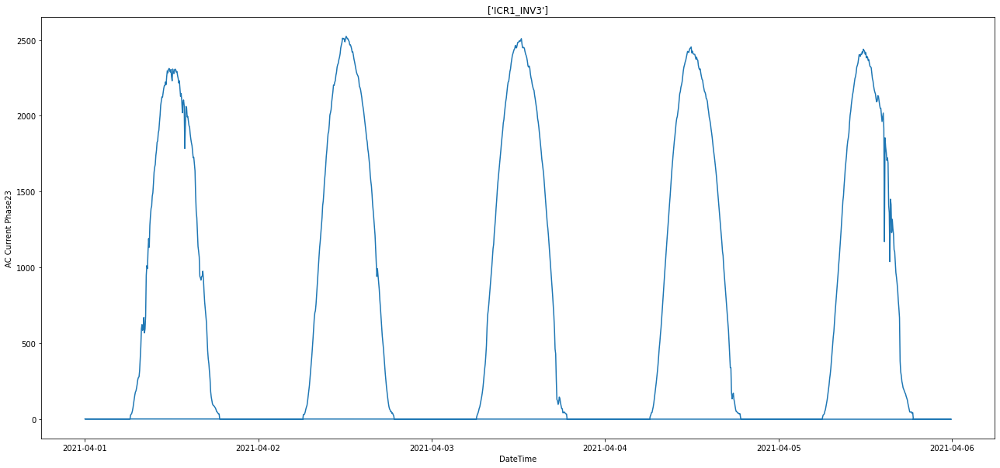

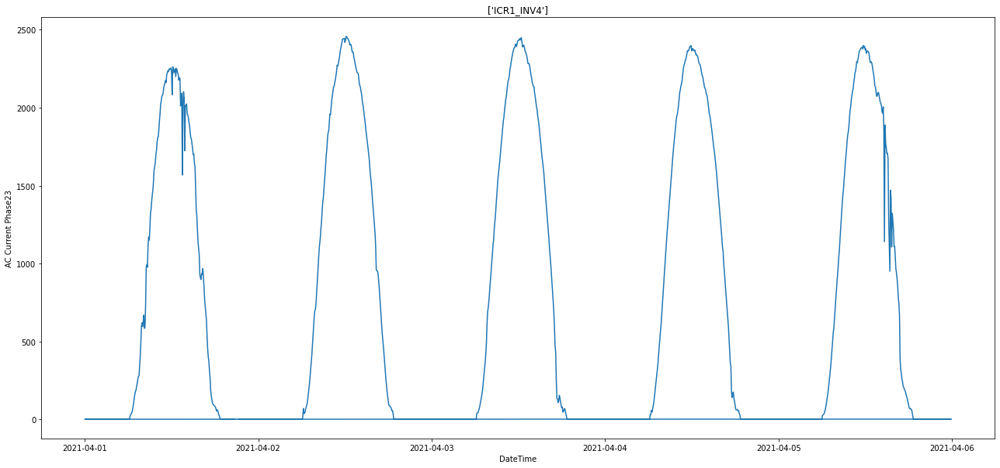

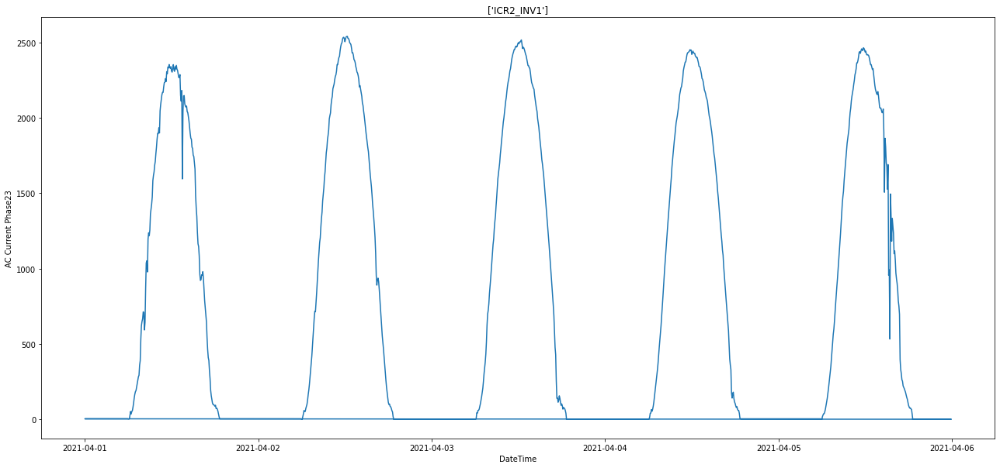

...

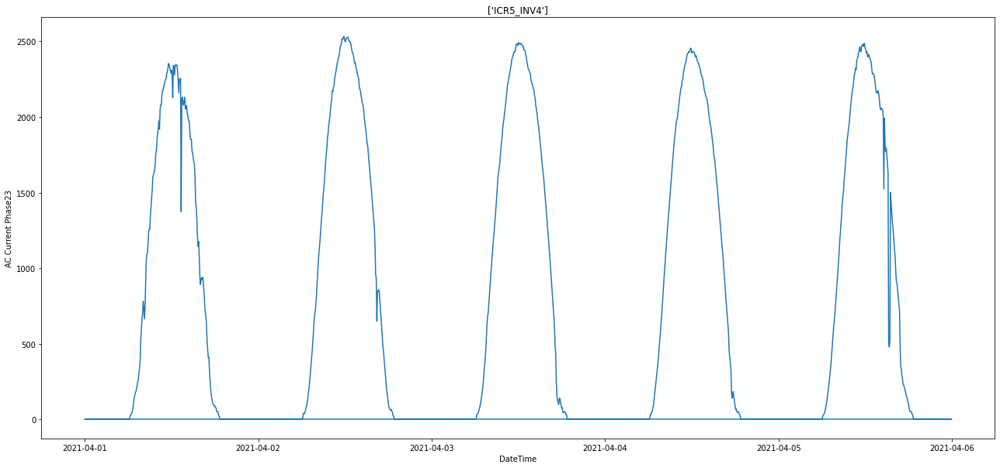

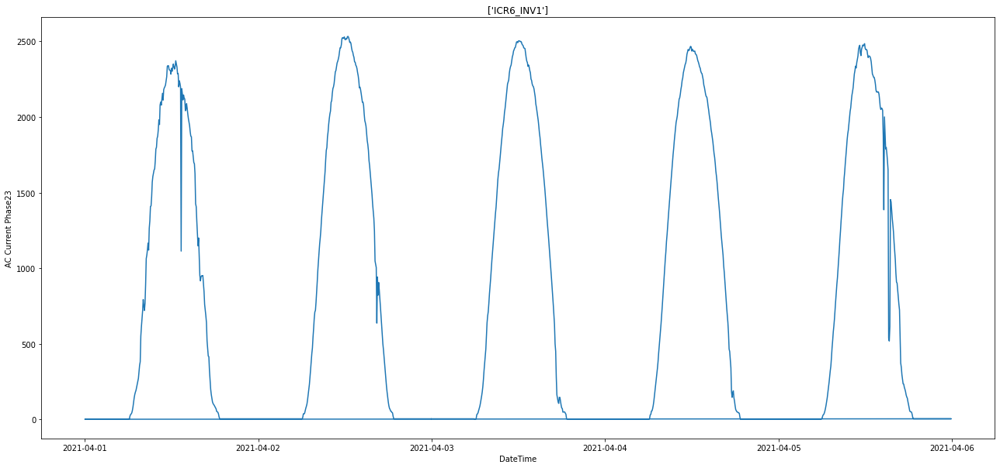

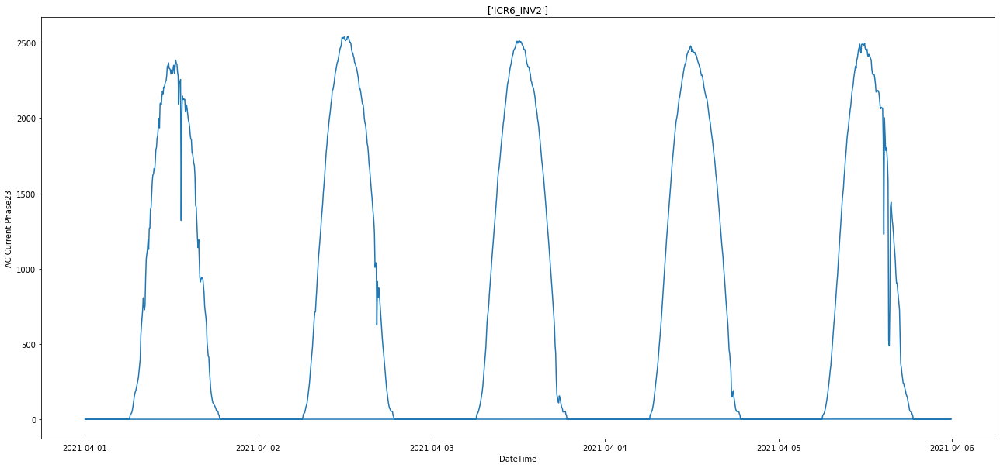

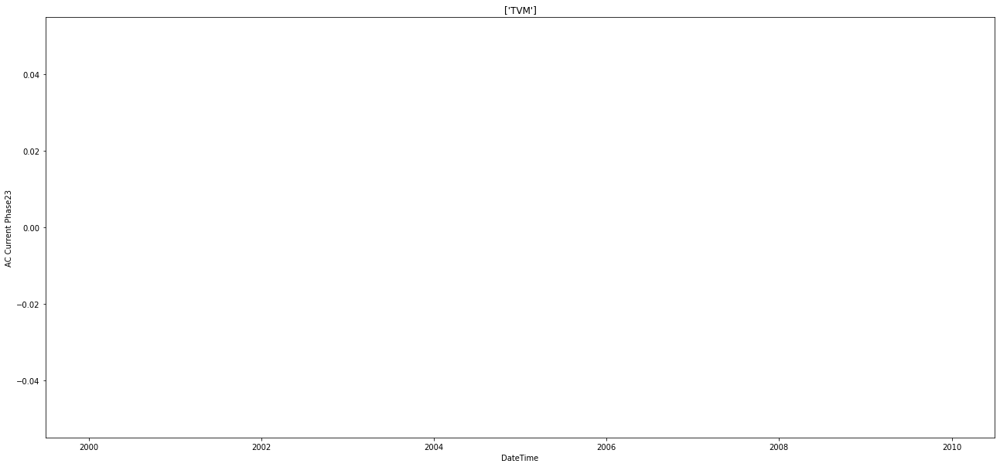

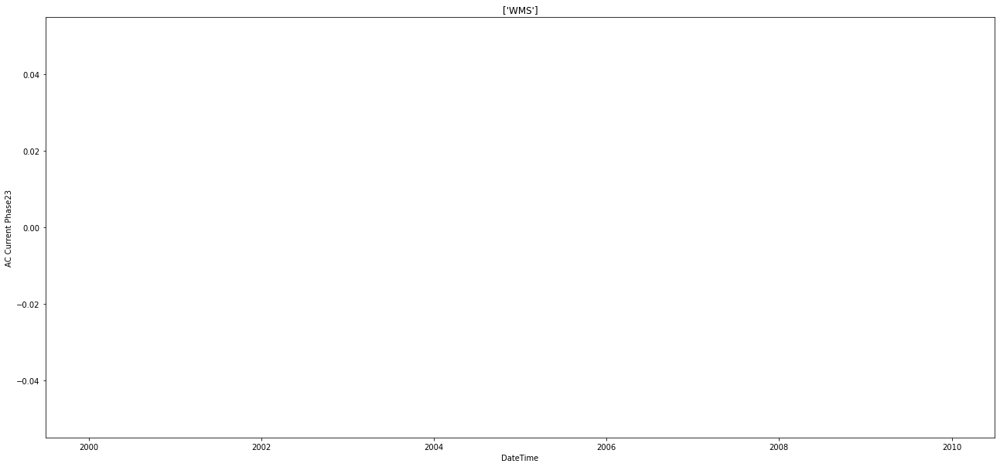

In [ ]:
r asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['AC Current Phase23'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('AC Current Phase23')
  plt.show()

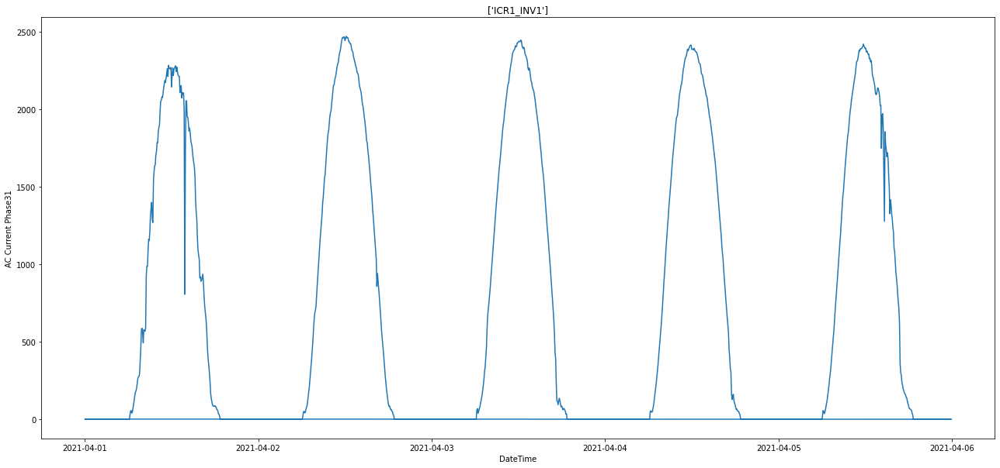

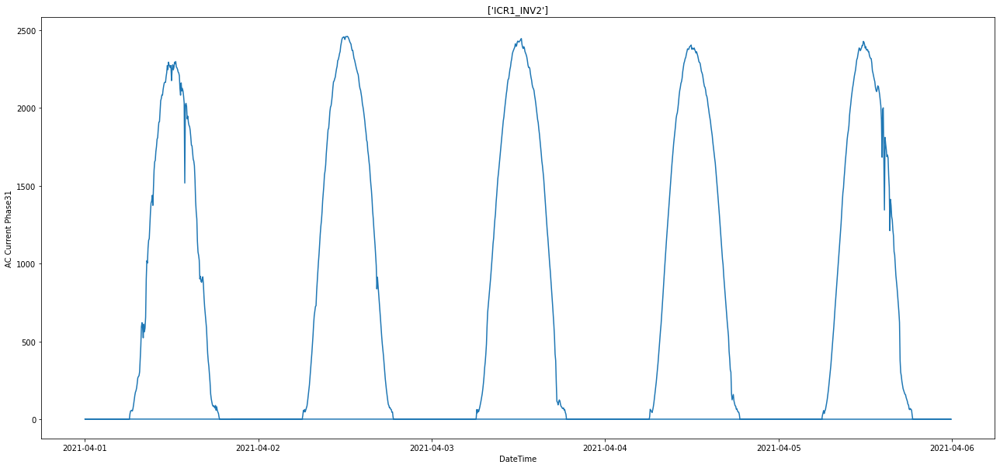

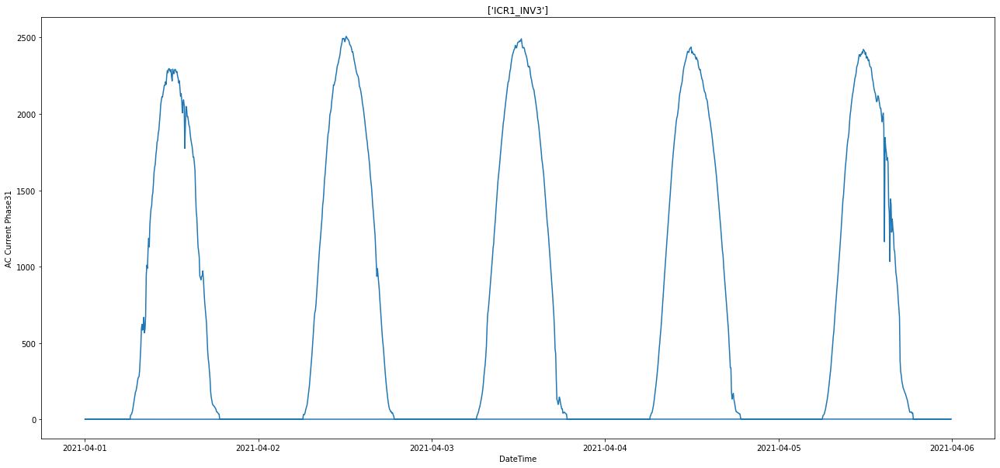

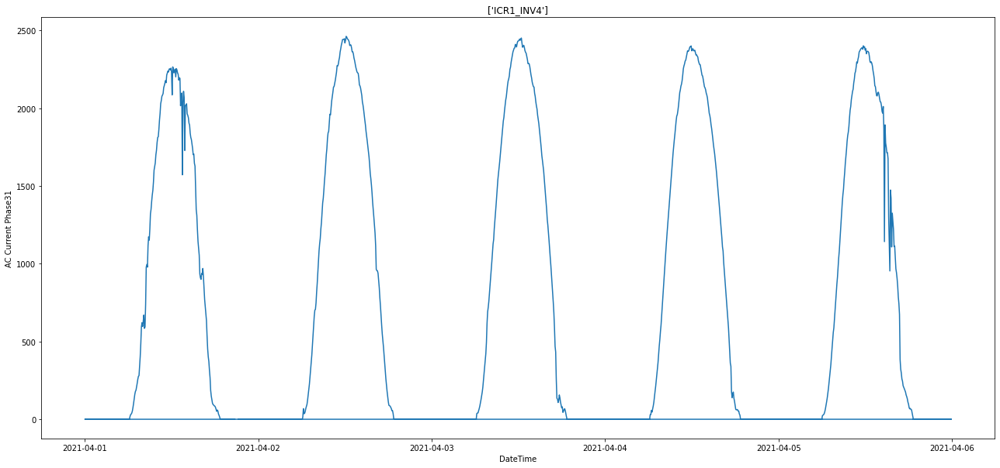

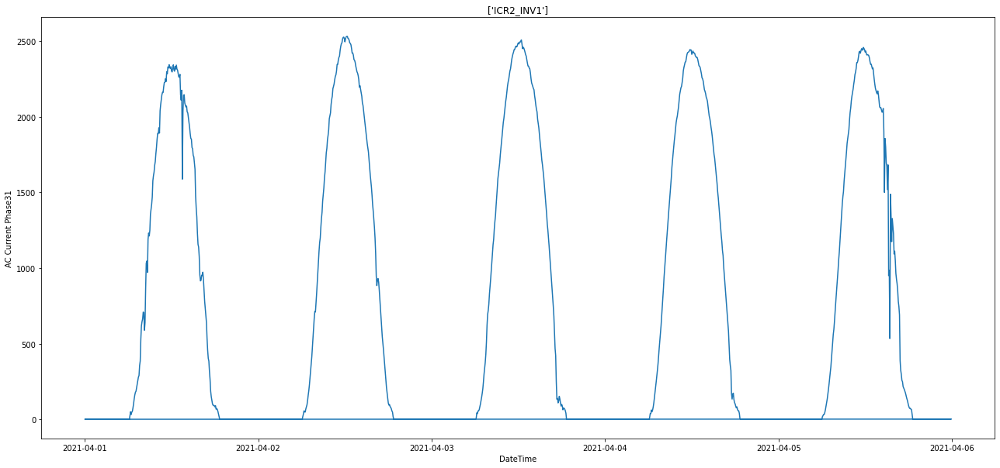

...

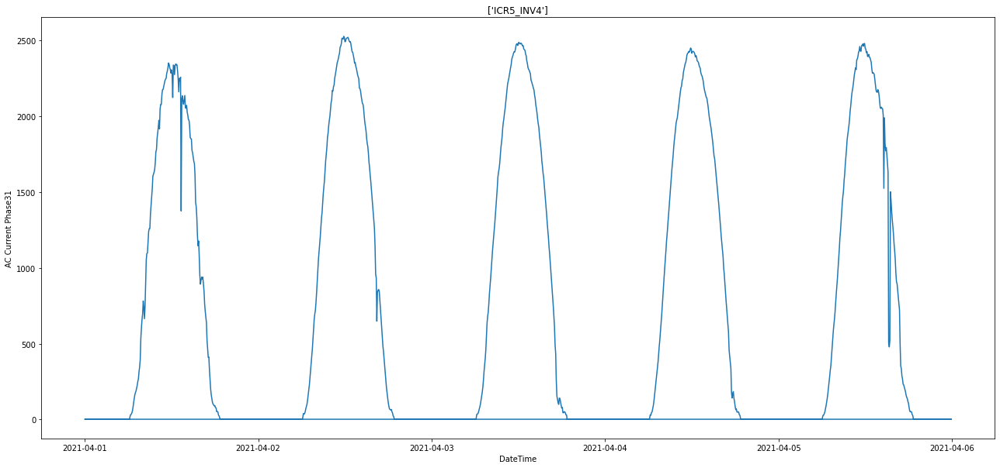

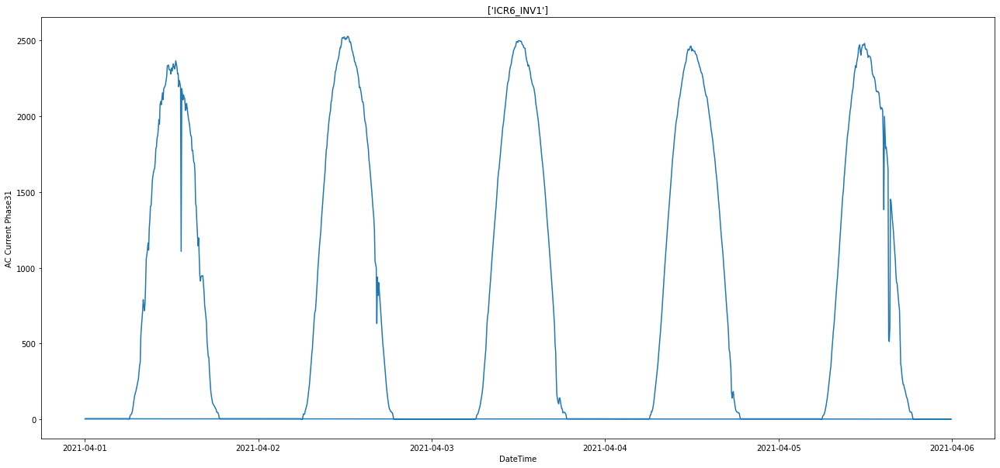

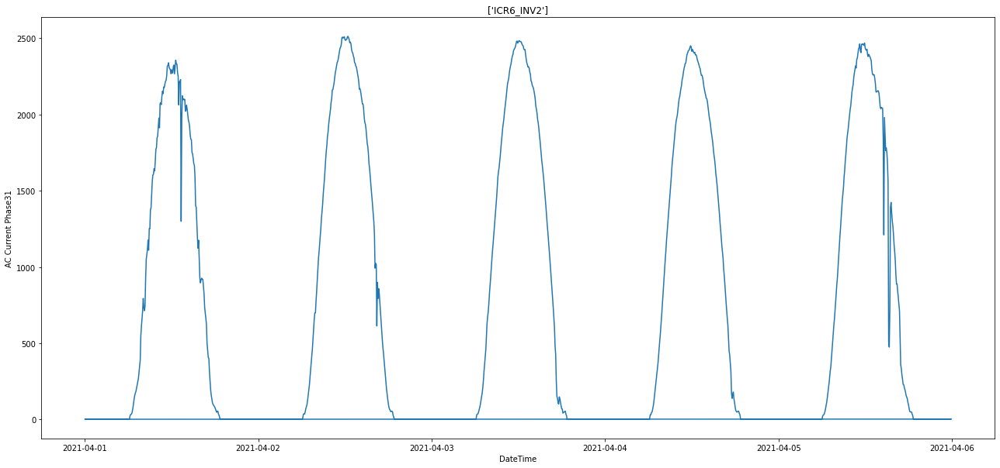

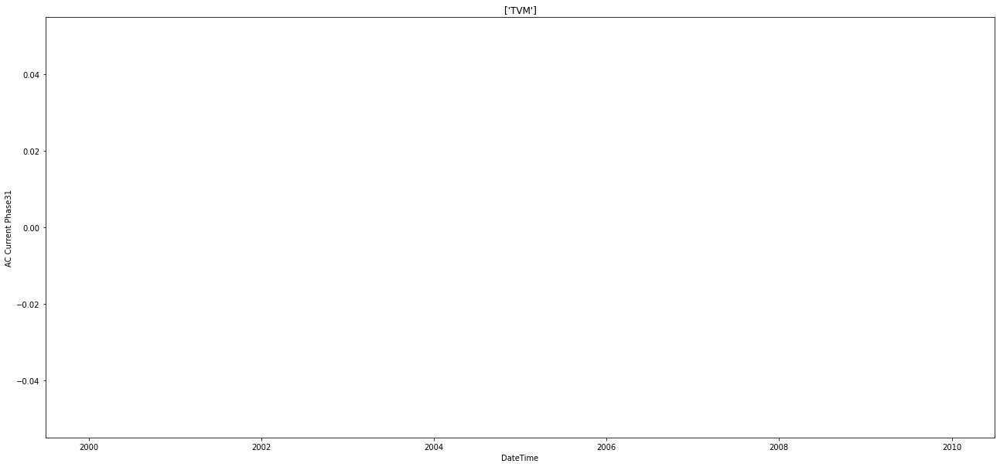

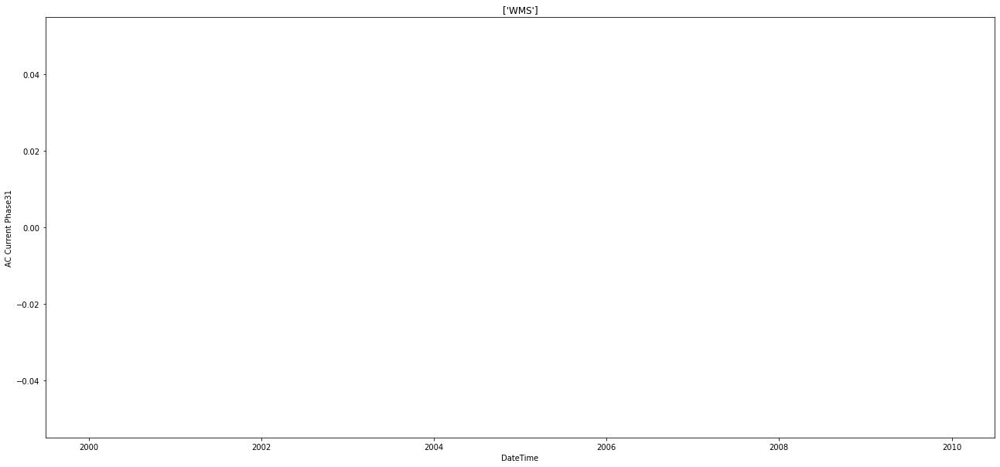

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['AC Current Phase31'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('AC Current Phase31')
  plt.show()

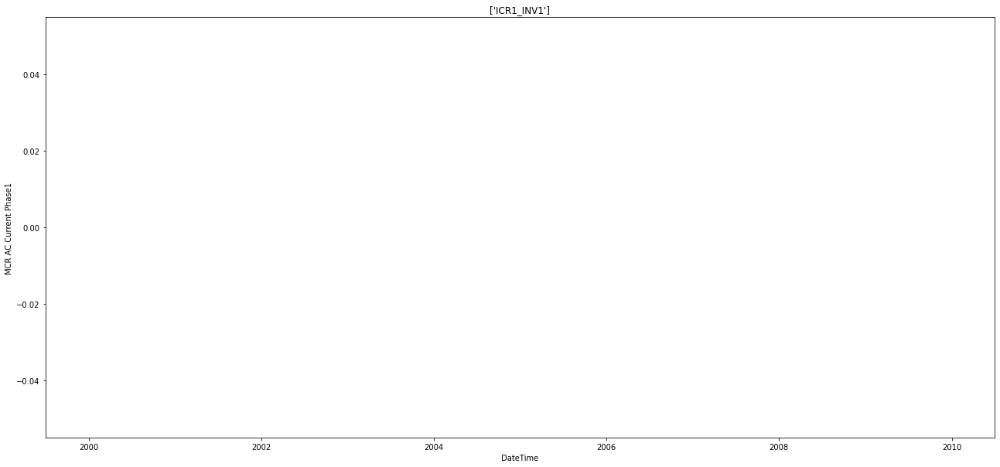

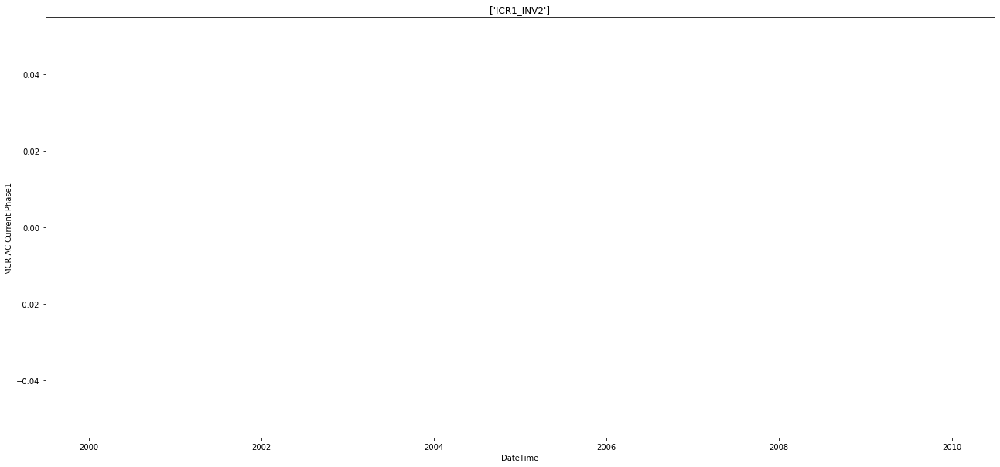

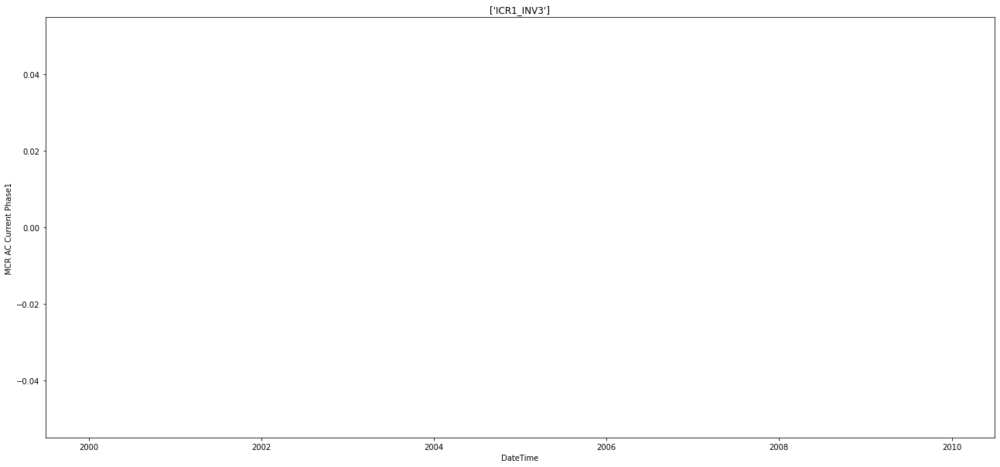

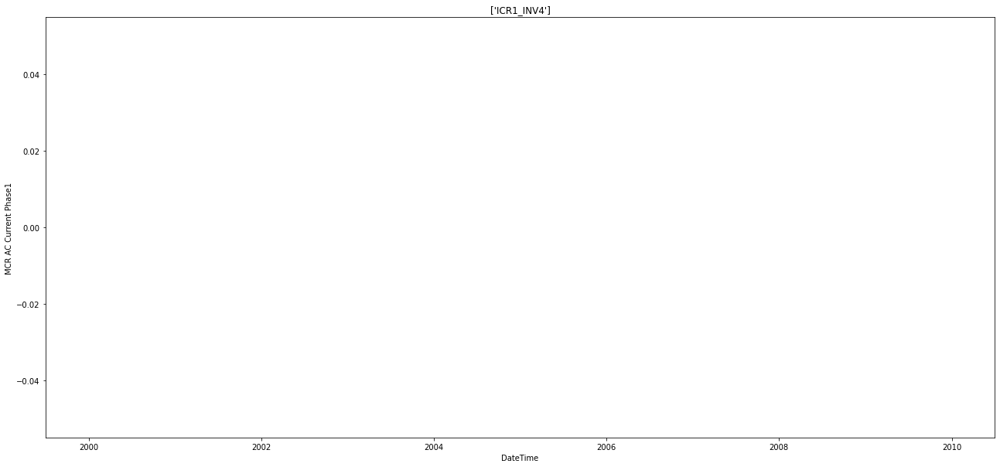

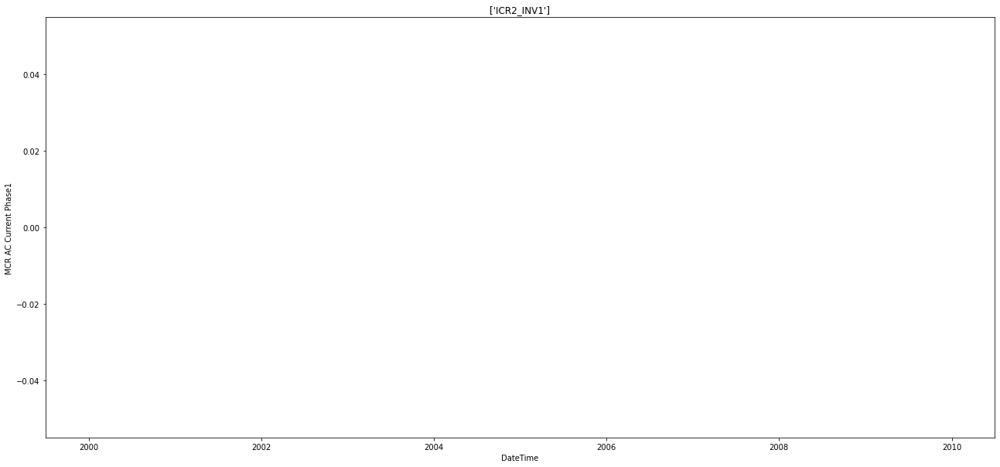

...

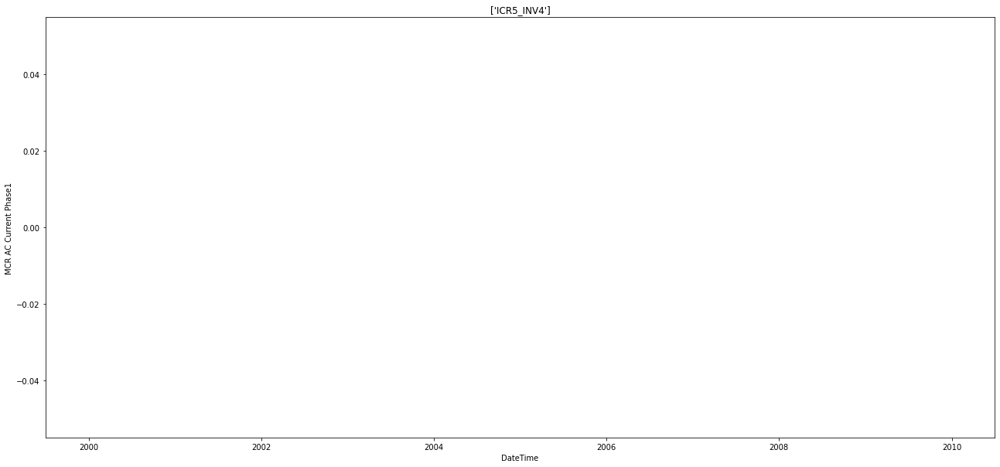

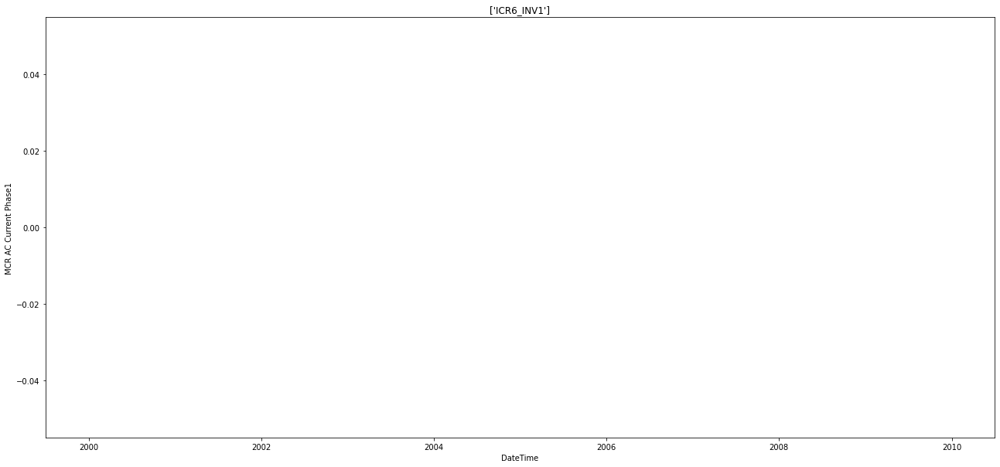

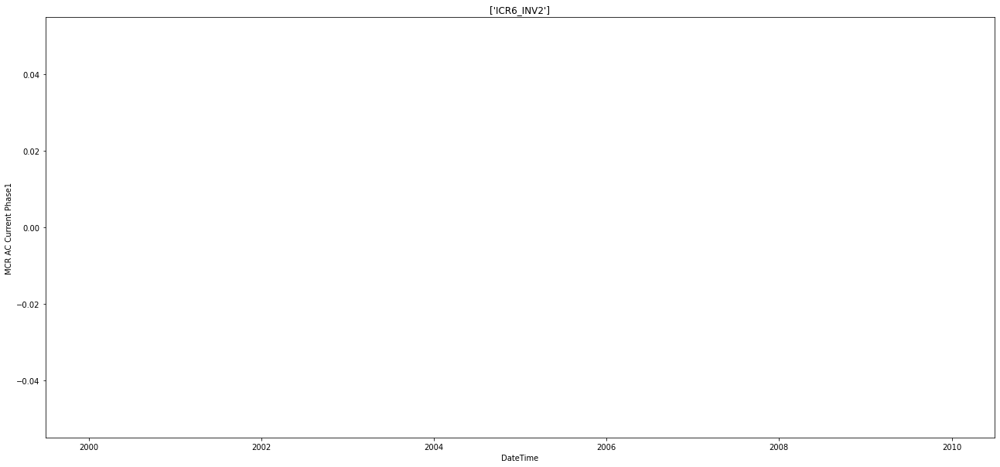

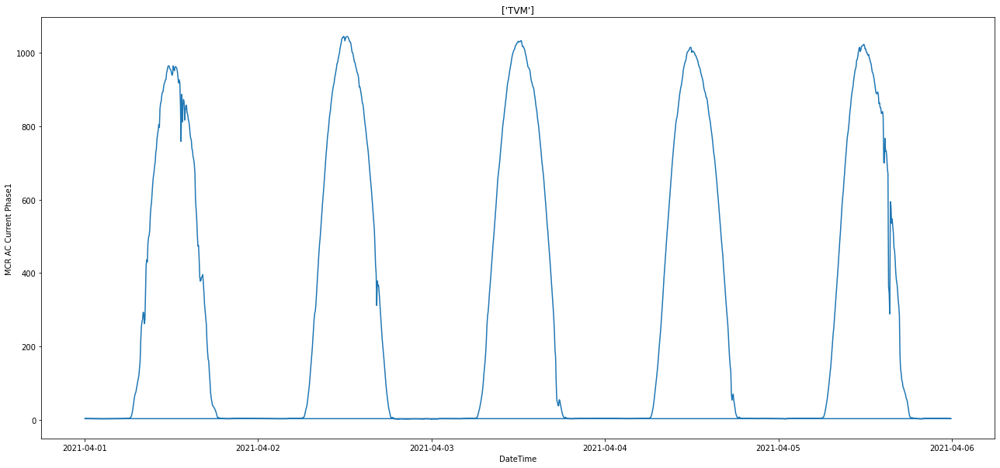

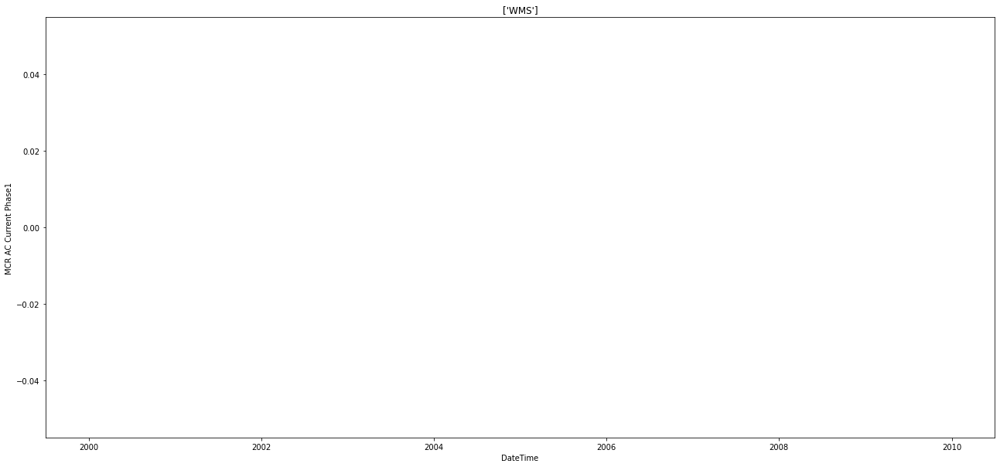

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['MCR AC Current Phase1'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('MCR AC Current Phase1')
  plt.show()

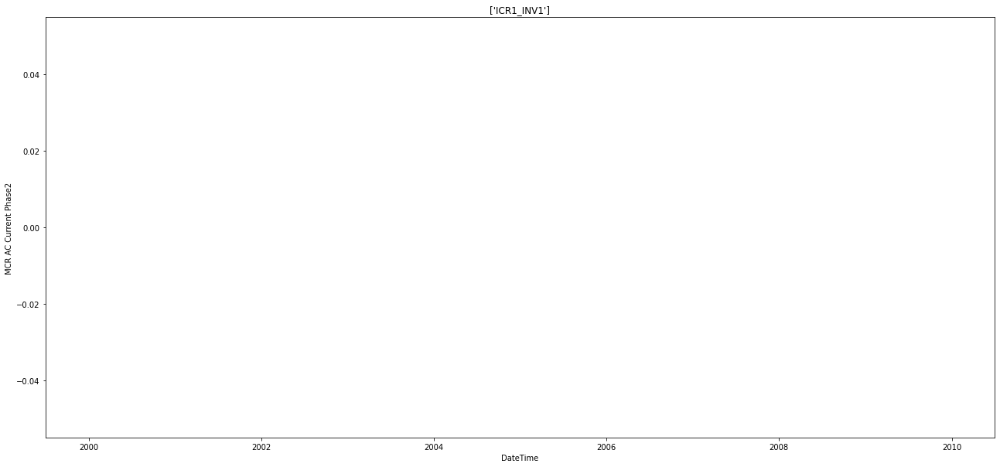

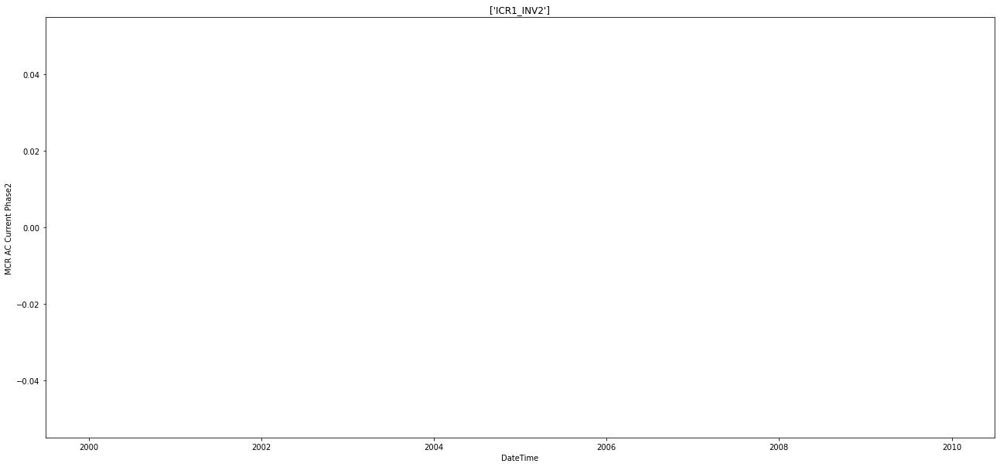

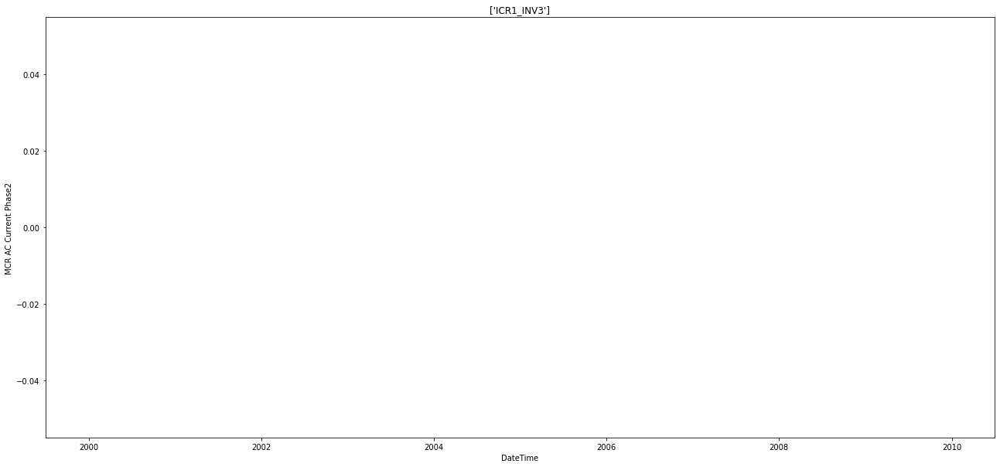

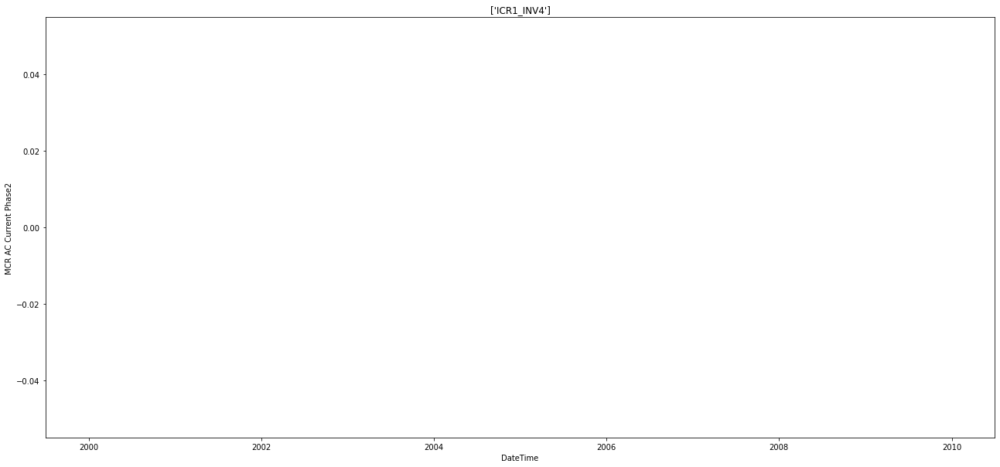

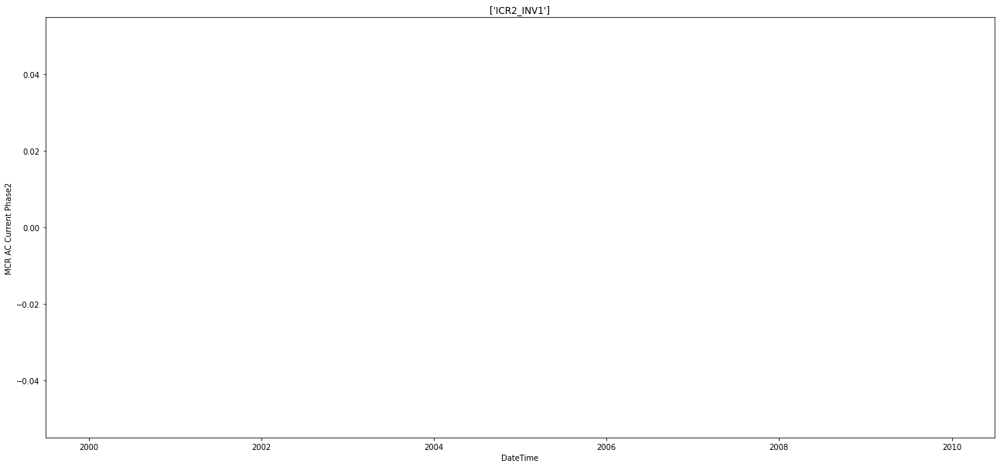

...

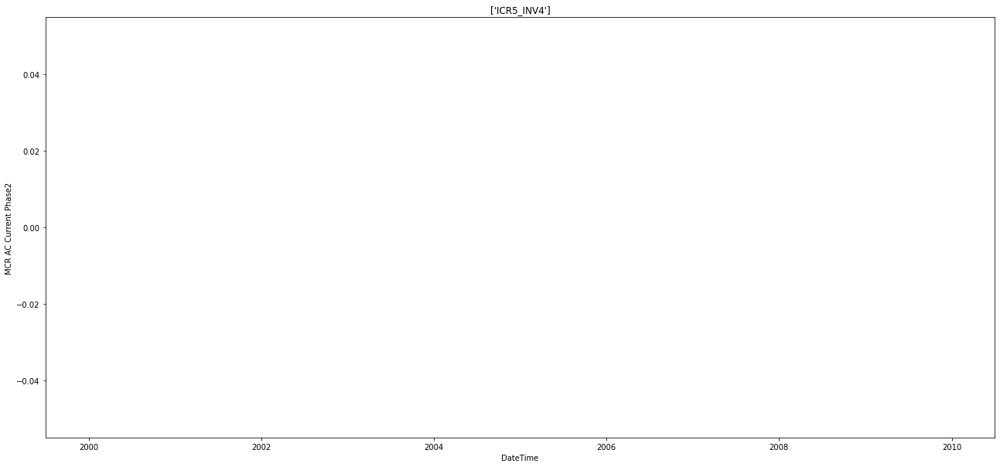

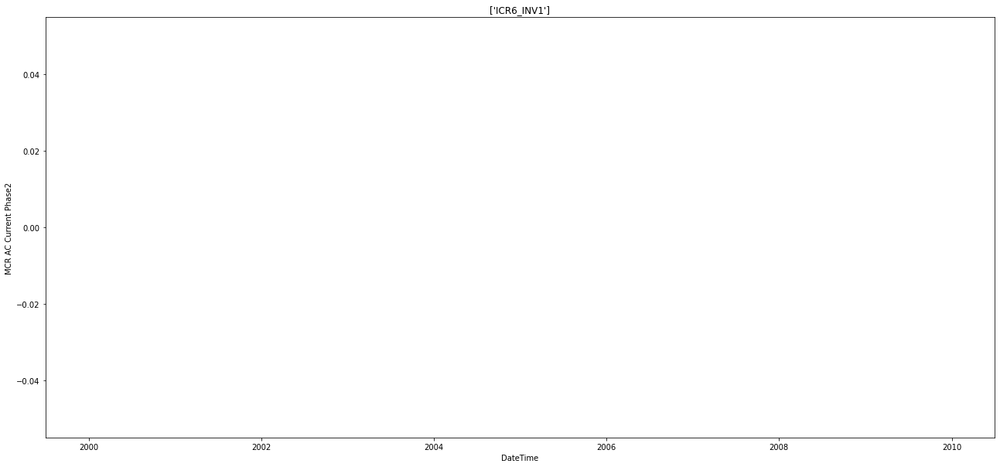

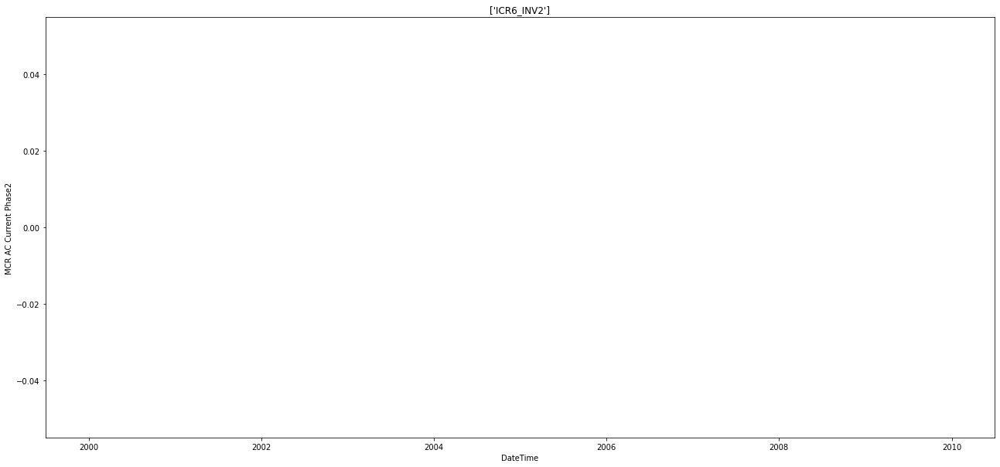

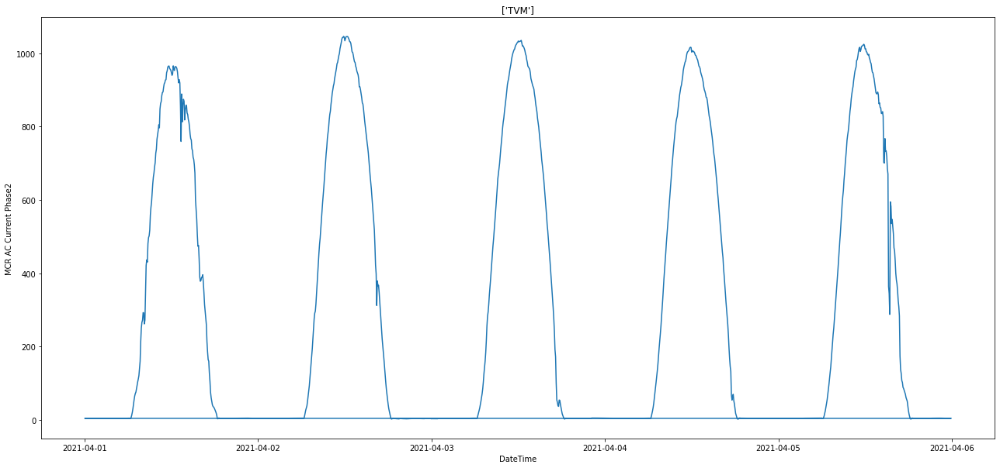

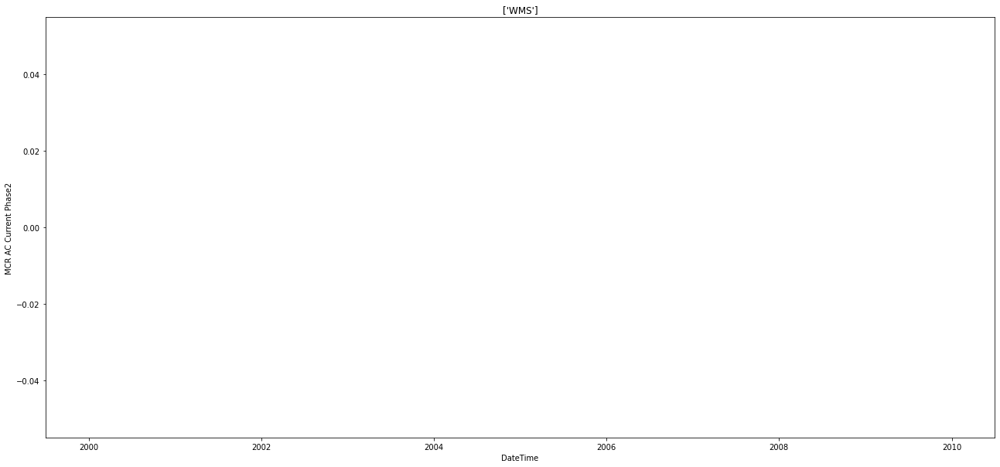

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['MCR AC Current Phase2'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('MCR AC Current Phase2')
  plt.show()

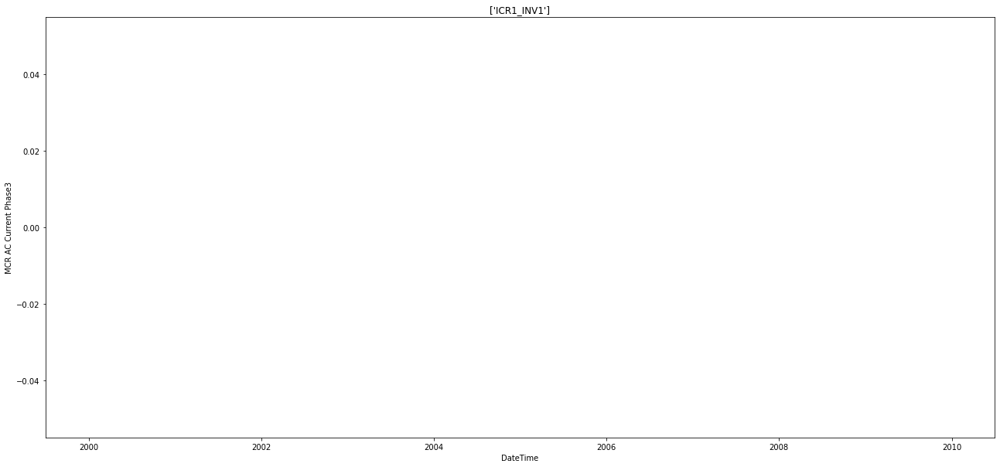

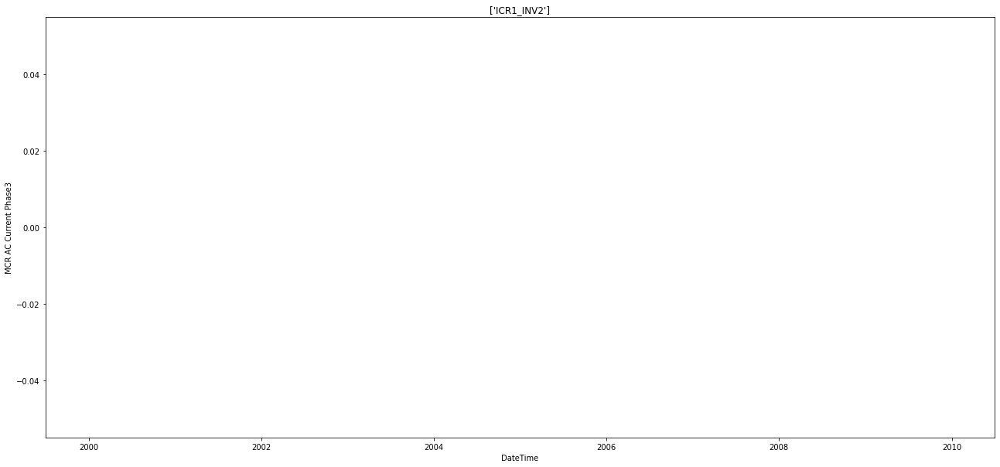

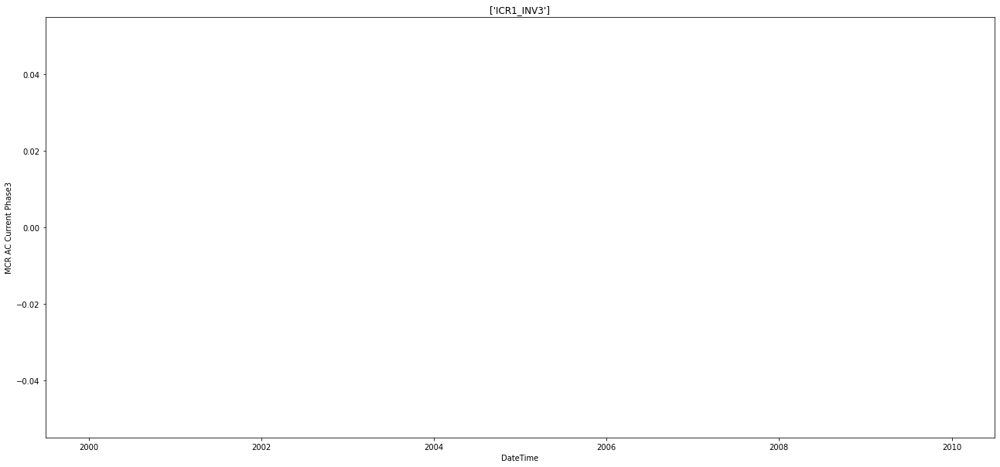

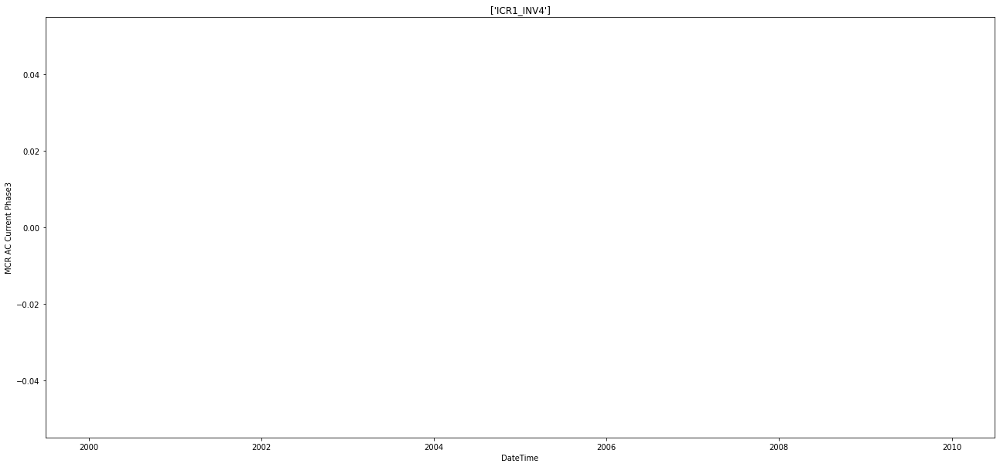

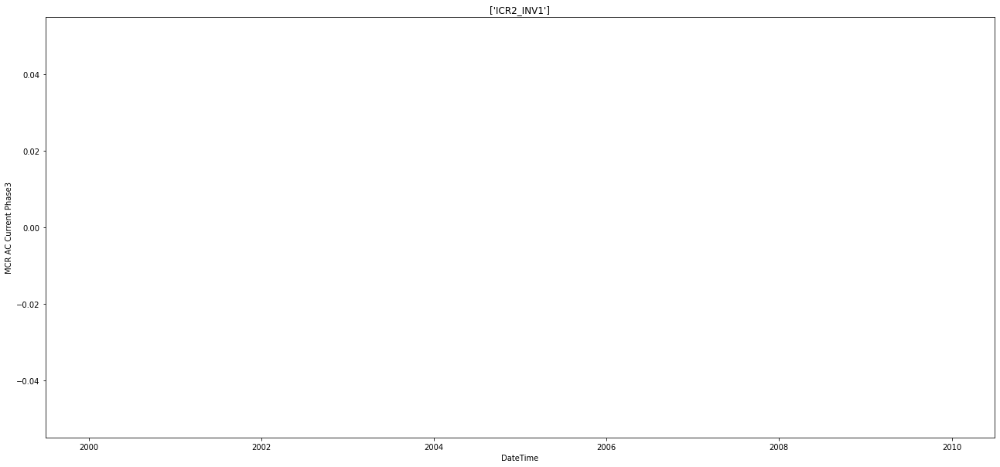

...

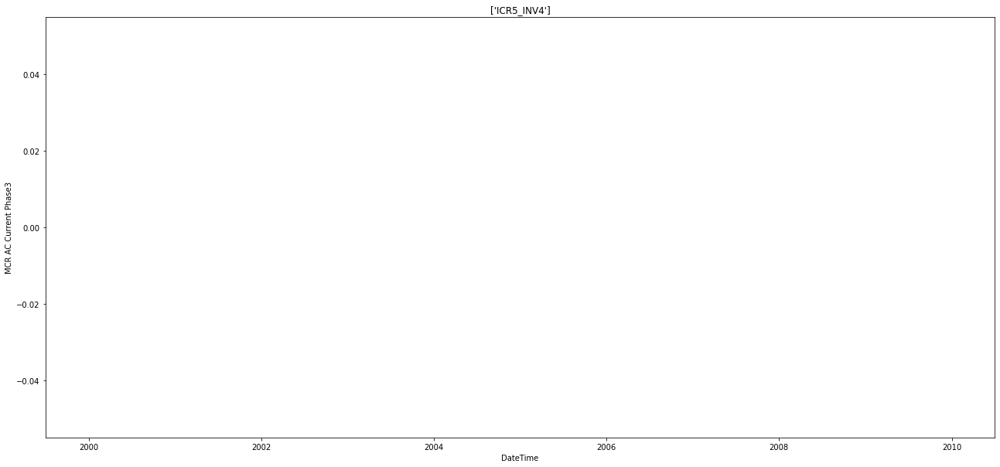

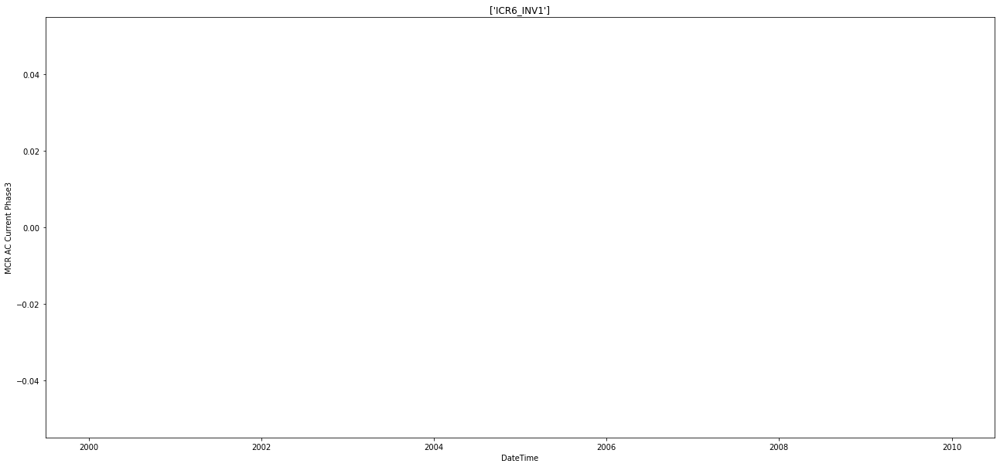

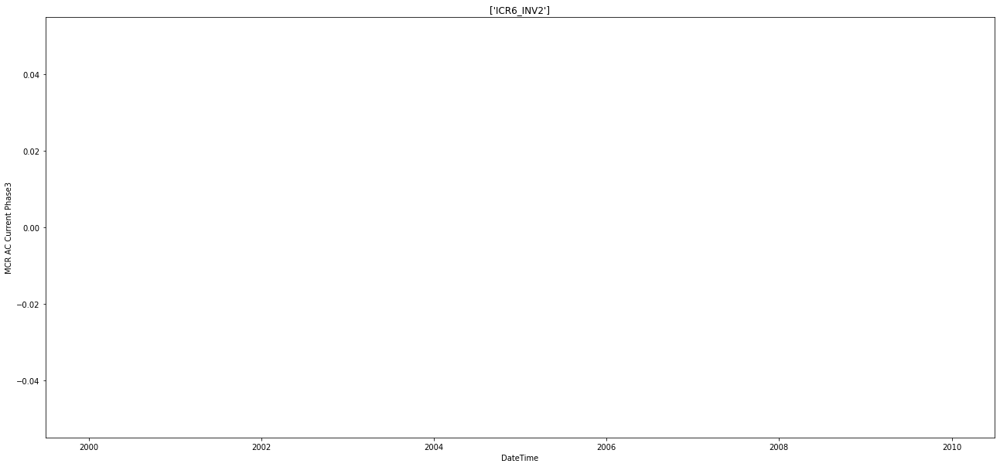

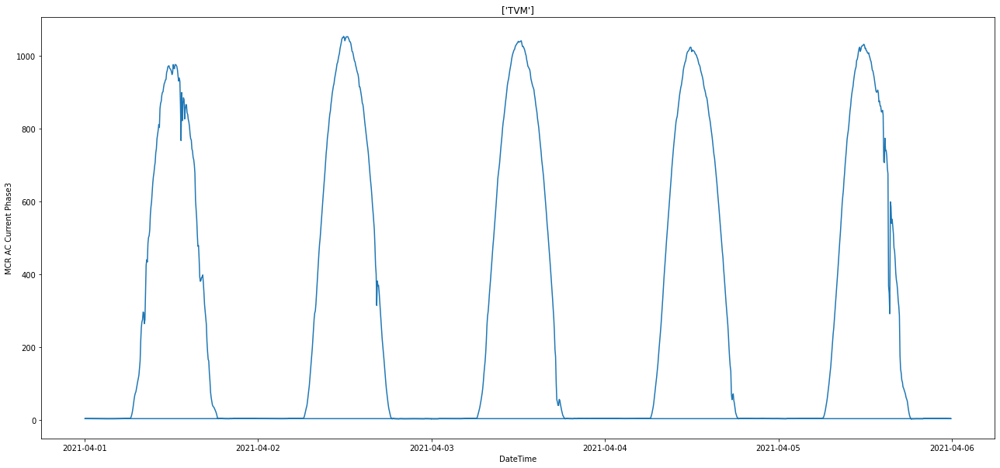

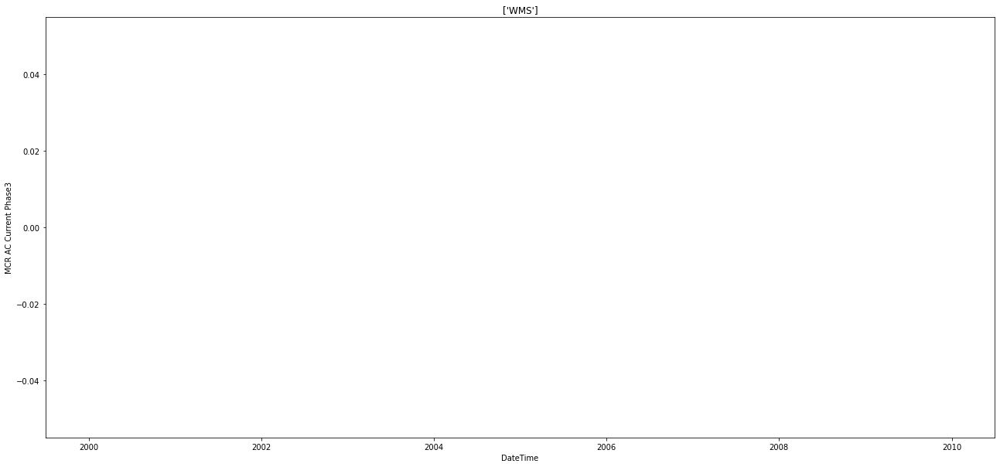

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['MCR AC Current Phase3'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('MCR AC Current Phase3')
  plt.show()

#Conclusion: DateTime vs AC Power for various AssetName
We can make the following very important conclusions from the above results :


*   All the ICR_INV values for AC Current values are almost same with +_2% variance. Very similar variance levels were found for DC Power wrt ICR_INV values. Hence we need not take all ICR_INV columns values and just take one out of the 22 ICR_INV values.
*   There are 3 different AC Phase current values and all of them have almost the same values and hence we need not take all three columns into consideration.

*   The MCR AC Current values are being measured only by AssetName 'TVM', hence this sensor might be the only one measuring MCR values. All the three phase MCR Current values are also with very small variance, hence we need not take all three columns into consideration.<br>**Take one of the 3 AC Current Phase values with one of the ICR_INV as input, and take one of the 3 MCR AC Current values with AssetName TVM.**





# **Analysis: Voltage values vs DateTime for different AssetNames**

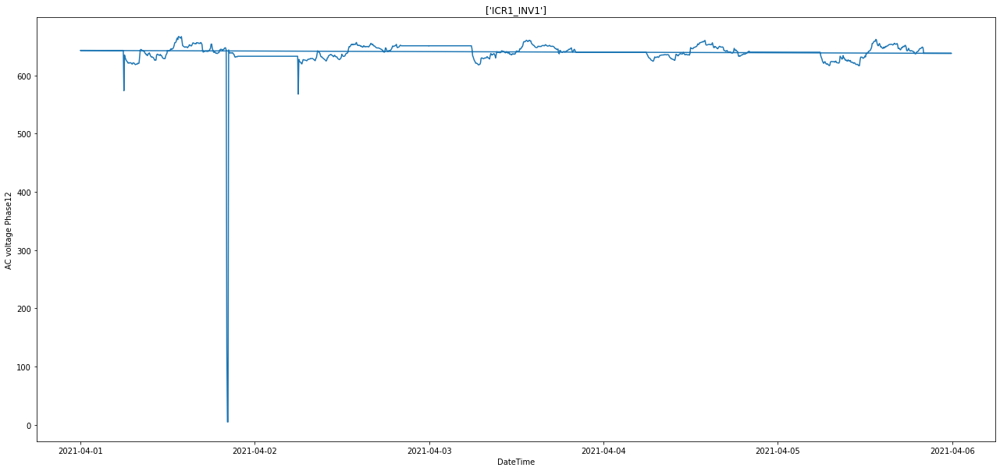

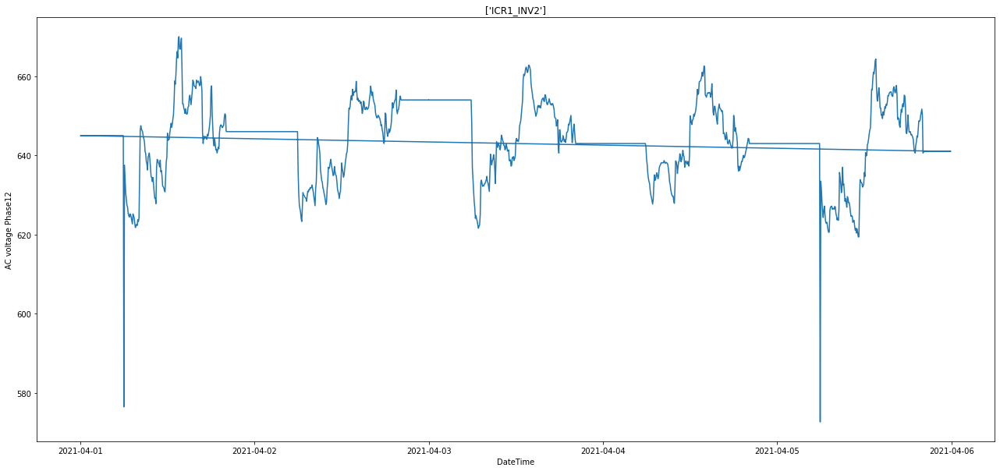

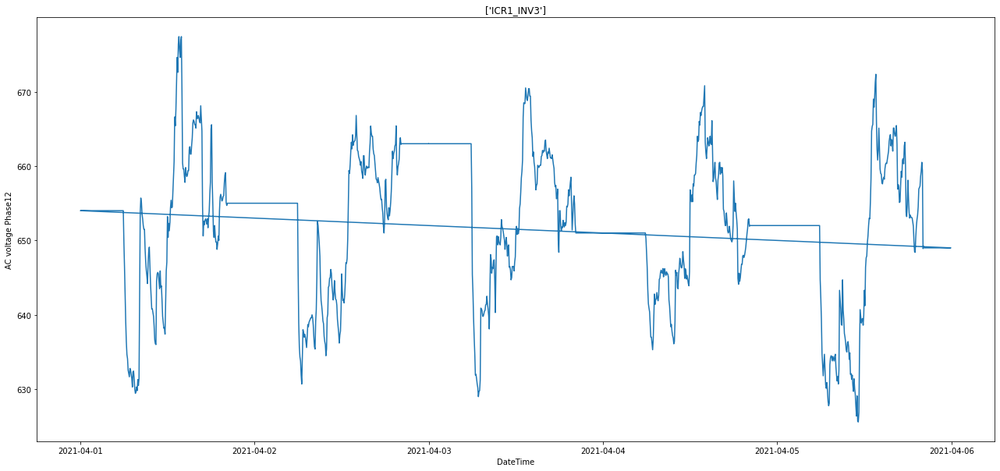

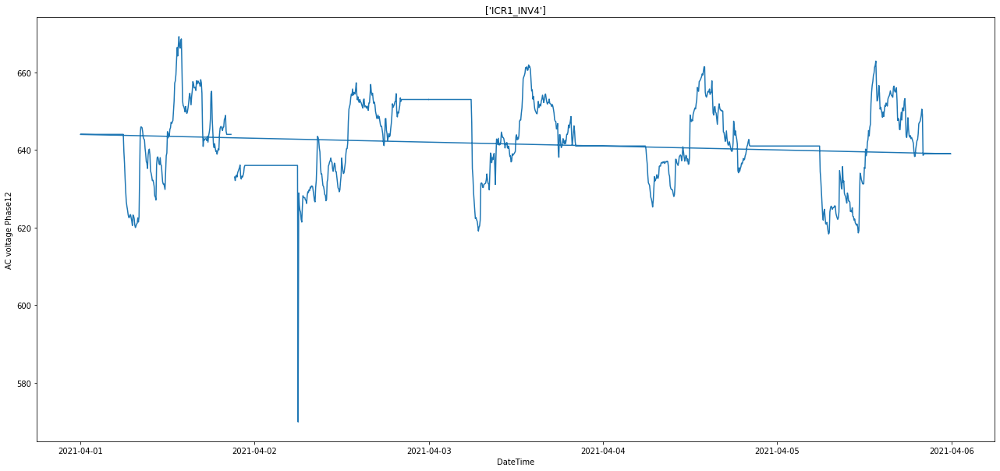

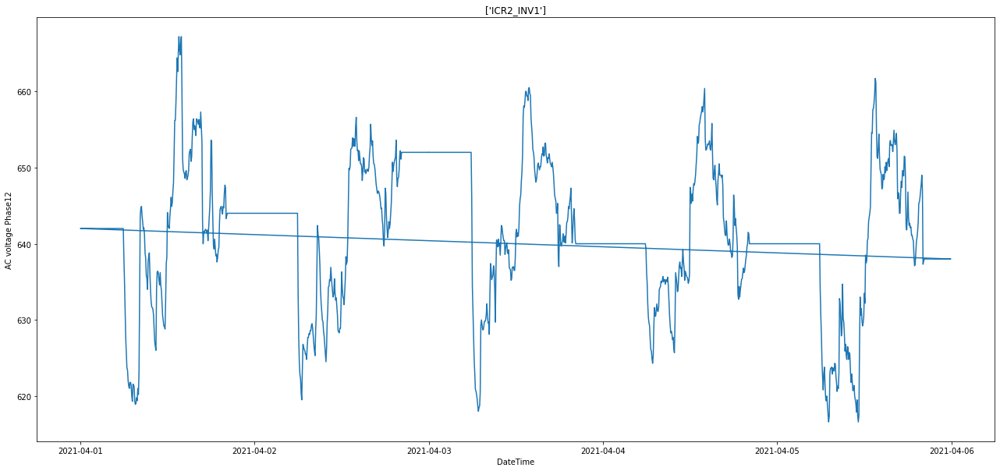

...

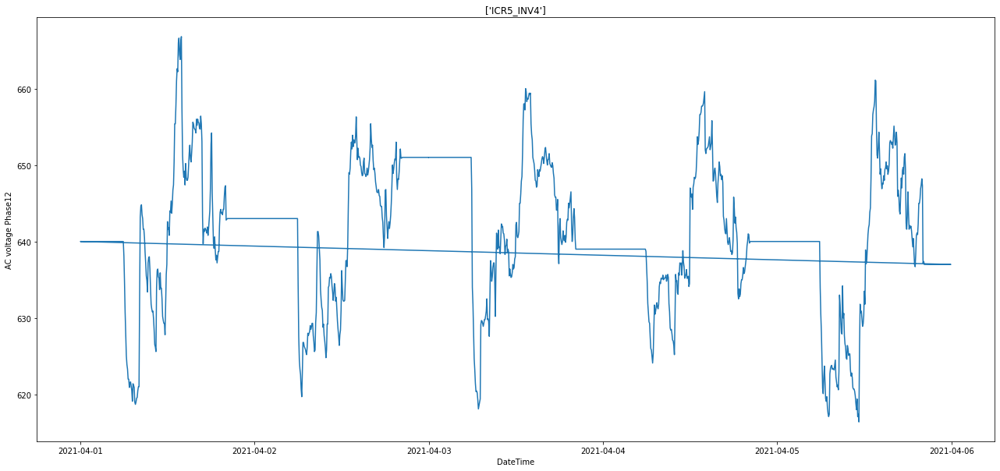

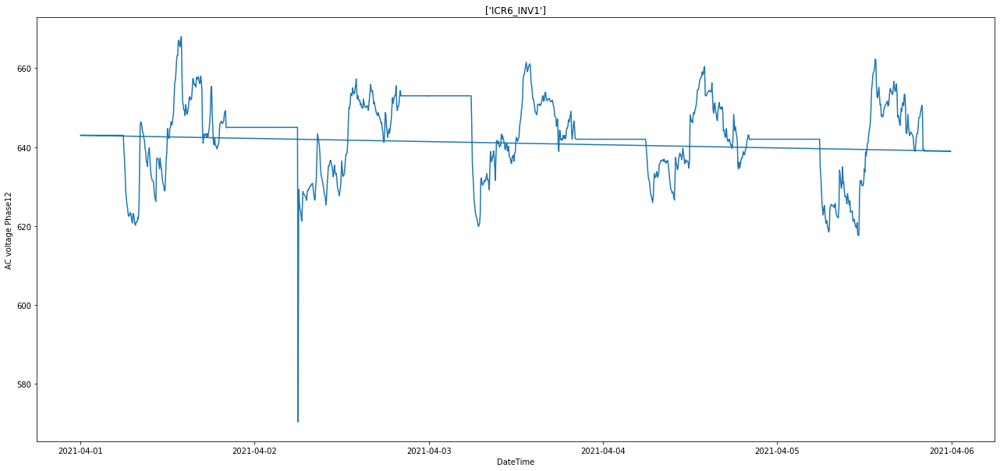

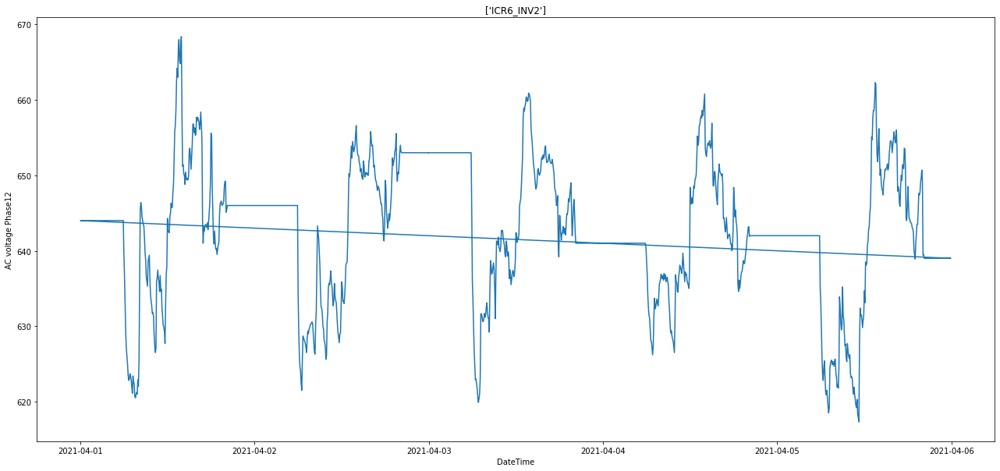

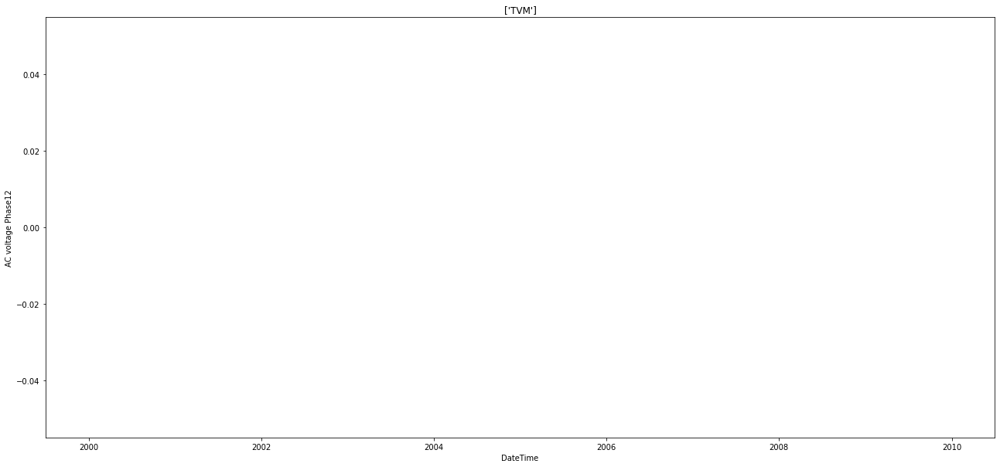

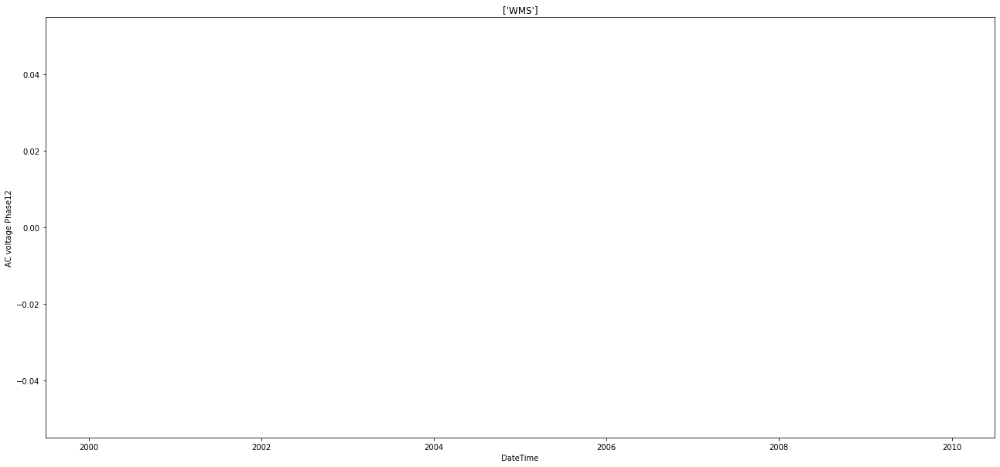

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['AC voltage Phase12'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('AC voltage Phase12')
  plt.show()

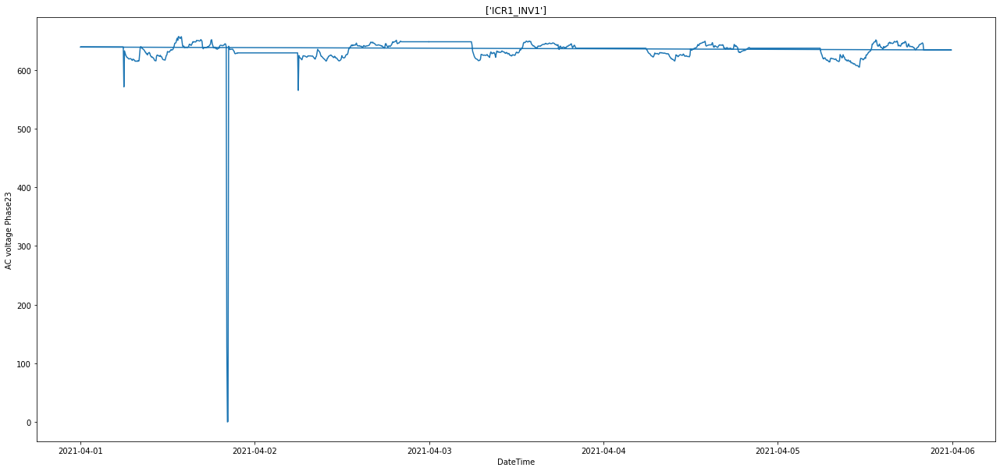

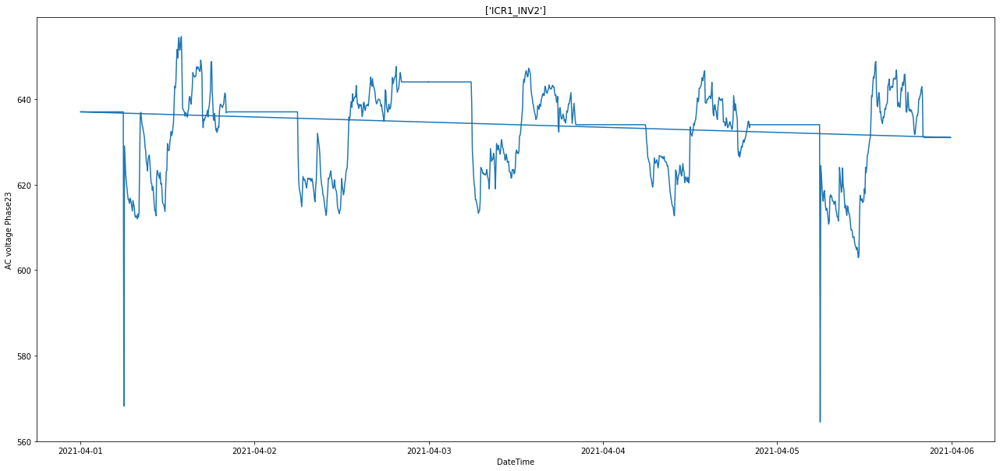

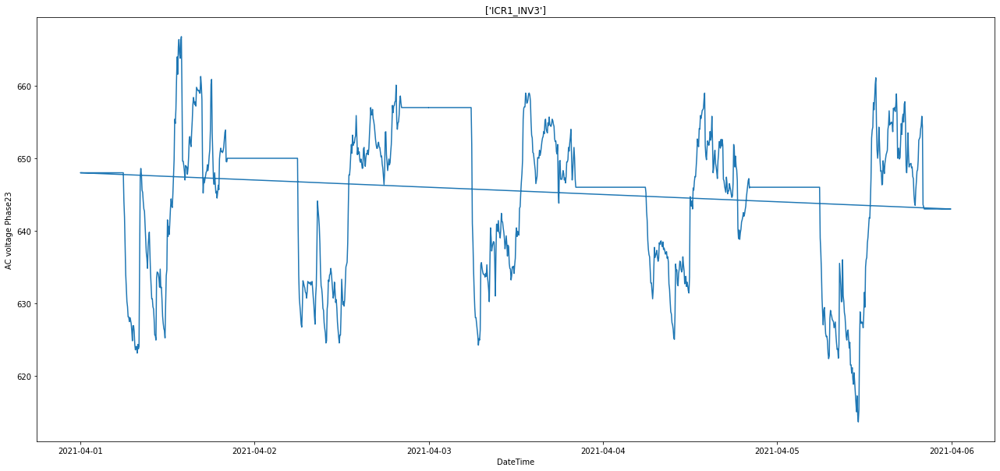

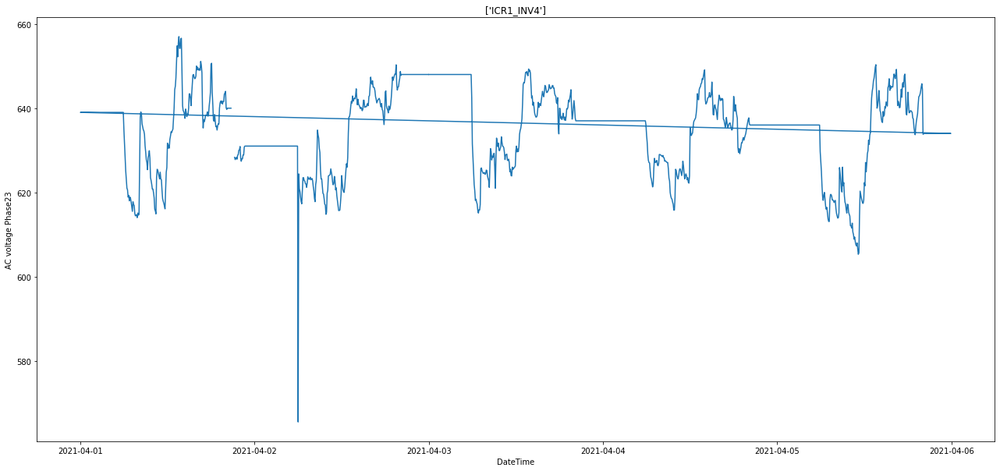

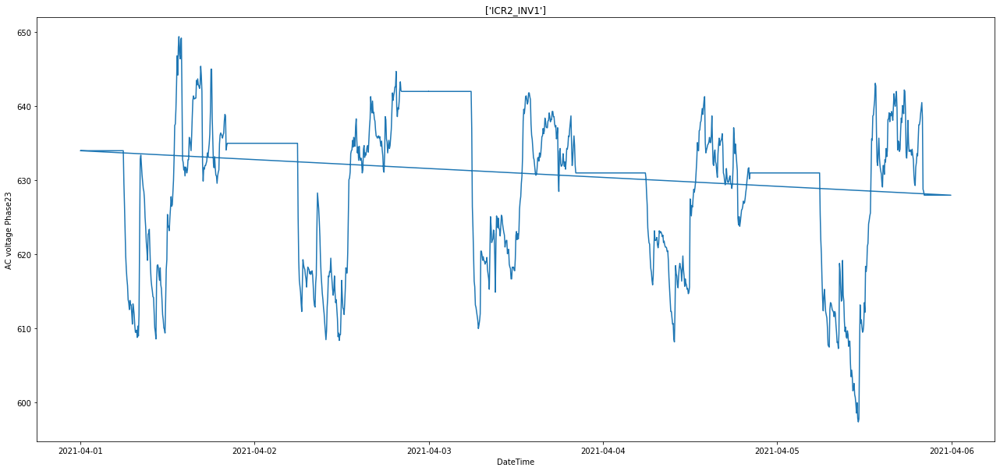

...

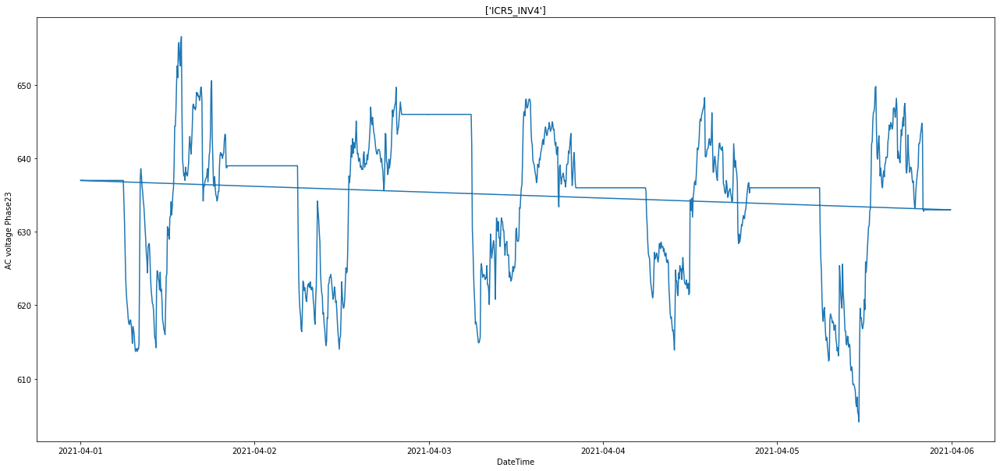

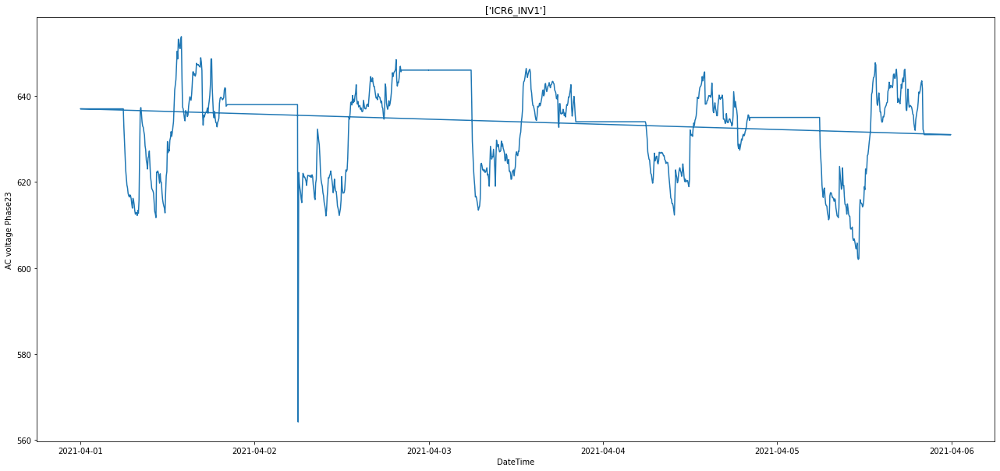

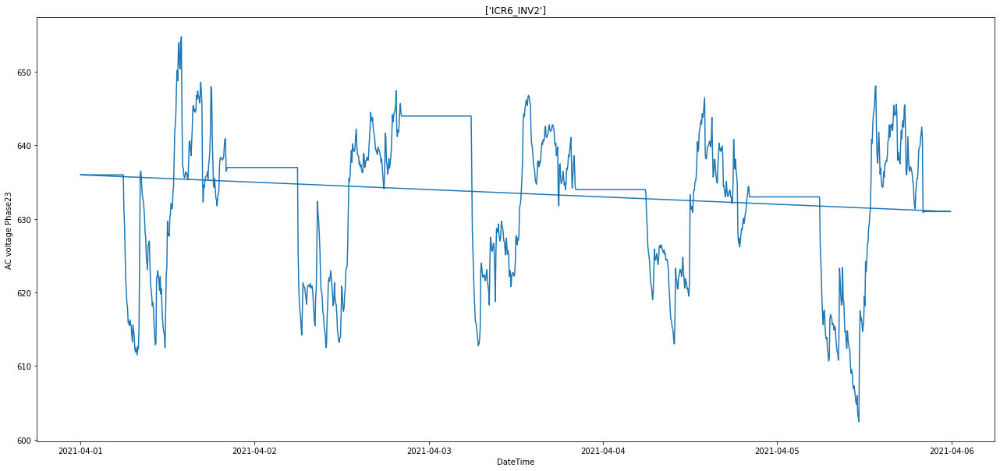

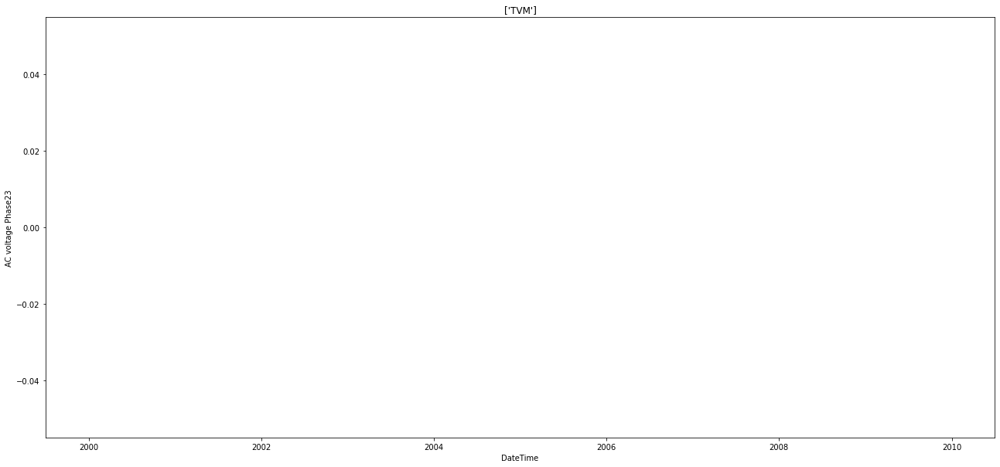

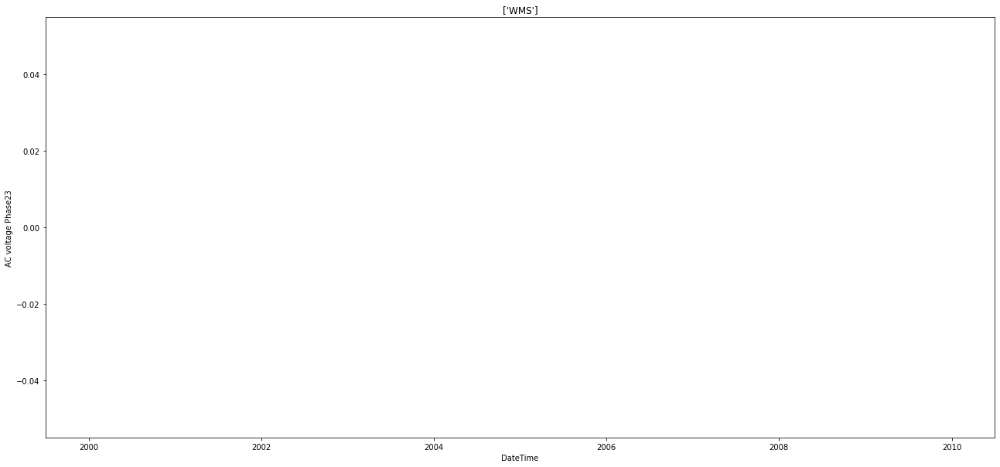

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['AC voltage Phase23'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('AC voltage Phase23')
  plt.show()

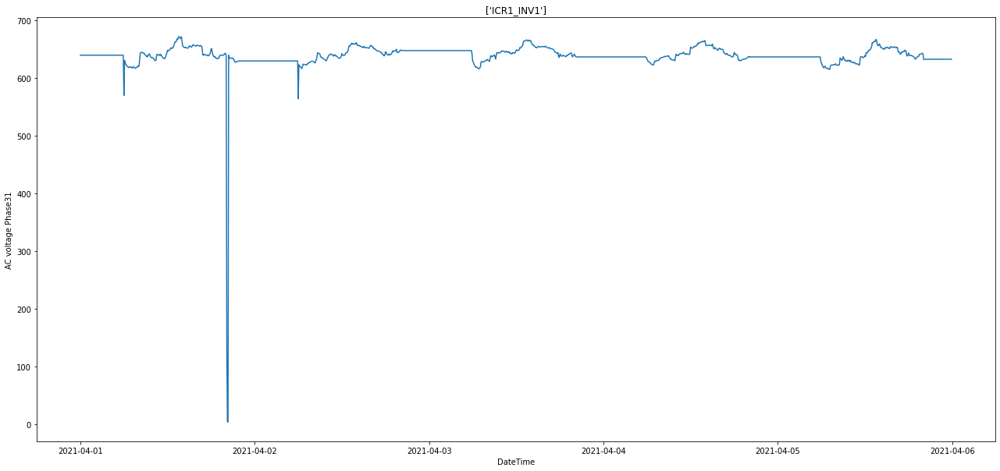

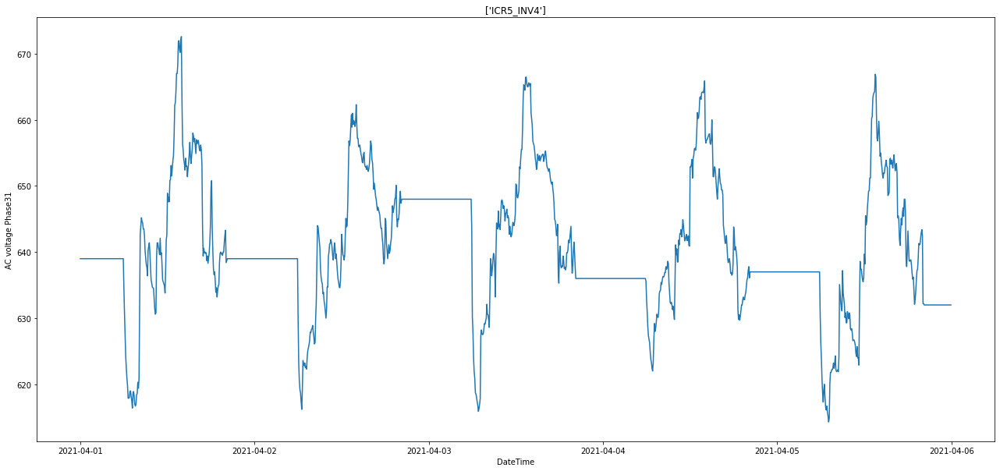

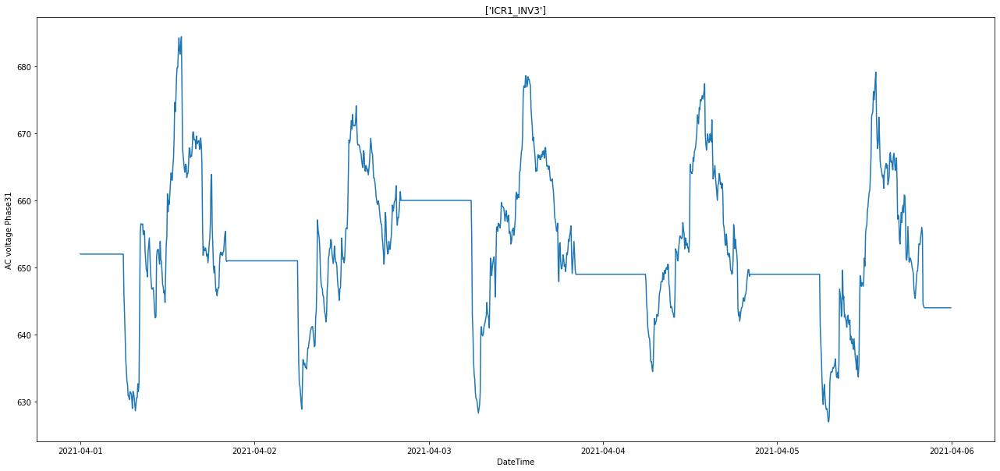

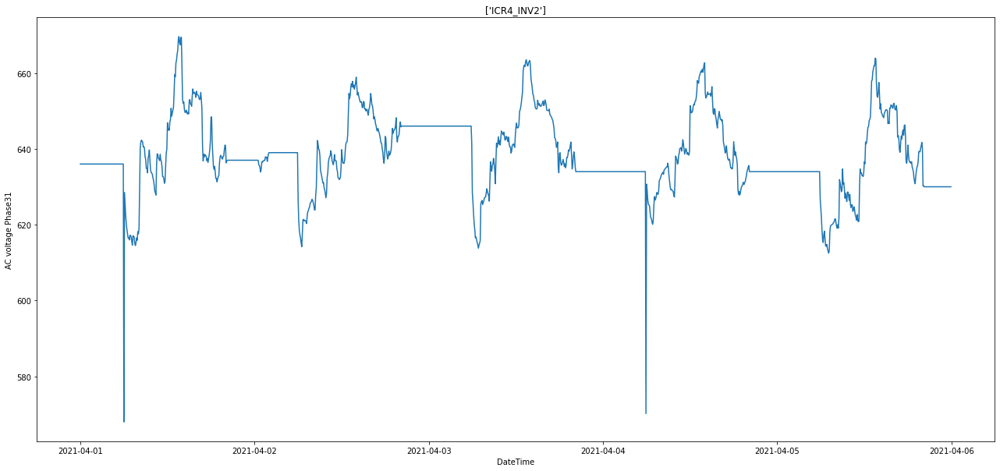

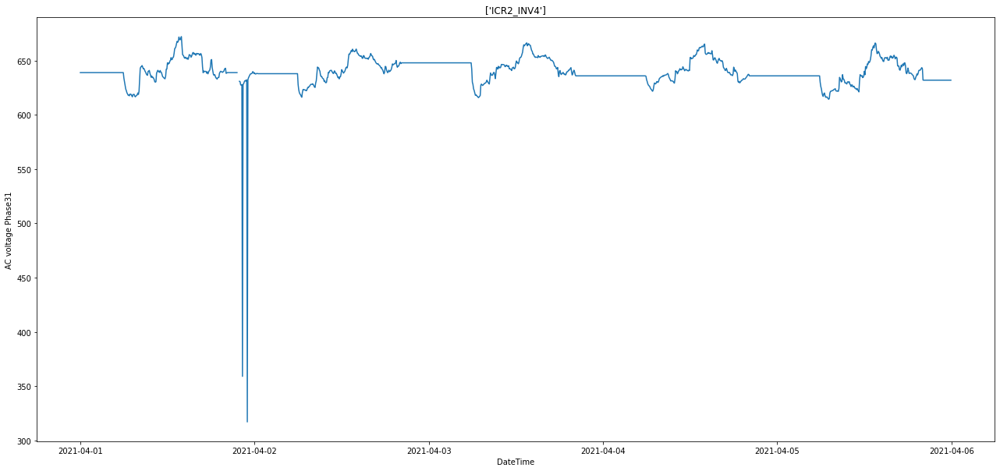

...

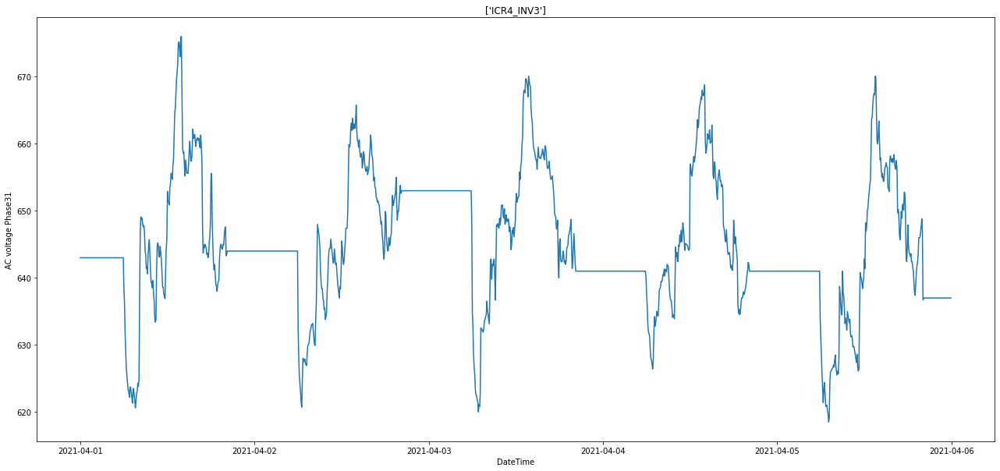

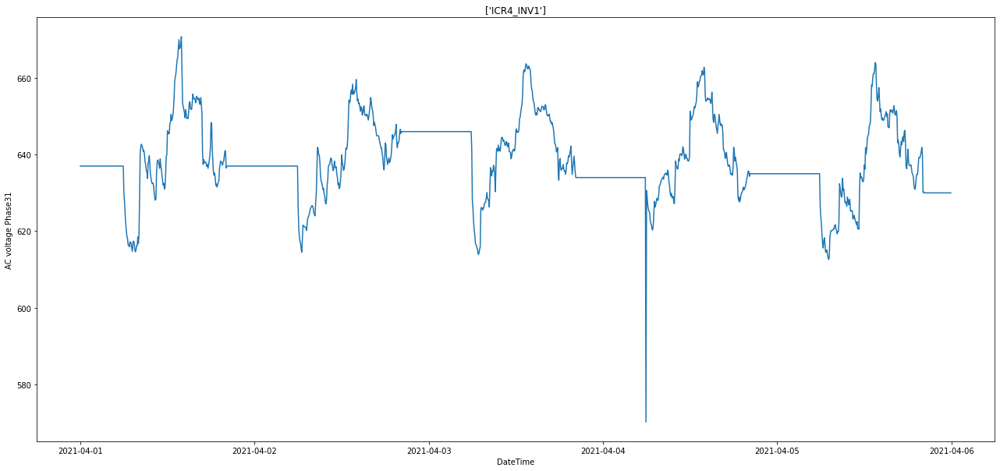

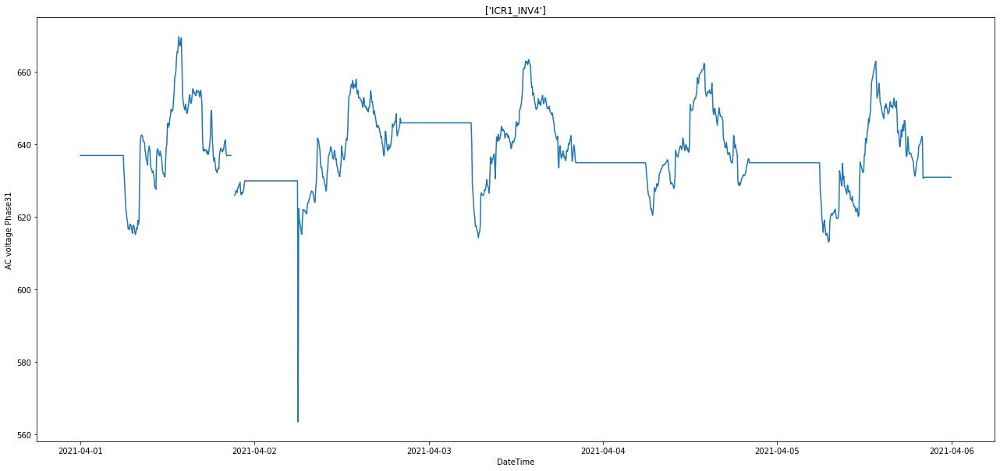

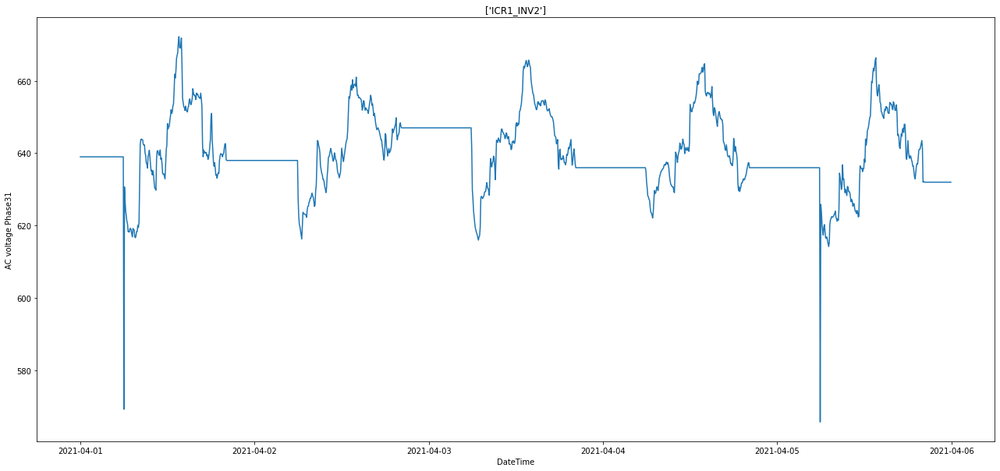

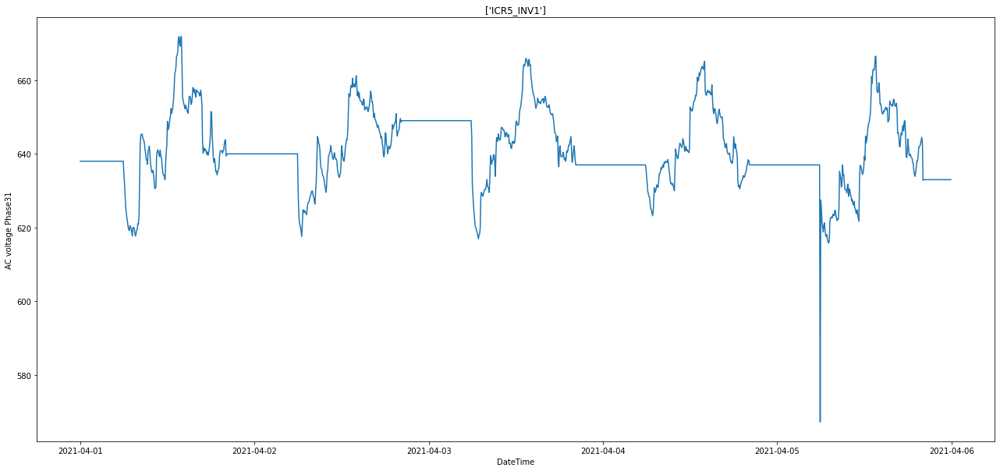

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['AC voltage Phase31'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('AC voltage Phase31')
  plt.show()

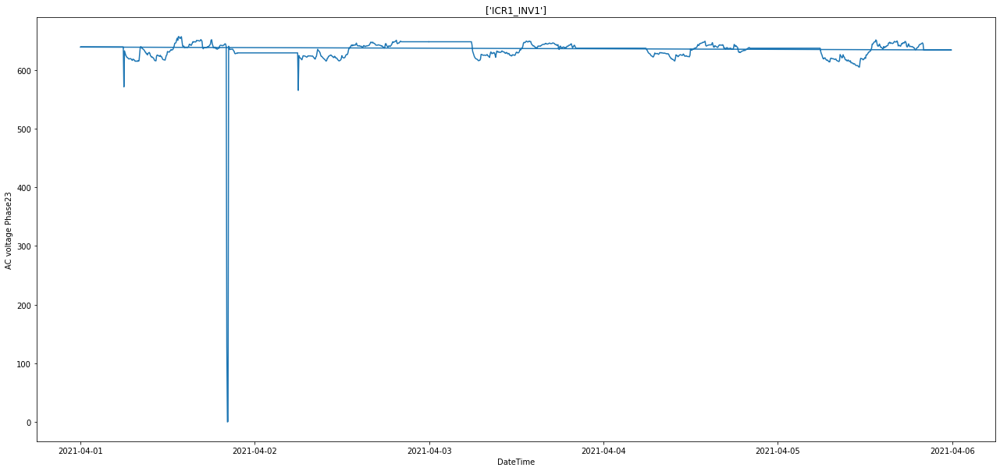

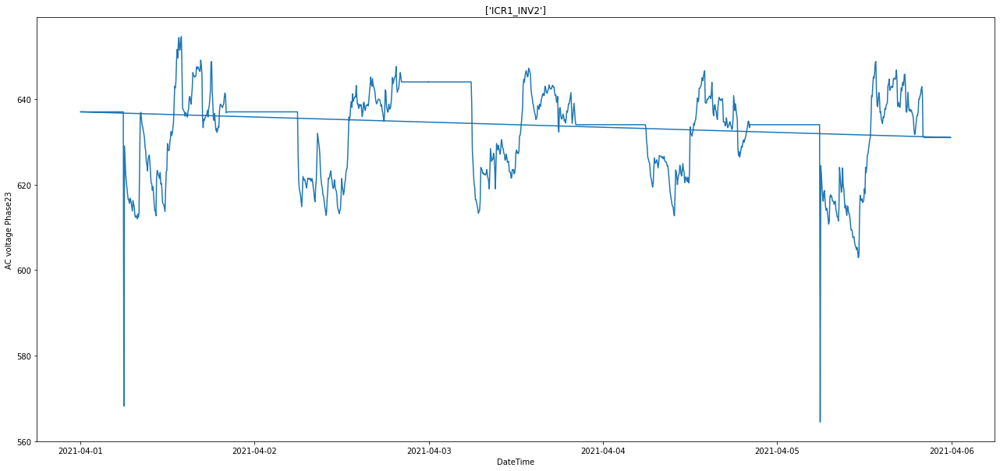

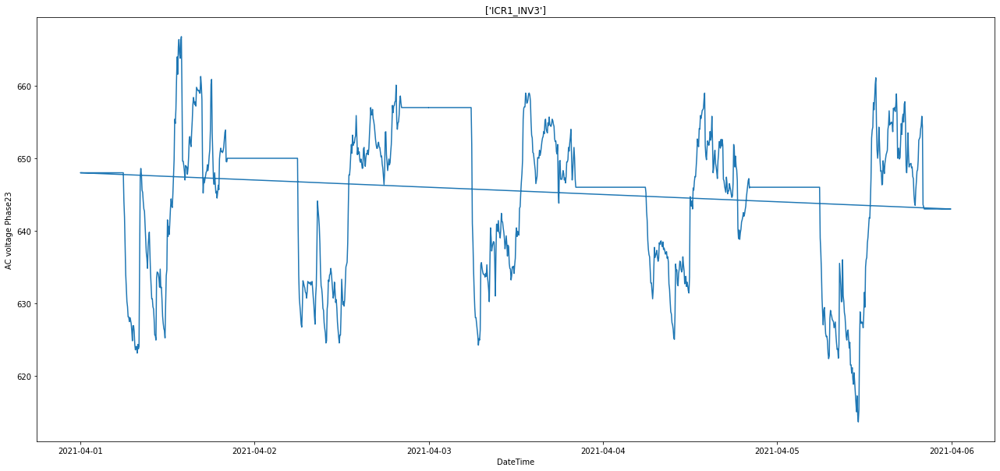

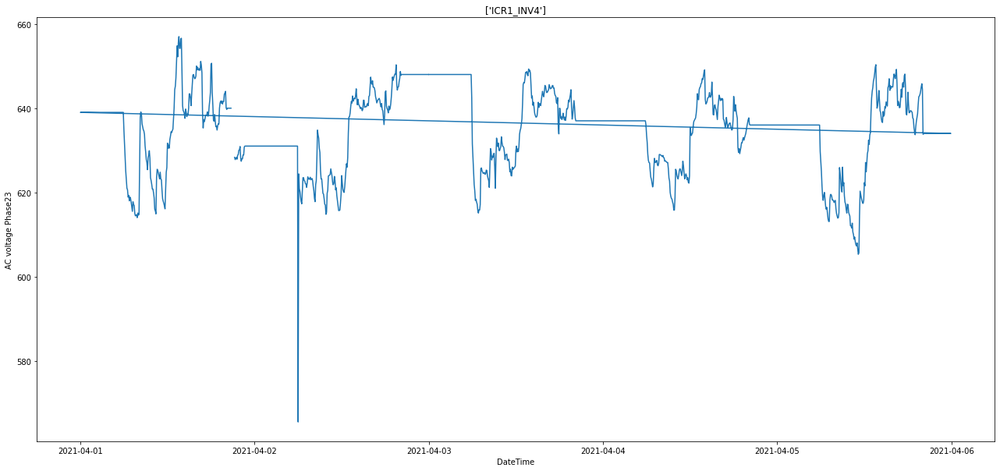

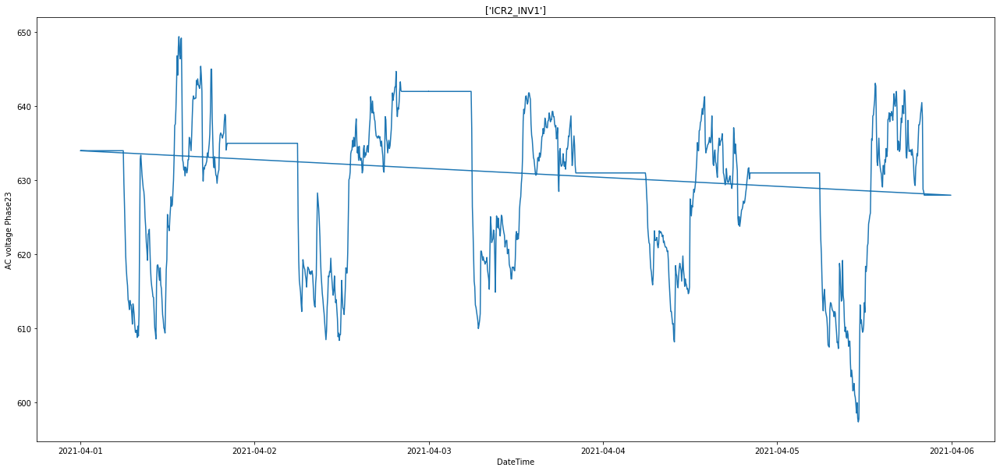

...

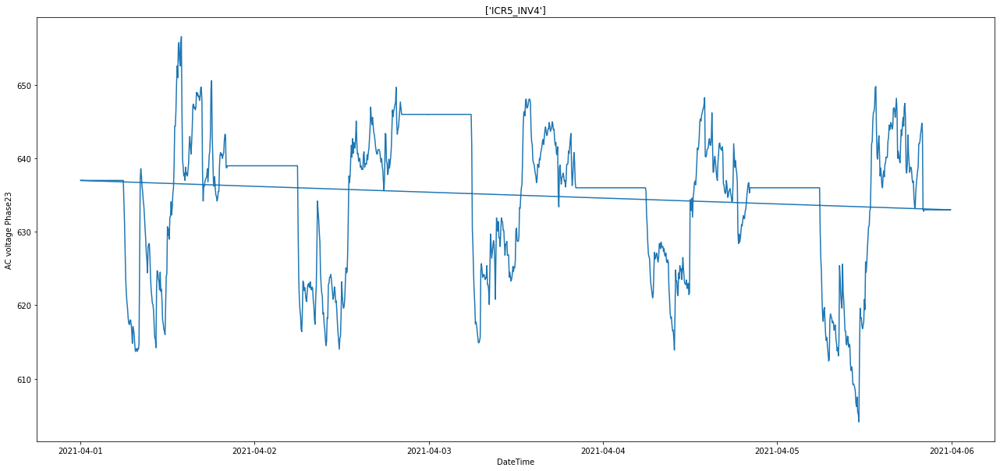

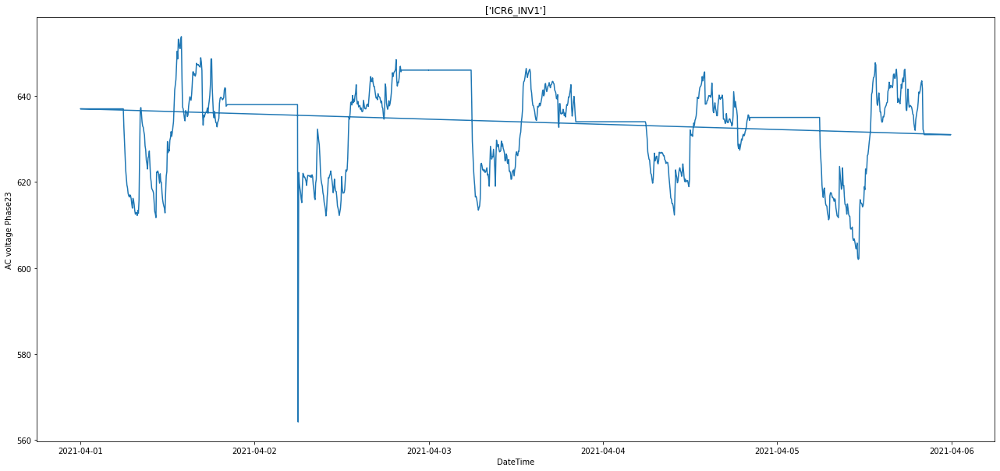

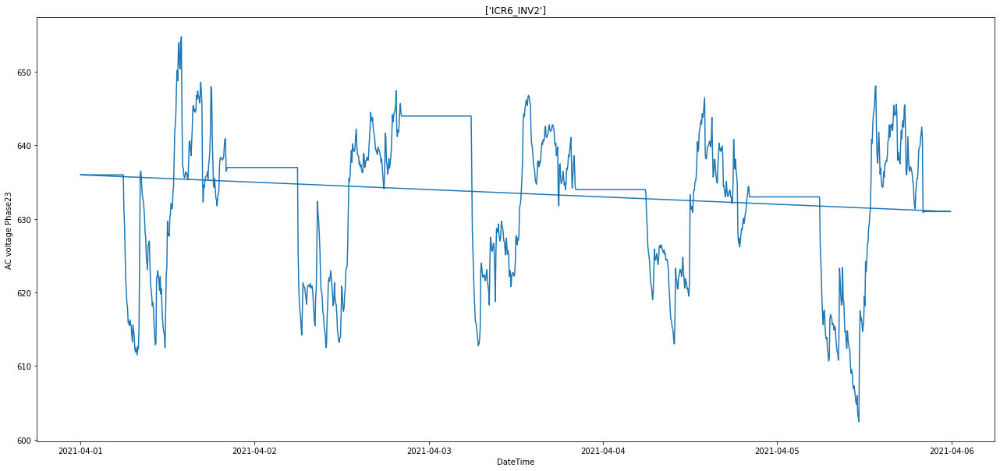

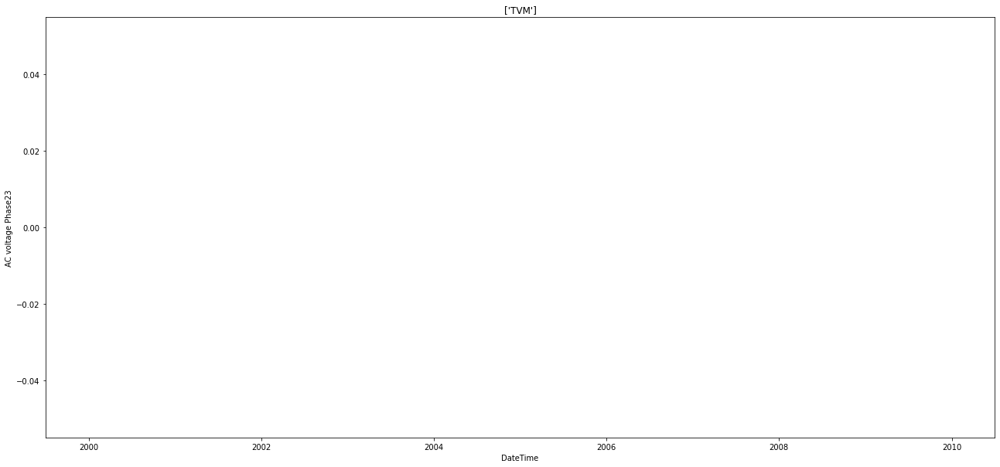

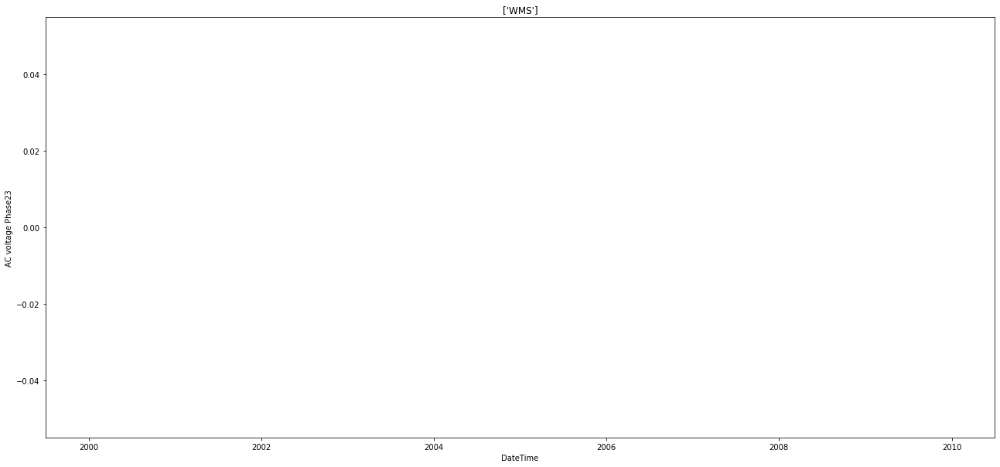

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['AC voltage Phase23'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('AC voltage Phase23')
  plt.show()

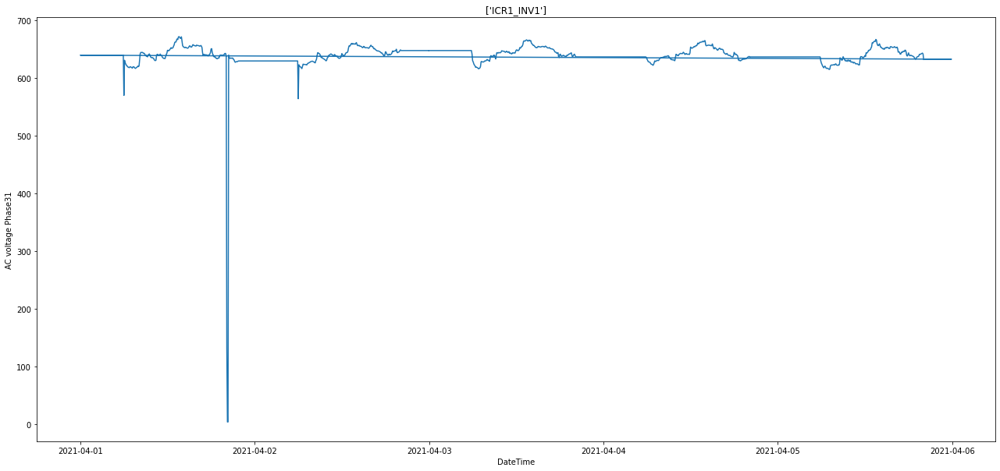

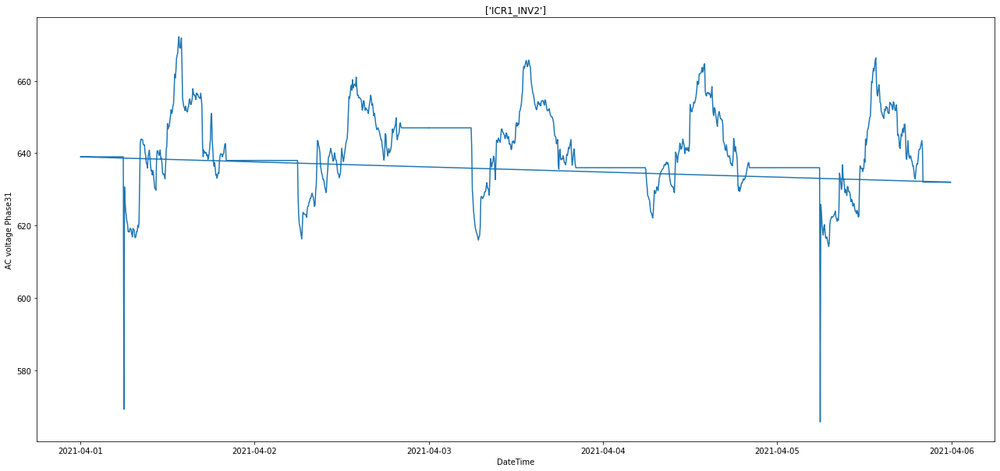

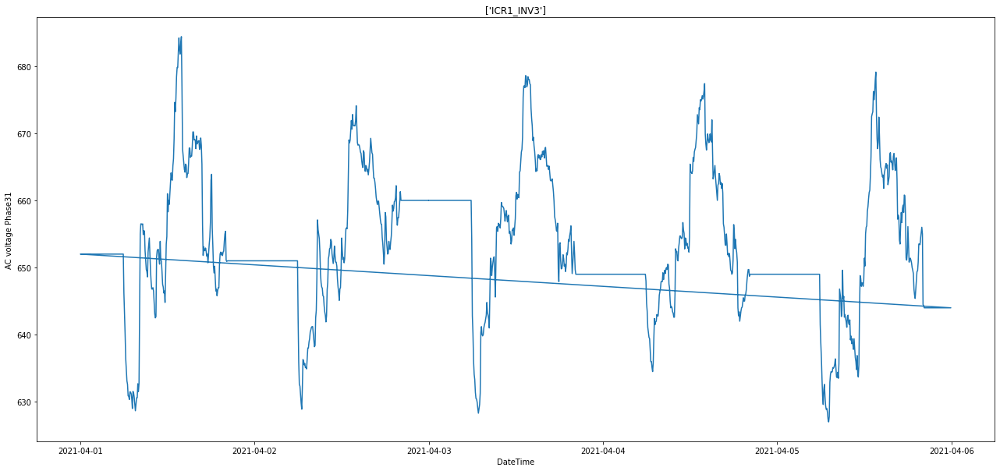

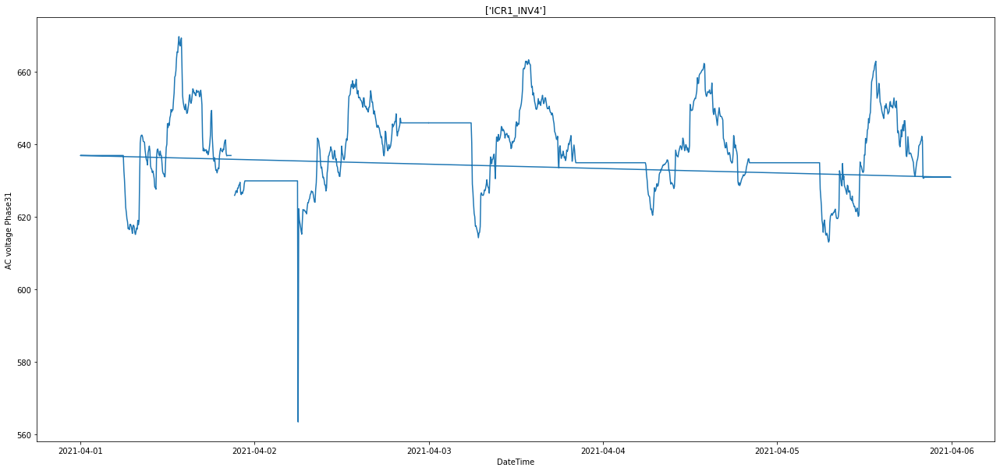

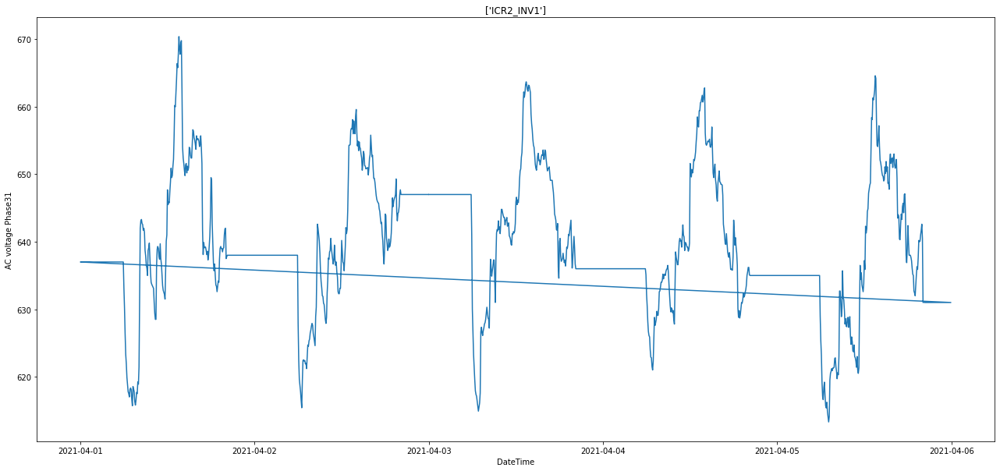

...

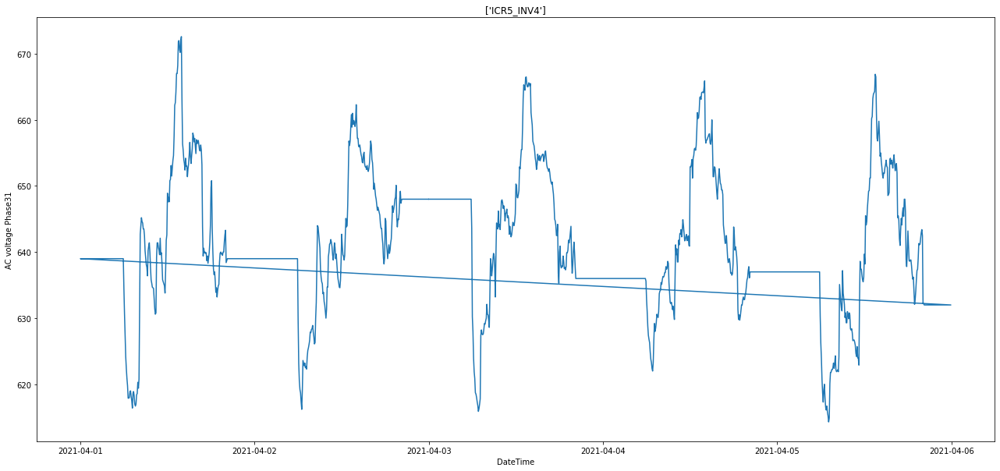

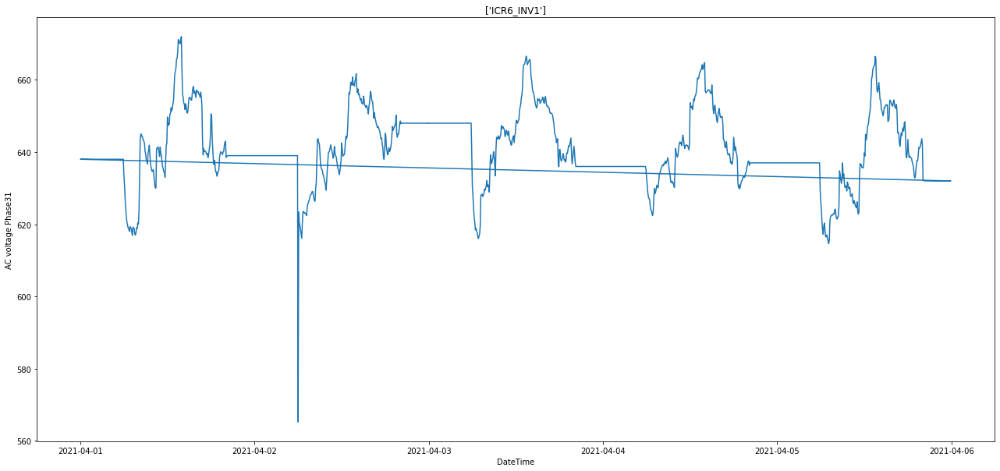

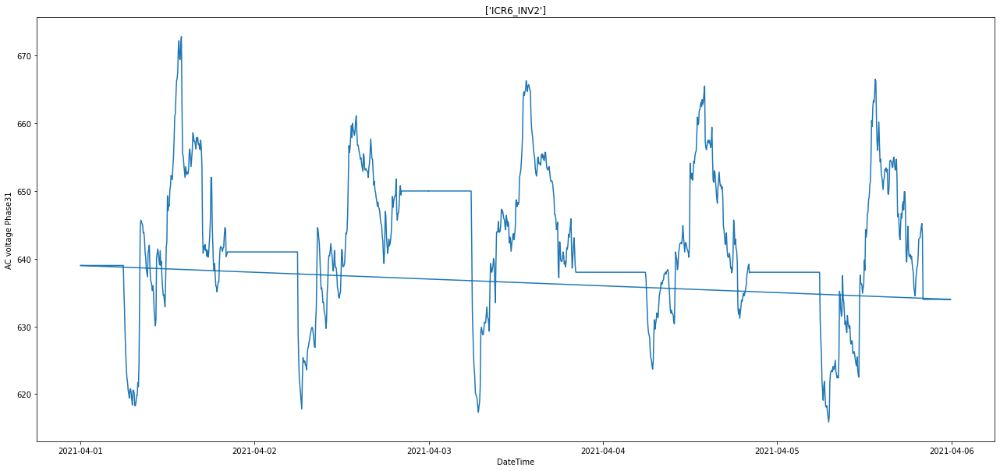

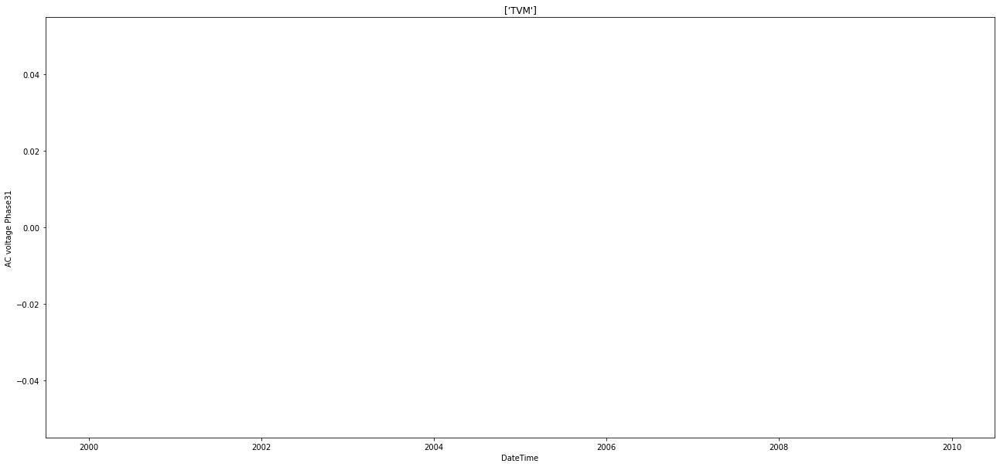

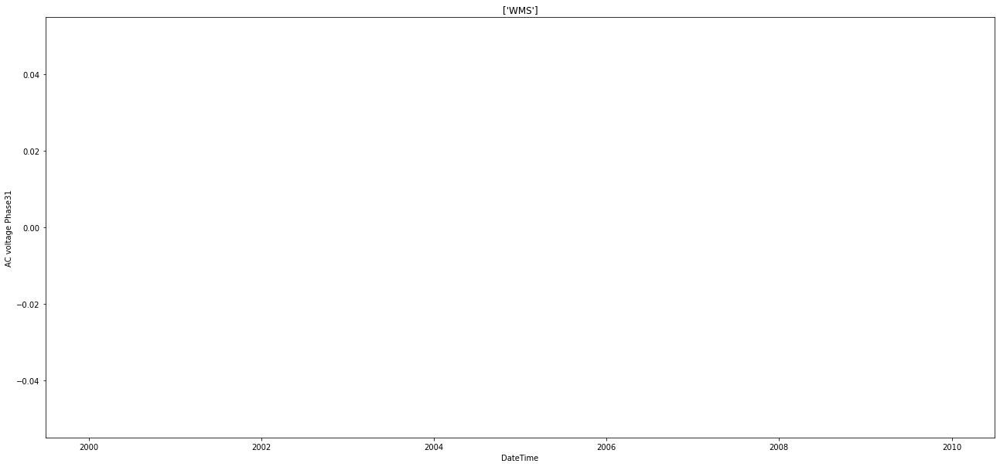

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['AC voltage Phase31'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('AC voltage Phase31')
  plt.show()

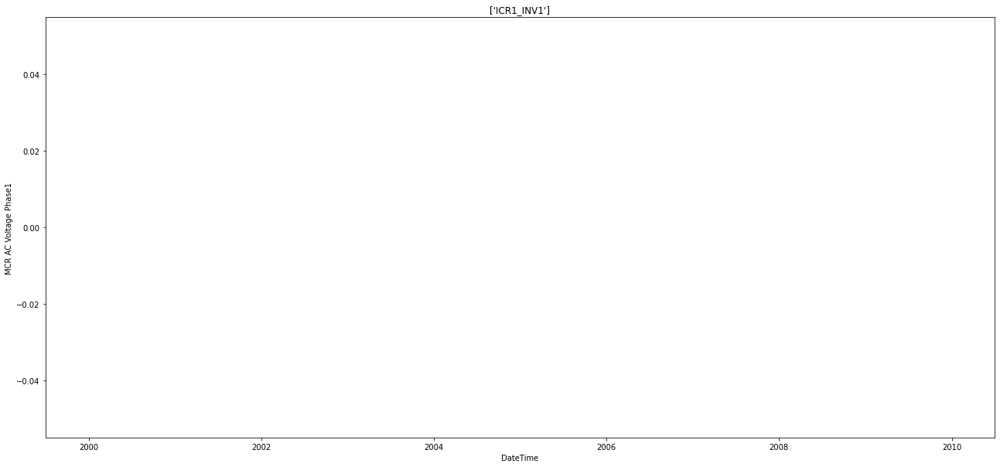

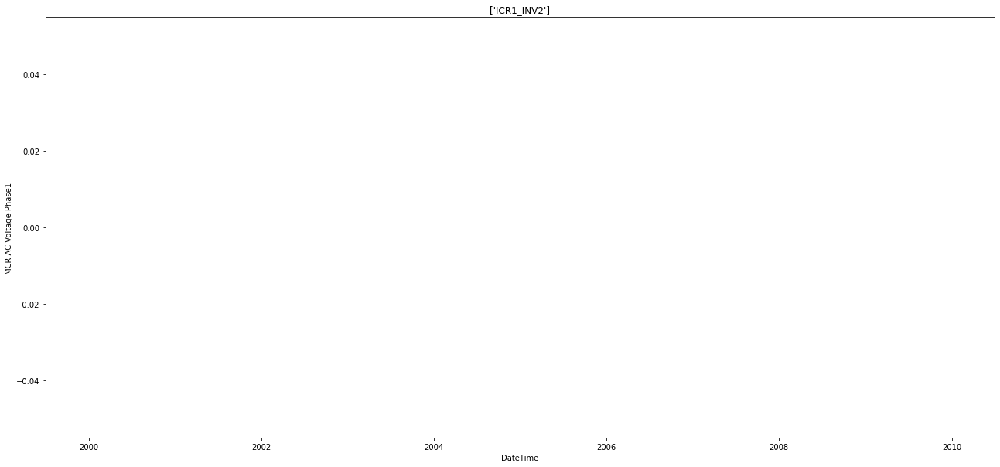

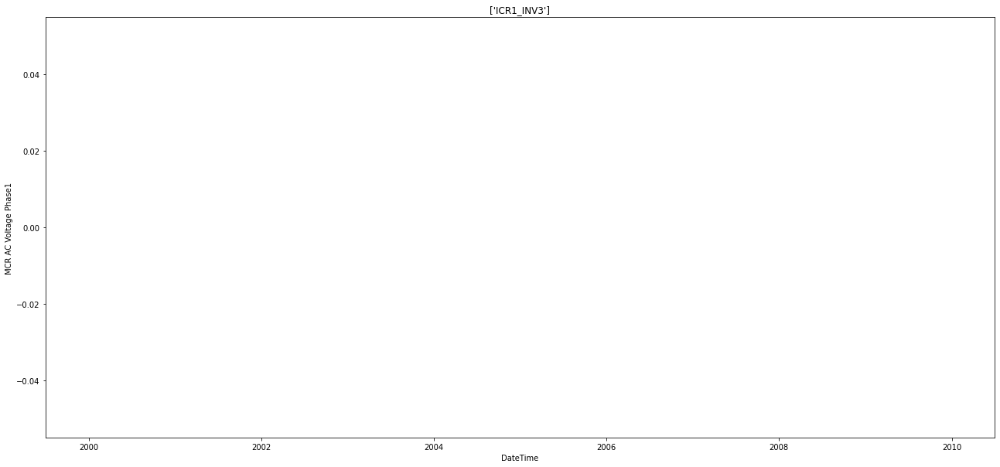

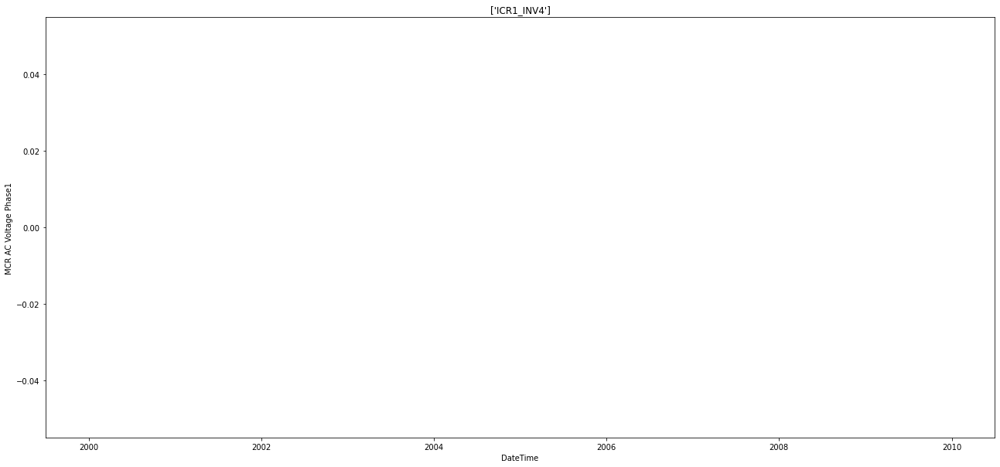

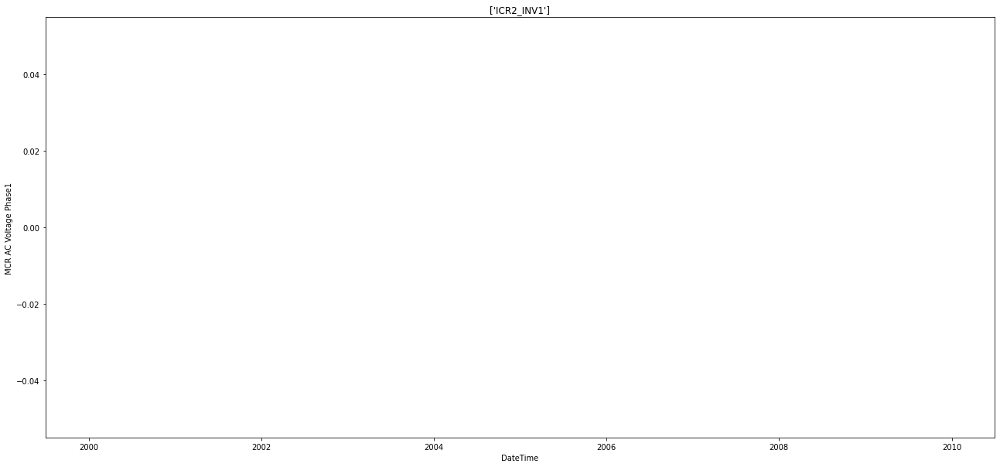

...

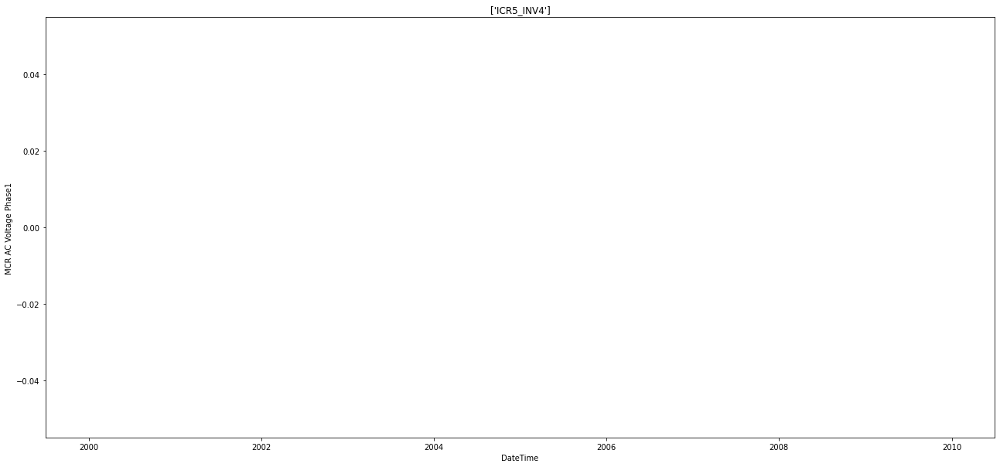

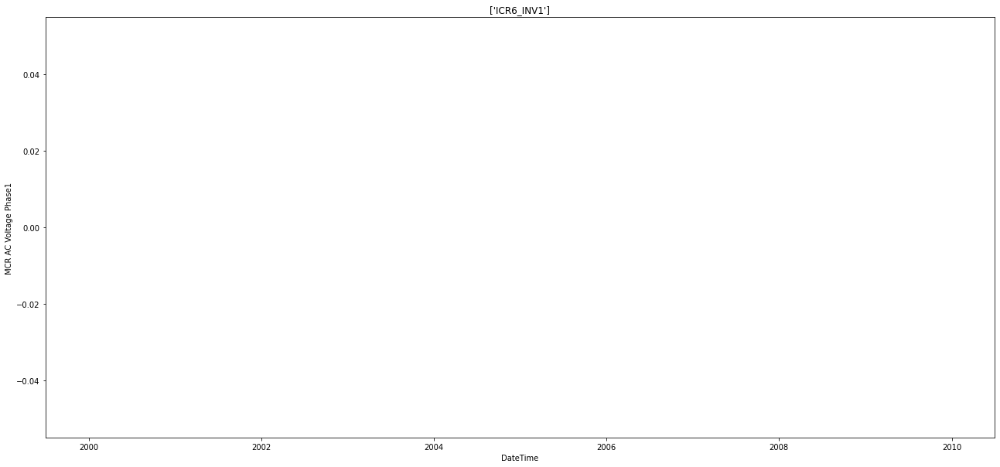

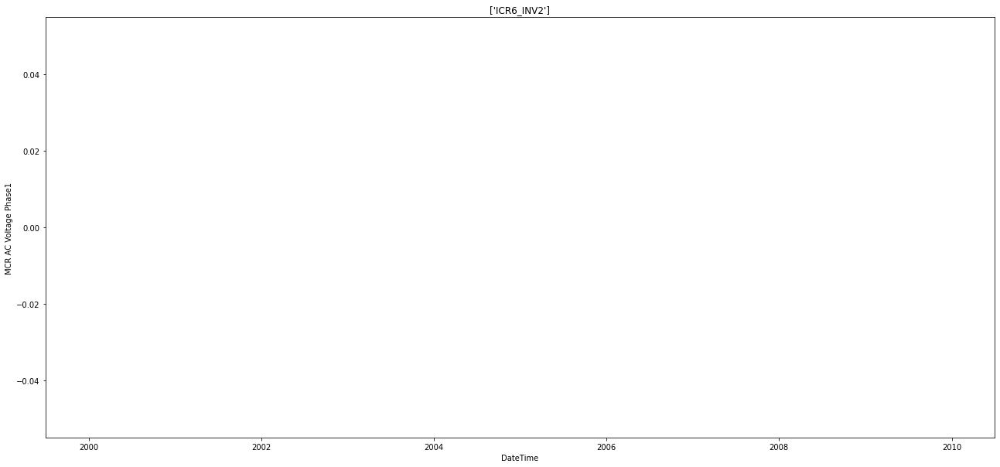

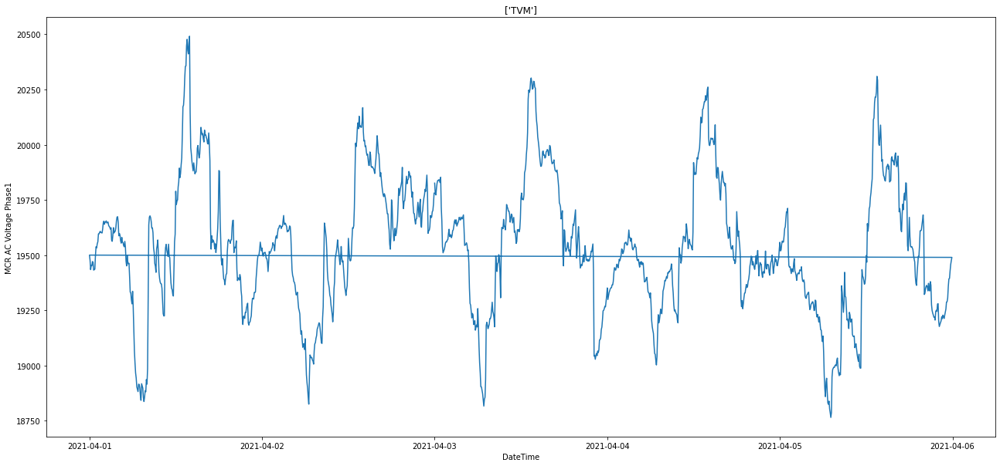

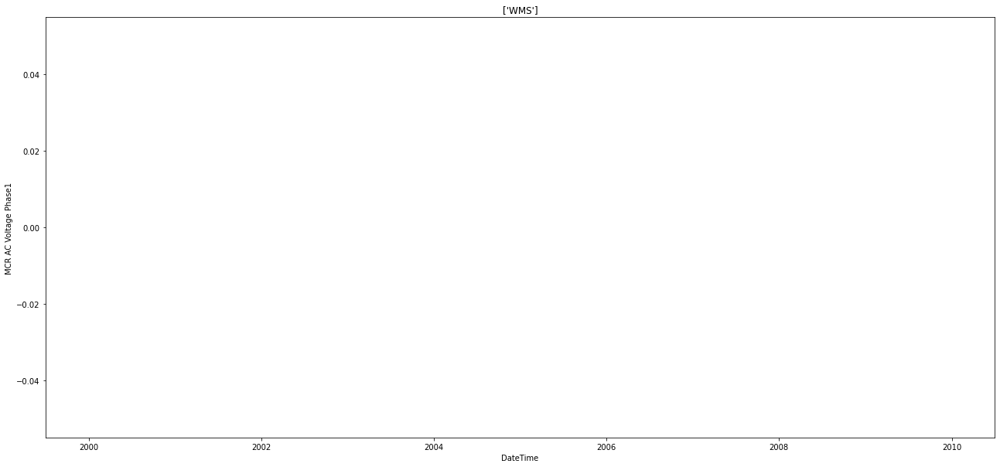

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['MCR AC Voltage Phase1'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('MCR AC Voltage Phase1')
  plt.show()

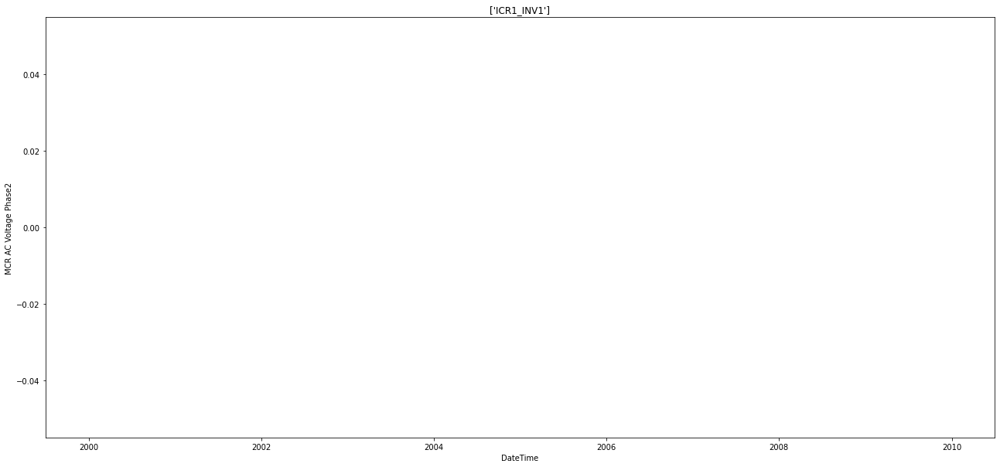

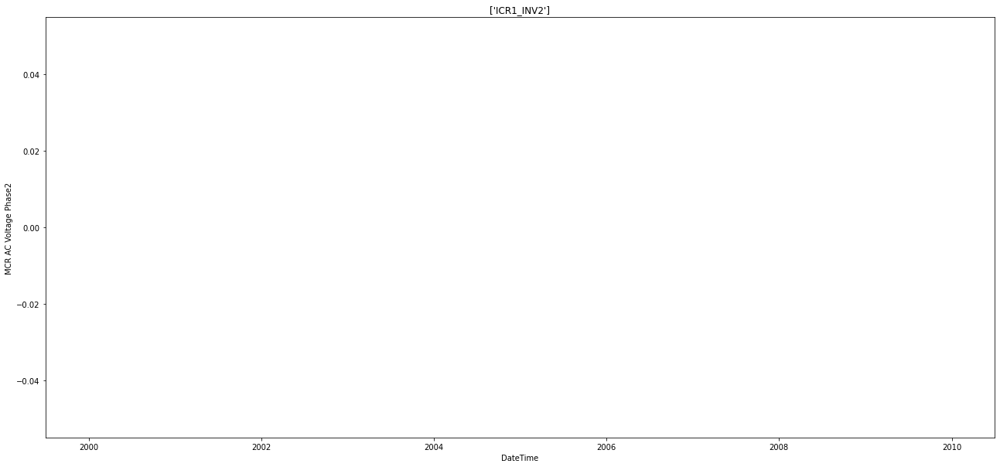

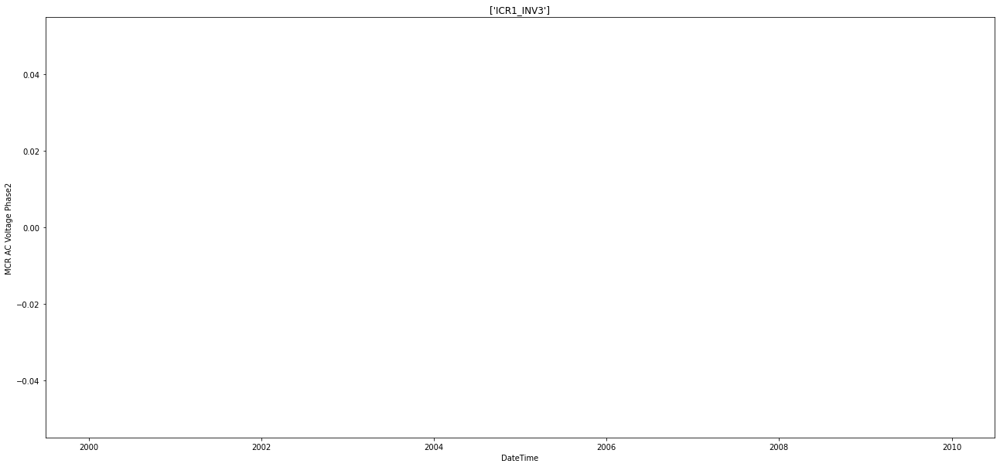

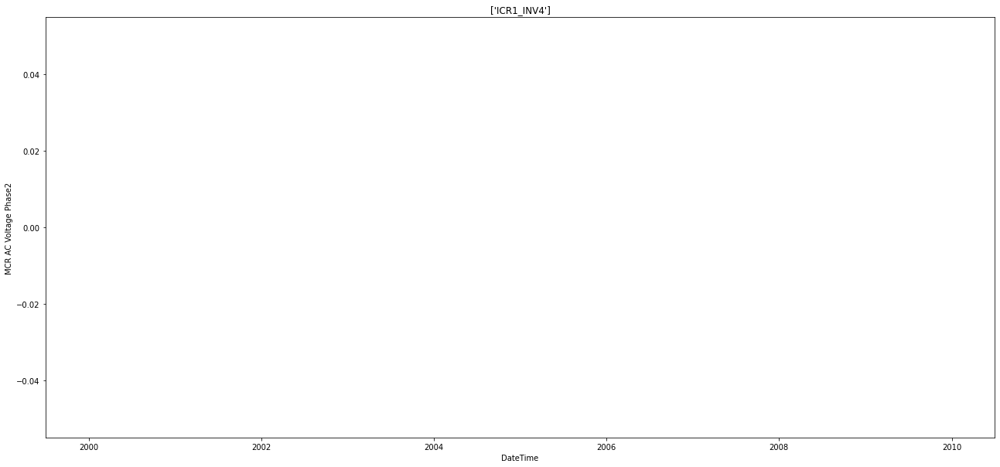

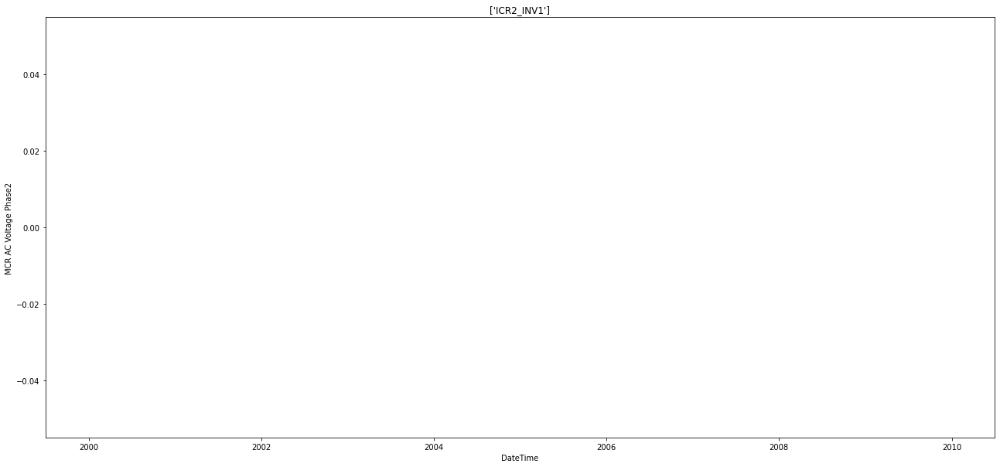

...

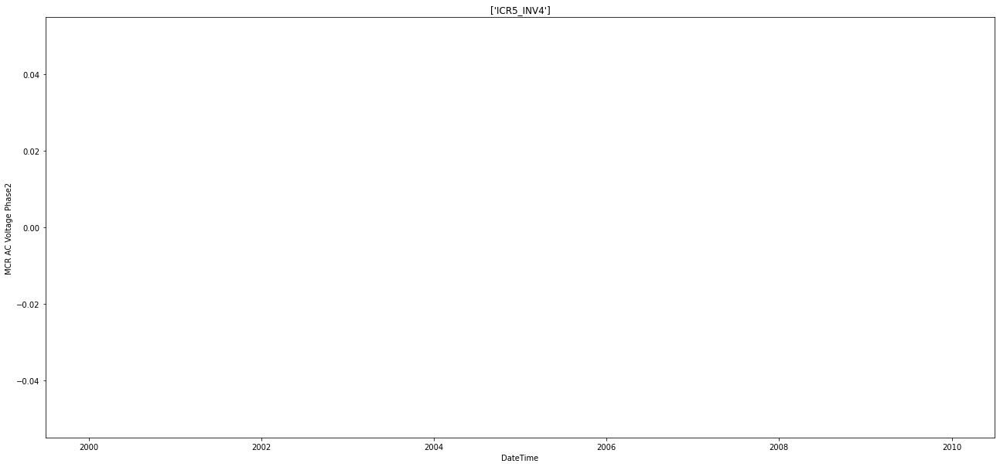

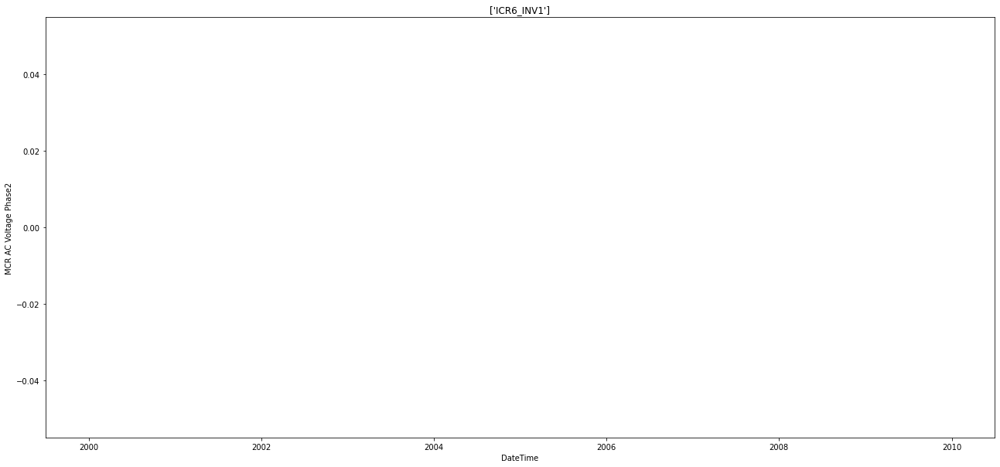

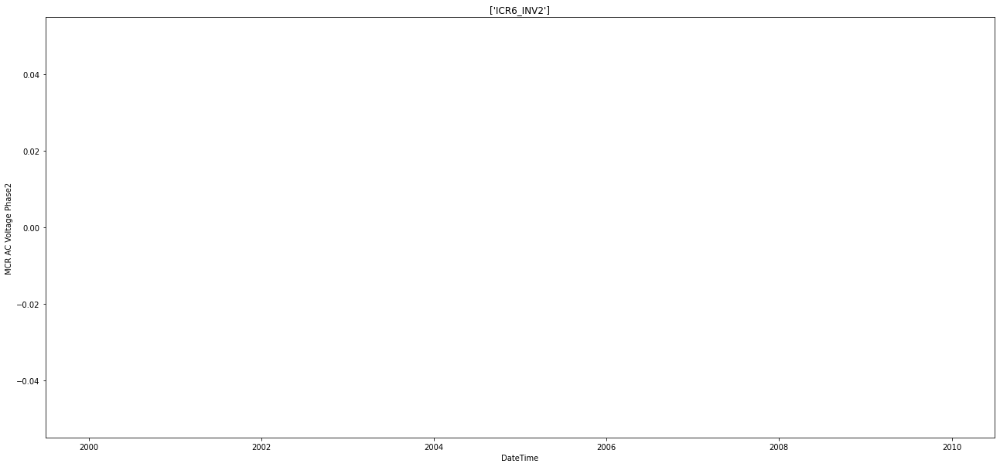

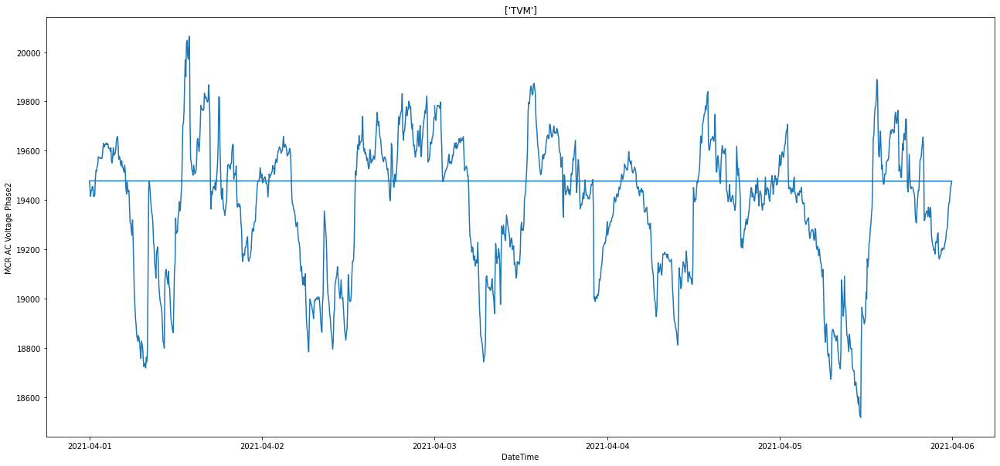

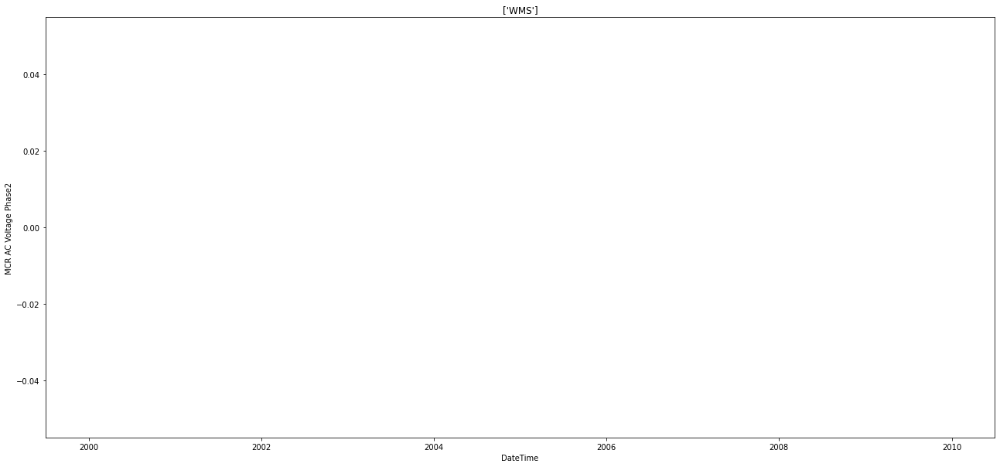

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['MCR AC Voltage Phase2'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('MCR AC Voltage Phase2')
  plt.show()

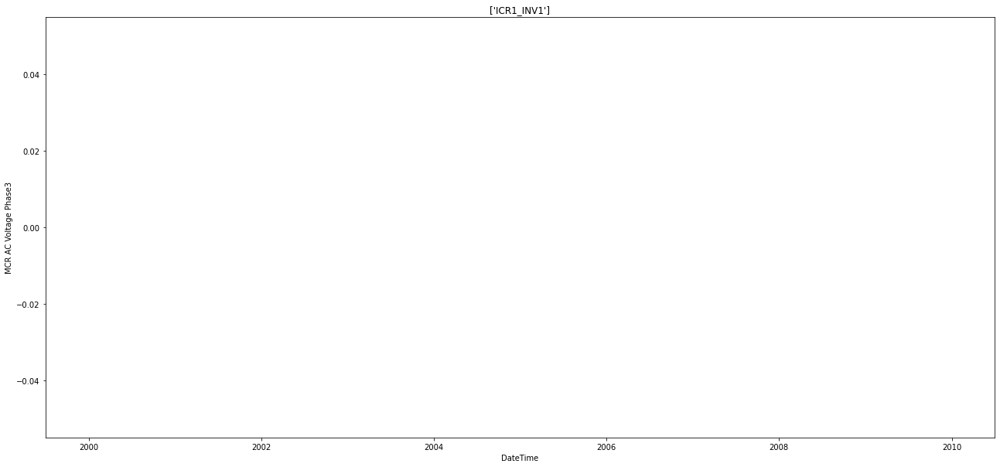

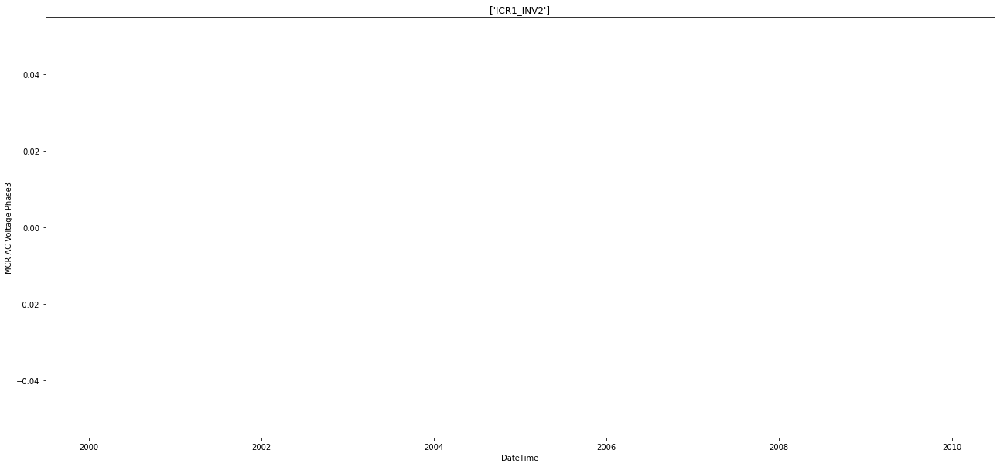

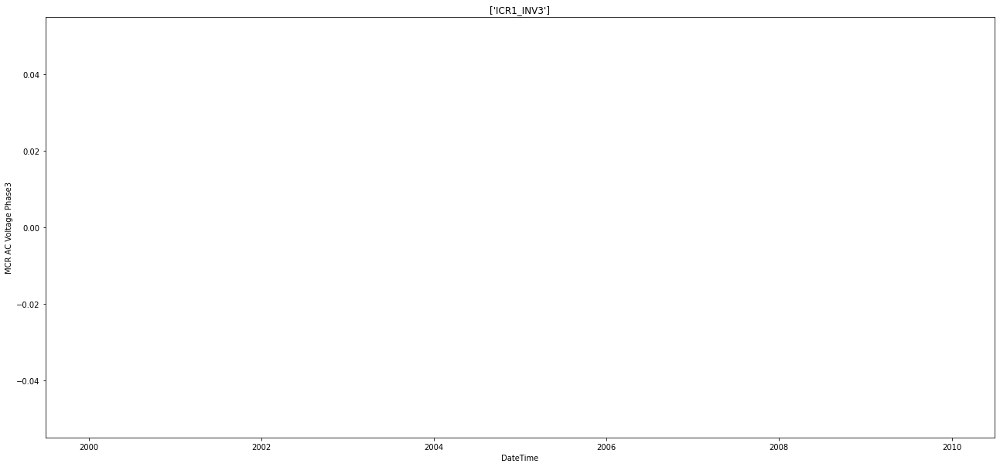

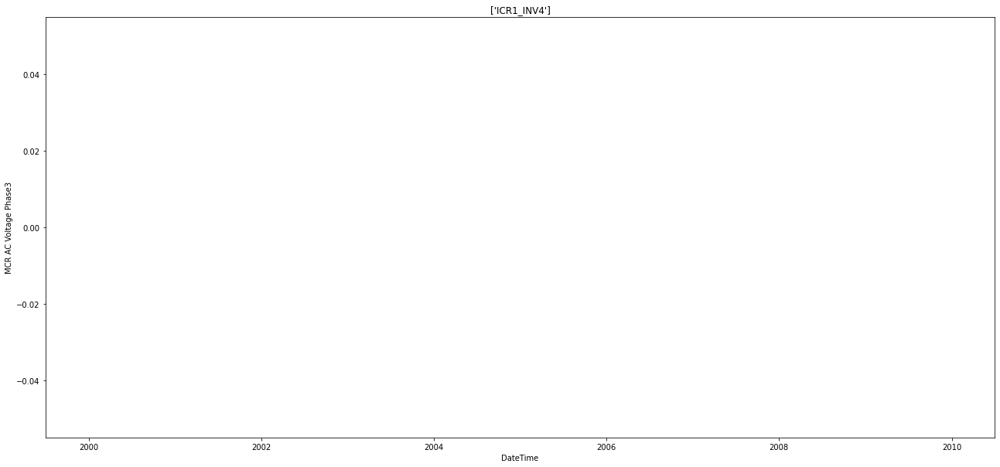

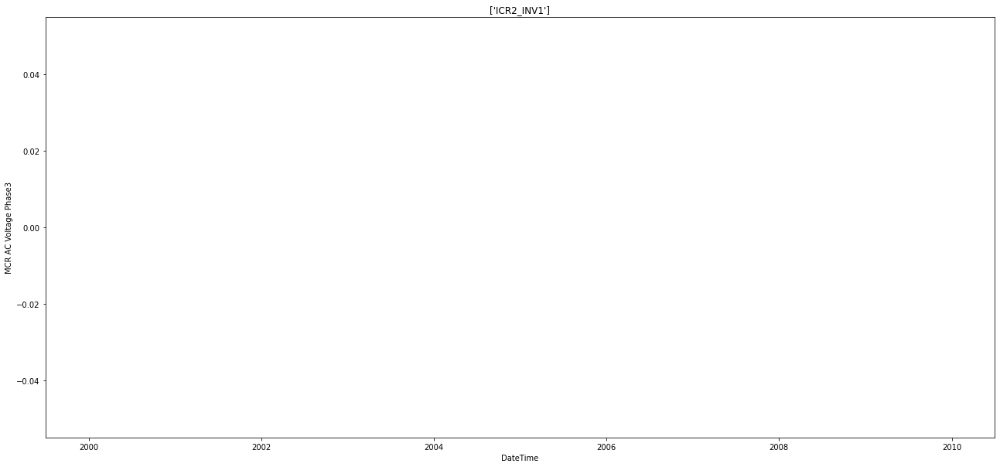

...

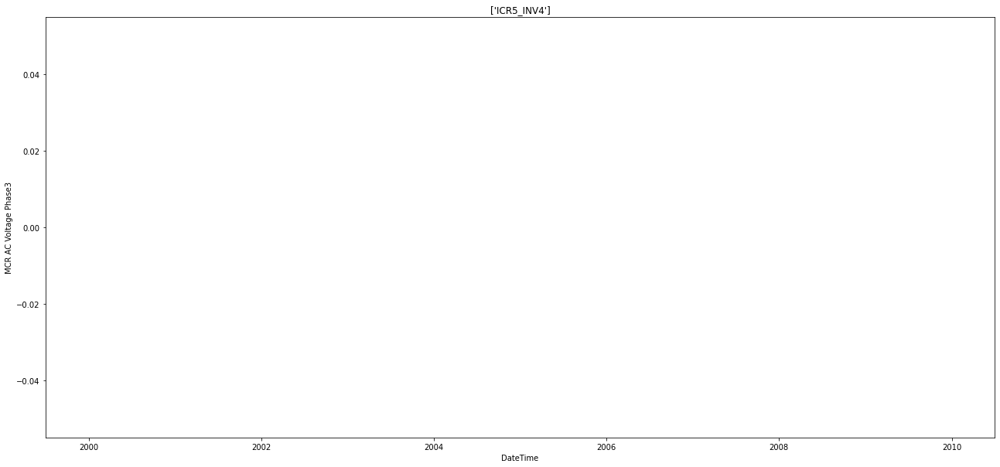

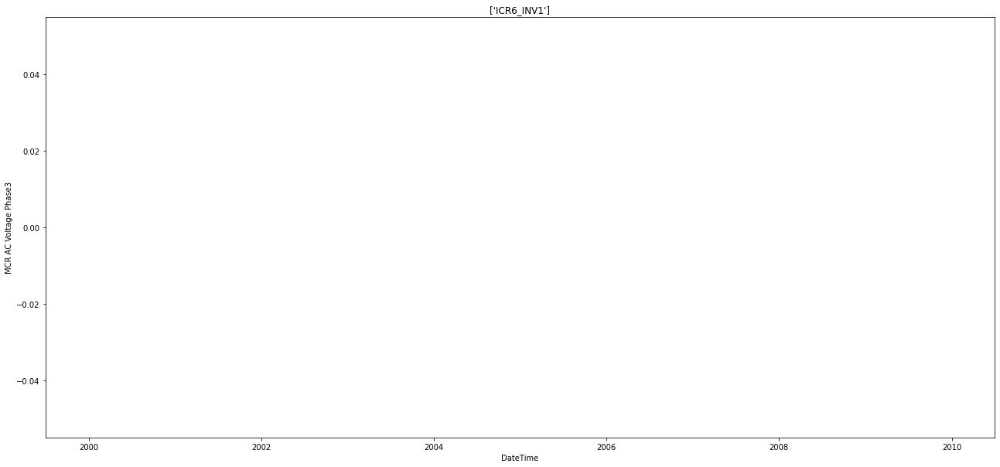

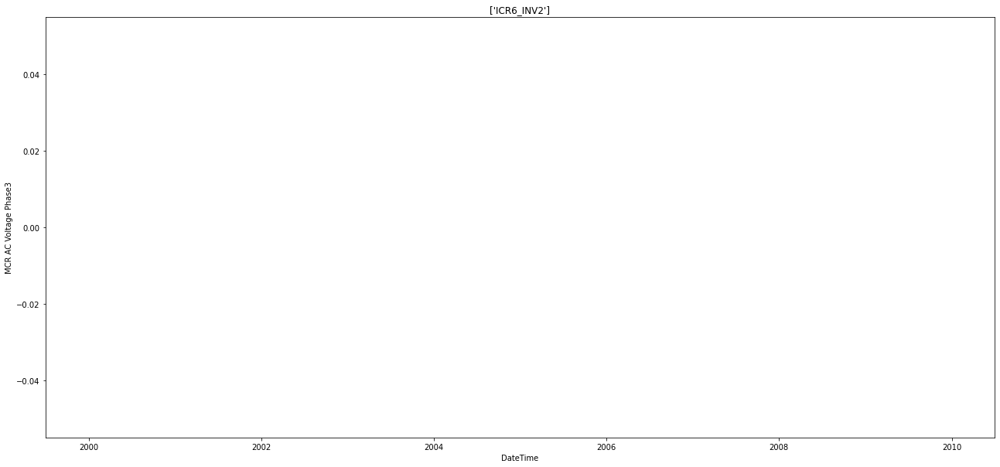

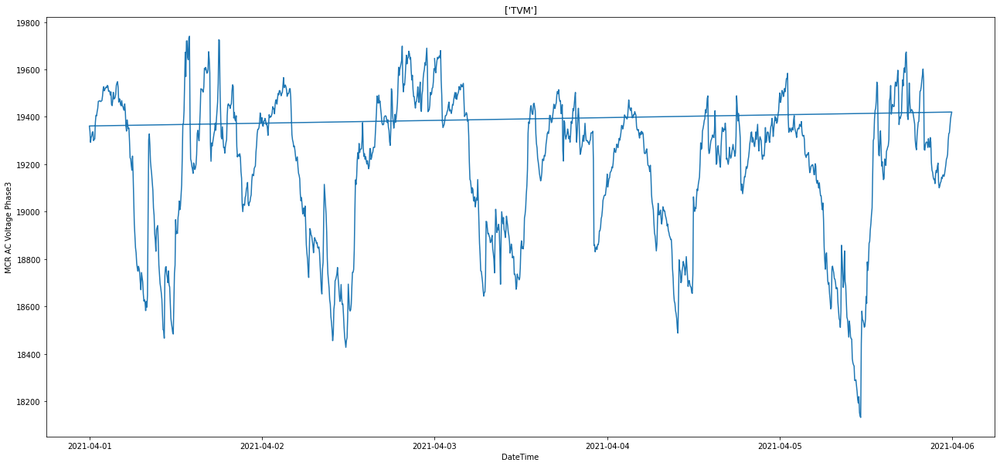

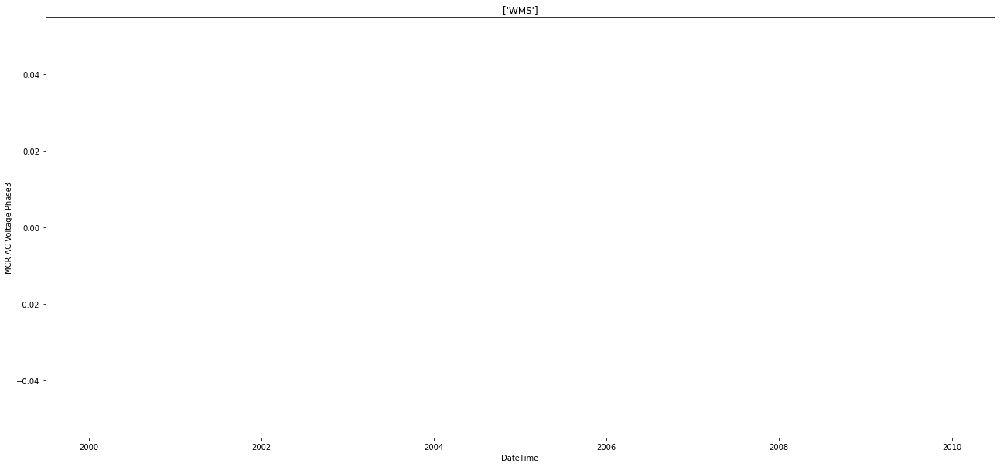

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['MCR AC Voltage Phase3'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('MCR AC Voltage Phase3')
  plt.show()

# Conclusion: DateTime vs Voltage for various AssetNames
Similar to current we can take one of the 22 ICR_INV and one of the 3 phase values and one of the 3 MCR voltage values which is being measured by TVM.

# **Analysis of MCR Export Power vs DateTime for different AssetName**

In [ ]:
df.head()

,Date_Time,AssetName,AC Power,DC Power,AC Current Phase12,AC Current Phase23,AC Current Phase31,AC voltage Phase12,AC voltage Phase23,AC voltage Phase31,MCR Export Power,MCR AC Voltage Phase1,MCR AC Voltage Phase2,MCR AC Voltage Phase3,MCR AC Current Phase1,MCR AC Current Phase2,MCR AC Current Phase3,Ambient Temp,GHI,Module Temp,GTI
20736,2021-04-01,ICR1_INV1,0.0,0.0,1.0,4.0,2.0,643.0,639.0,639.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
26208,2021-04-01,ICR5_INV4,0.0,0.0,1.0,2.0,1.0,640.0,637.0,639.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
21312,2021-04-01,ICR1_INV3,0.0,0.0,2.0,3.0,1.0,654.0,648.0,652.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
24480,2021-04-01,ICR4_INV2,0.0,0.0,1.0,1.0,1.0,644.0,636.0,636.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
22752,2021-04-01,ICR2_INV4,0.0,0.0,2.0,3.0,2.0,642.0,635.0,639.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


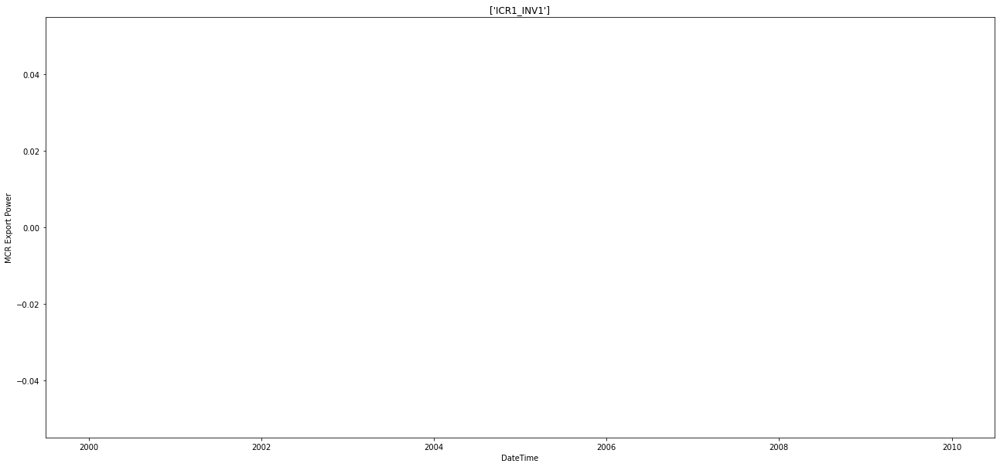

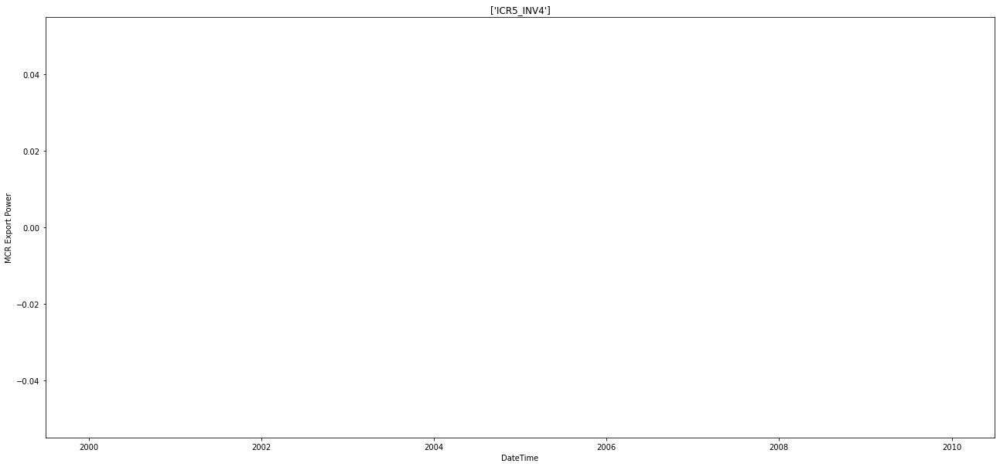

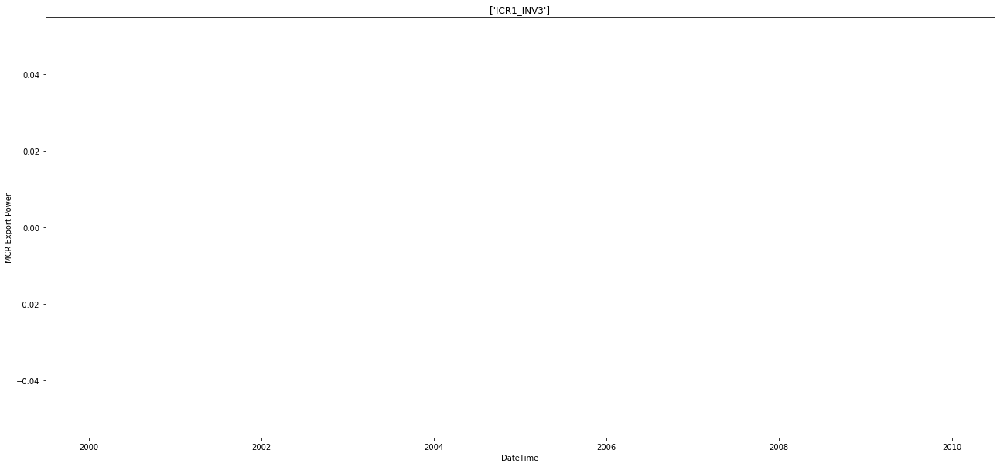

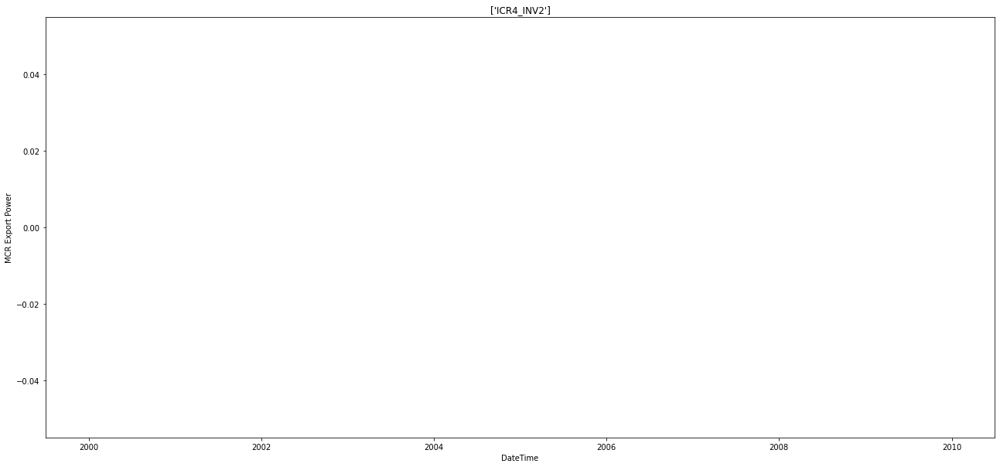

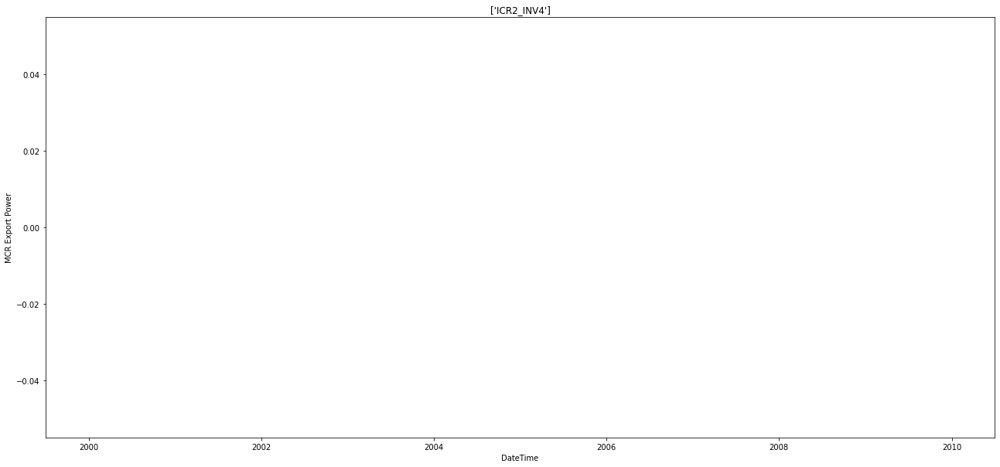

...

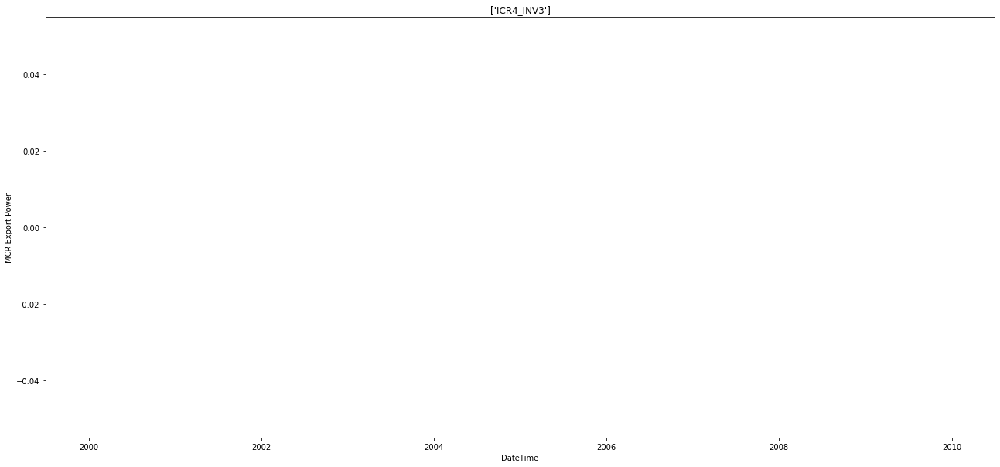

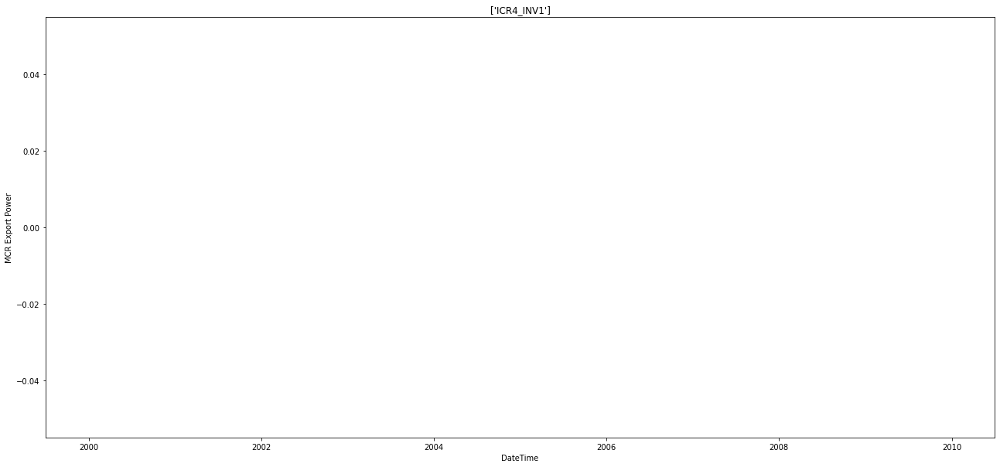

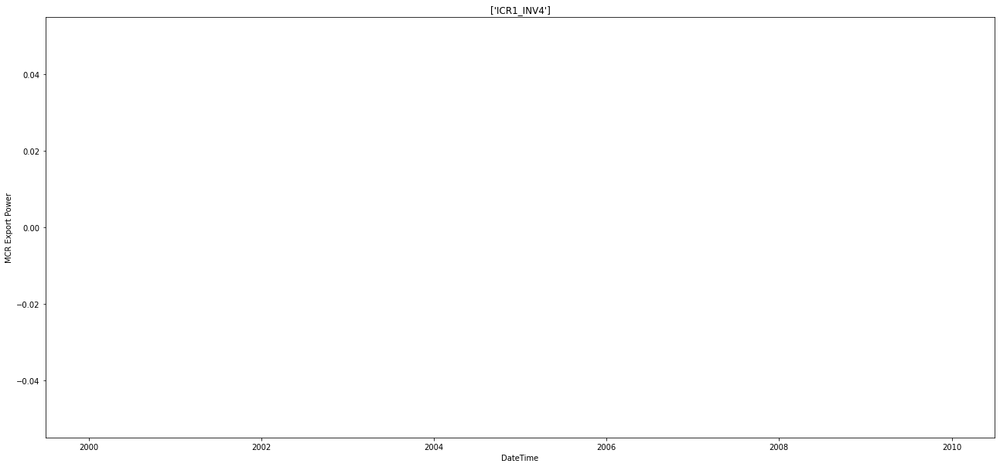

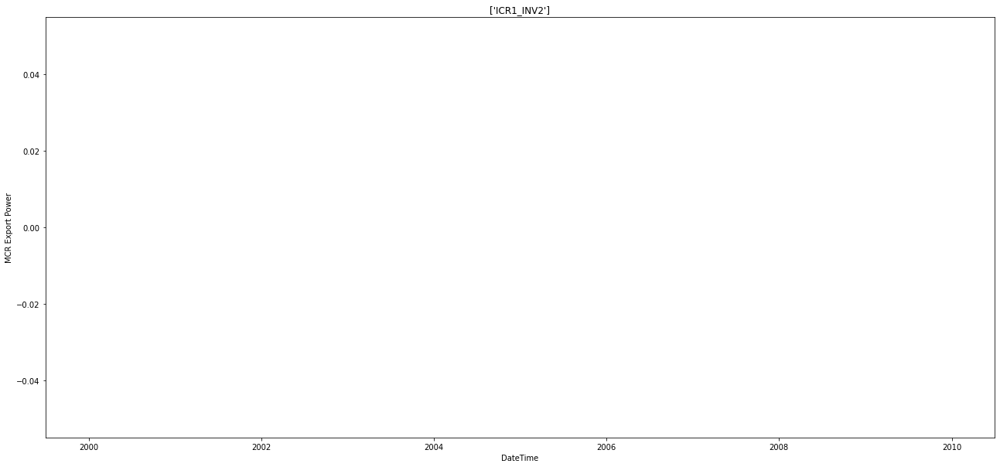

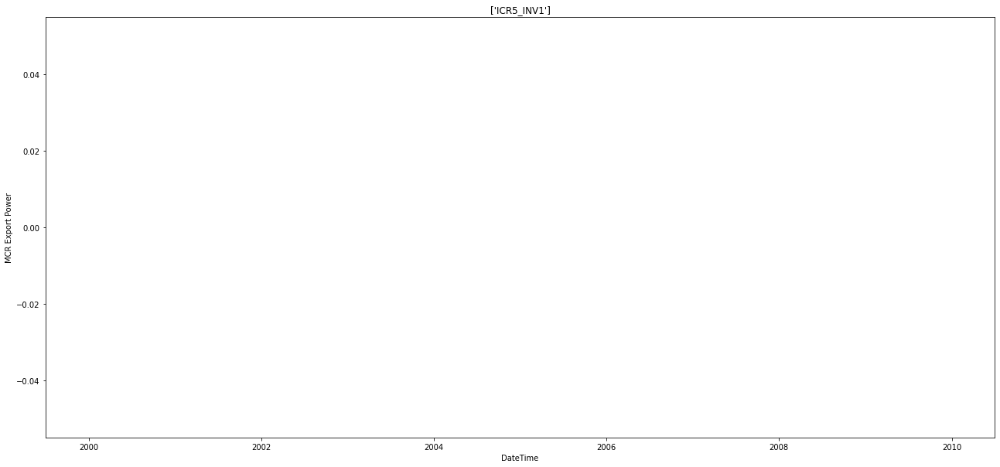

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['MCR Export Power'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('MCR Export Power')
  plt.show()

# Conclusion: MCR Export Power vs DateTime for different AssetName

The AssetName TVM captures the MCR Export Power, we won't be using it as output or input either.

# **We'll create a new df with the features and columns in the way we want - PREPROCESSING**
The first step is to remove the 22 ICR_INV values with a single value and keep the TVM and WMS values. We'll also need to mean the different phase values. So we'll have the columns DateTime, AssetName(ICR_INV, WMS, TVM), DC Power(avg. of 22 values at each time instance), AC Phase values, MCR values, Amb Temp, Mod temp, GHI, GTI. 

In [ ]:
datetime = df['Date_Time'].unique()
datetime.sort()
datetime

array(['2021-04-01T00:00:00.000000000', '2021-04-01T00:05:00.000000000',
       '2021-04-01T00:10:00.000000000', ...,
       '2021-04-05T23:45:00.000000000', '2021-04-05T23:50:00.000000000',
       '2021-04-05T23:55:00.000000000'], dtype='datetime64[ns]')

In [ ]:
import numpy as np

dc_power = []
ac_curr_phase1 = []
ac_curr_phase2 = []
ac_curr_phase3 = []
amb_temp = []
ghi = []
mod_temp = []
gti = []
for date in datetime:
  #for asset in assetnames:
  val_dc = df[df['Date_Time'] == date]
  dc_power = np.append(dc_power, val_dc['DC Power'].sum(skipna=True))
  ac_curr_phase1 = np.append(ac_curr_phase1, val_dc['AC Current Phase12'].sum(skipna=True))
  ac_curr_phase2 = np.append(ac_curr_phase2, val_dc['AC Current Phase23'].sum(skipna=True))
  ac_curr_phase3 = np.append(ac_curr_phase3, val_dc['AC Current Phase31'].sum(skipna=True))
  amb_temp = np.append(amb_temp, val_dc['Ambient Temp'].sum(skipna=True))
  ghi = np.append(ghi, val_dc['GHI'].sum(skipna=True))
  mod_temp = np.append(mod_temp, val_dc['Module Temp'].sum(skipna=True))
  gti = np.append(gti, val_dc['GTI'].sum(skipna=True))
  
dc_power = dc_power/22
ac_curr_phase1 = ac_curr_phase1/22
ac_curr_phase2 = ac_curr_phase2/22
ac_curr_phase3 = ac_curr_phase3/22

In [ ]:
df_new = pd.DataFrame(datetime)
df_new['DateTime'] = pd.DataFrame(datetime)
df_new['Ambient Temp'] = pd.DataFrame(amb_temp)
df_new['Module Temp'] = pd.DataFrame(mod_temp)
df_new['GHI'] = pd.DataFrame(ghi)
df_new['GTI'] = pd.DataFrame(gti)
df_new['DC Power'] = pd.DataFrame(dc_power)
df_new.drop(df_new.columns[[0]], axis=1,inplace=True)
df_new.sort_values(by='DateTime')
df_new

,DateTime,Ambient Temp,Module Temp,GHI,GTI,DC Power
0,2021-04-01 00:00:00,26.86938,26.38217,0.0,0.0,0.0
1,2021-04-01 00:05:00,26.82312,26.31899,0.0,0.0,0.0
2,2021-04-01 00:10:00,26.79777,26.25364,0.0,0.0,0.0
3,2021-04-01 00:15:00,26.75078,26.24046,0.0,0.0,0.0
4,2021-04-01 00:20:00,26.75905,26.19828,0.0,0.0,0.0
...,...,...,...,...,...,...
1435,2021-04-05 23:35:00,26.71674,25.73471,0.0,0.0,0.0
1436,2021-04-05 23:40:00,26.65835,25.61238,0.0,0.0,0.0
1437,2021-04-05 23:45:00,26.56718,25.57722,0.0,0.0,0.0
1438,2021-04-05 23:50:00,26.55491,25.61210,0.0,0.0,0.0


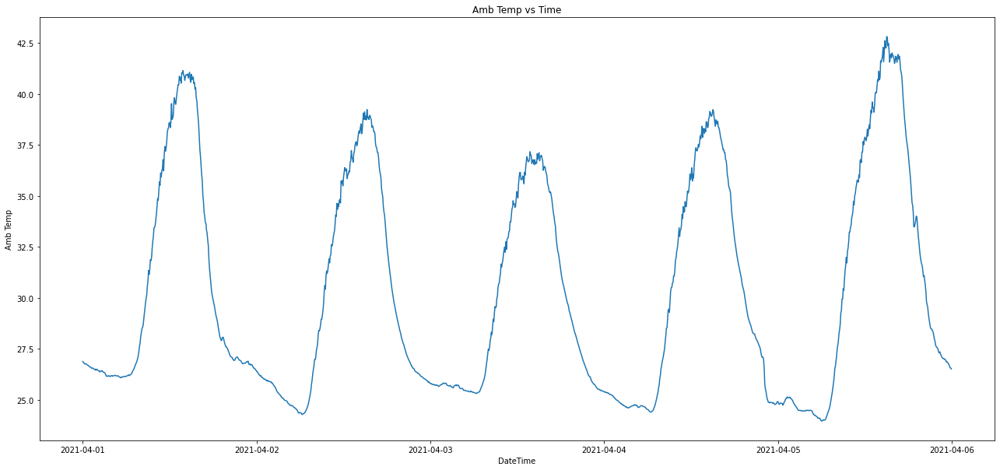

In [ ]:
plt.figure(figsize=(22,10))
plt.plot(df_new['DateTime'], df_new['Ambient Temp'])
plt.title('Amb Temp vs Time')
plt.xlabel('DateTime')
plt.ylabel('Amb Temp')
plt.show()

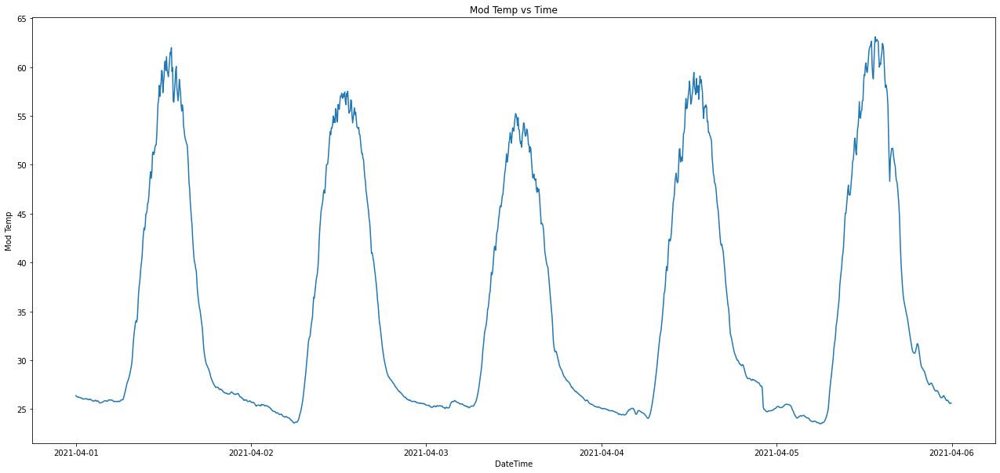

In [ ]:
plt.figure(figsize=(22,10))
plt.plot(df_new['DateTime'], df_new['Module Temp'])
plt.title('Mod Temp vs Time')
plt.xlabel('DateTime')
plt.ylabel('Mod Temp')
plt.show()

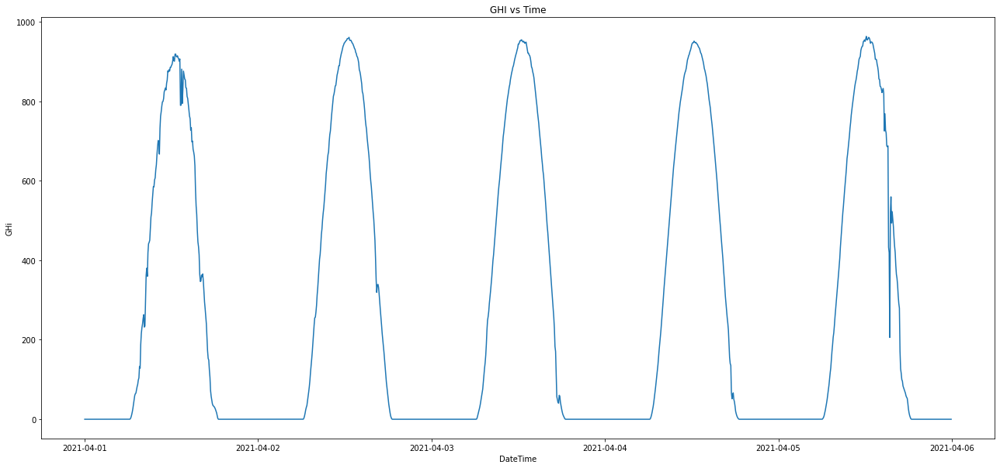

In [ ]:
plt.figure(figsize=(22,10))
plt.plot(df_new['DateTime'], df_new['GHI'])
plt.title('GHI vs Time')
plt.xlabel('DateTime')
plt.ylabel('GHi')
plt.show()

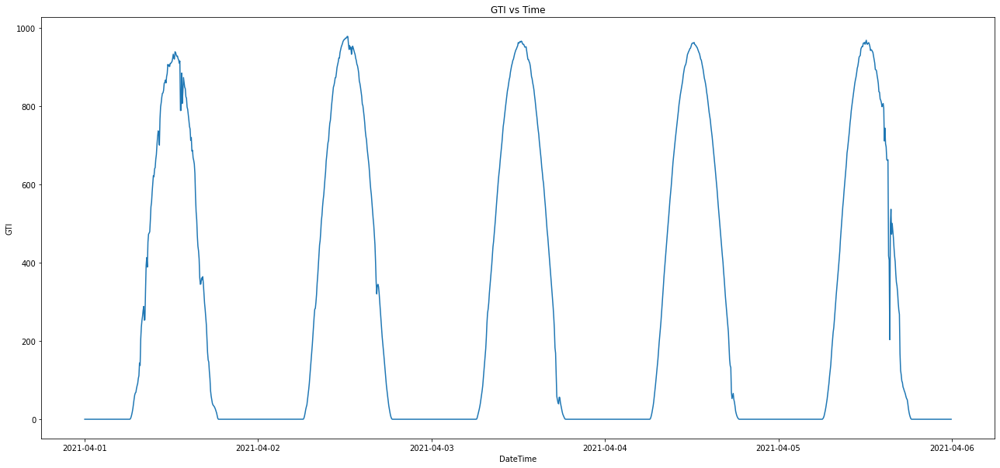

In [ ]:
plt.figure(figsize=(22,10))
plt.plot(df_new['DateTime'], df_new['GTI'])
plt.title('GTI vs Time')
plt.xlabel('DateTime')
plt.ylabel('GTI')
plt.show()

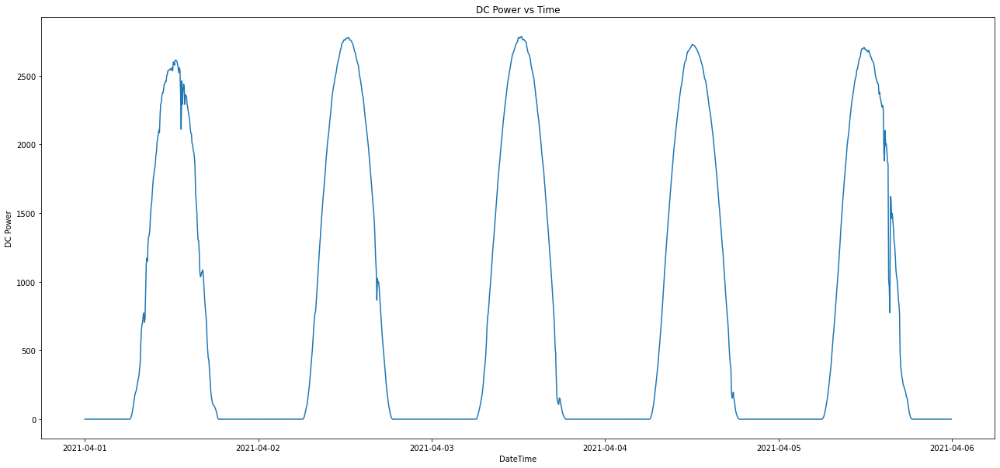

In [ ]:
plt.figure(figsize=(22,10))
plt.plot(df_new['DateTime'], df_new['DC Power'])
plt.title('DC Power vs Time')
plt.xlabel('DateTime')
plt.ylabel('DC Power')
plt.show()

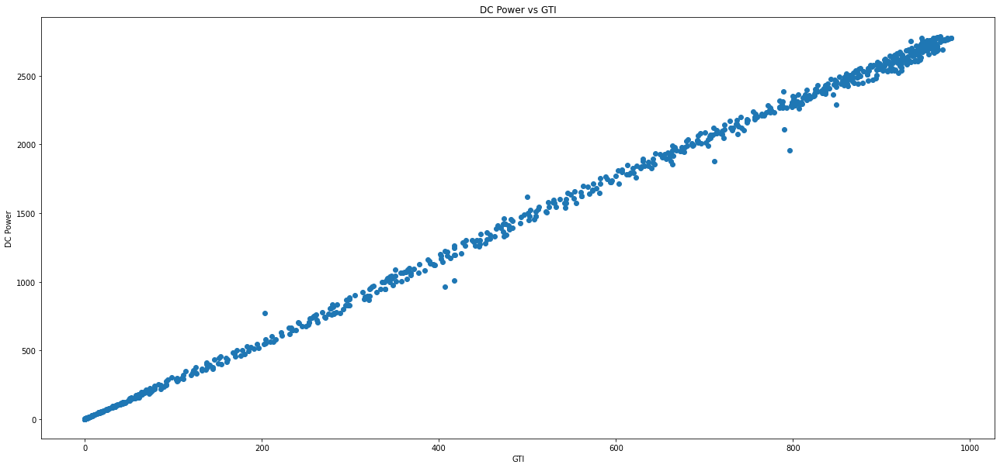

In [ ]:
plt.figure(figsize=(22,10))
plt.scatter(df_new['GTI'], df_new['DC Power'])
plt.title('DC Power vs GTI')
plt.xlabel('GTI')
plt.ylabel('DC Power')
plt.show()

# **Frequency Domain Analysis**
We'll work with df_new and look at the frequency domain decomposition for the same.

In [ ]:
import scipy as sp
import scipy.fftpack

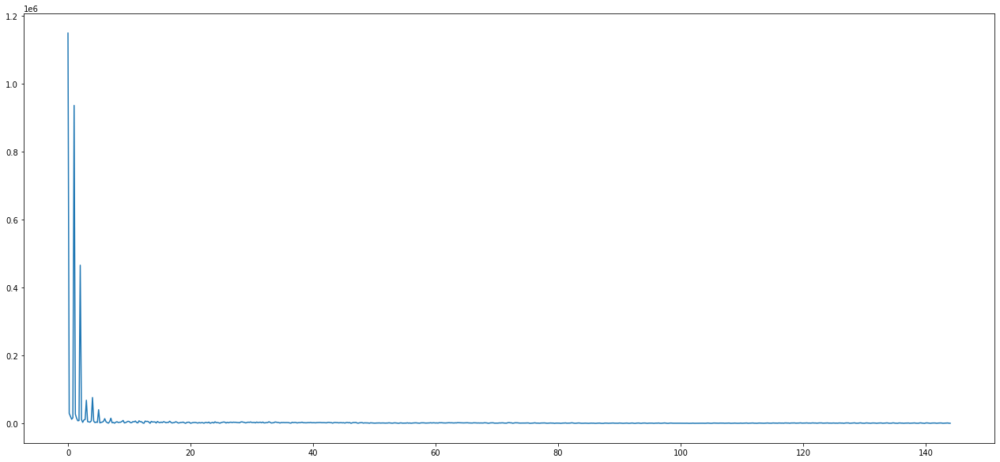

In [ ]:
from scipy.fft import rfft, rfftfreq

plt.figure(figsize=(22,10))
sample_rate = 288
duration = 5
N = int(sample_rate*duration)
yf = rfft((df_new['DC Power']).to_numpy())
xf = rfftfreq(N,1/sample_rate)
plt.plot(xf, np.abs(yf))

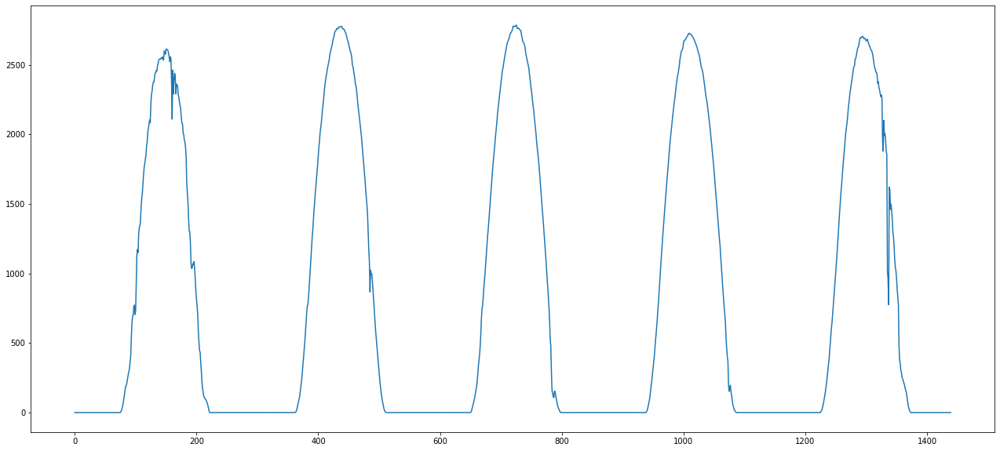

In [ ]:
from scipy.fft import irfft
plt.figure(figsize=(22,10))
new_signal = irfft(yf)
plt.plot(new_signal)

In [ ]:
#filtering the freq domain signal
# The maximum frequency is half the sample rate
points_per_freq = len(xf) / (sample_rate / 2)

# Our target frequency is  Hz
target_idx = int(points_per_freq * 3)

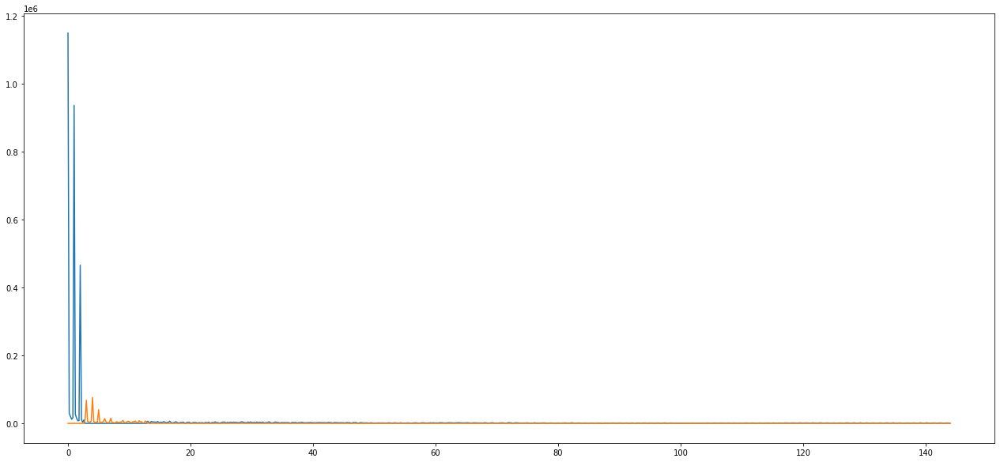

In [ ]:
yf_low = np.copy(yf)
yf_low[target_idx - 1 : target_idx + 50] = 0
yf_high = yf - yf_low
plt.figure(figsize=(22,10))
plt.plot(xf,np.abs(yf_low))
plt.plot(xf,np.abs(yf_high))

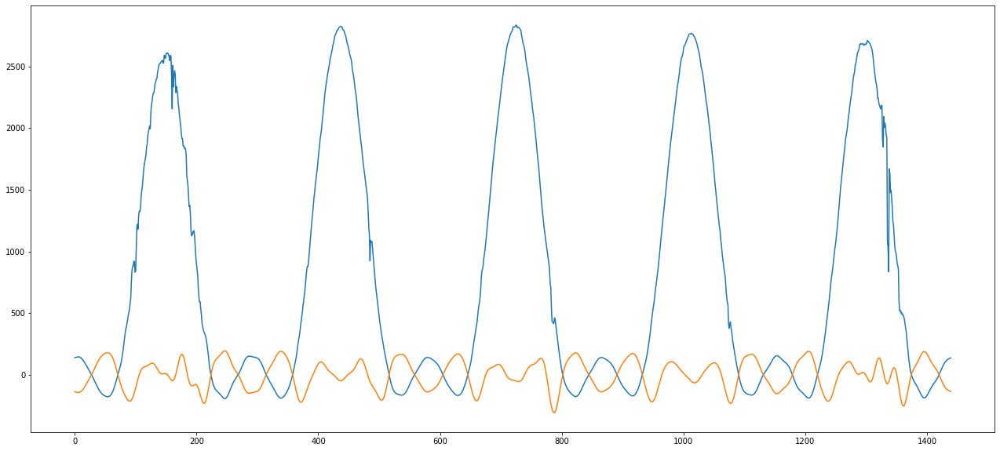

[[1.         0.99389449]
 [0.99389449 1.        ]]
[[1.         0.11033473]
 [0.11033473 1.        ]]
[[1. 1.]
 [1. 1.]]


In [ ]:

from scipy.fft import irfft

new_sig = irfft(yf)
new_sig_low = irfft(yf_low)
new_sig_high = irfft(yf_high)
plt.figure(figsize=(22,10))
plt.plot(new_sig_low)
plt.plot(new_sig_high)
#plt.plot(new_sig)
plt.show()
print(np.corrcoef(df_new['DC Power'], new_sig_low))
print(np.corrcoef(df_new['DC Power'], new_sig_high))
print(np.corrcoef(df_new['DC Power'], new_sig))

In [ ]:
 df_low = df_new.copy()
df_low['DC Power Low'] = new_sig_low
df_low.drop(['DC Power'], axis=1, inplace=True)
df_low

,DateTime,Ambient Temp,Module Temp,GHI,GTI,DC Power Low
0,2021-04-01 00:00:00,26.86938,26.38217,0.0,0.0,137.826374
1,2021-04-01 00:05:00,26.82312,26.31899,0.0,0.0,139.592147
2,2021-04-01 00:10:00,26.79777,26.25364,0.0,0.0,141.209075
3,2021-04-01 00:15:00,26.75078,26.24046,0.0,0.0,142.602511
4,2021-04-01 00:20:00,26.75905,26.19828,0.0,0.0,143.672026
...,...,...,...,...,...,...
1435,2021-04-05 23:35:00,26.71674,25.73471,0.0,0.0,126.892944
1436,2021-04-05 23:40:00,26.65835,25.61238,0.0,0.0,129.534151
1437,2021-04-05 23:45:00,26.56718,25.57722,0.0,0.0,131.860868
1438,2021-04-05 23:50:00,26.55491,25.61210,0.0,0.0,133.976511


In [ ]:
df_high = df_new.copy()
df_high['DC Power High'] = new_sig_high
df_high.drop(['DC Power'], axis=1, inplace=True)
df_high

,DateTime,Ambient Temp,Module Temp,GHI,GTI,DC Power High
0,2021-04-01 00:00:00,26.86938,26.38217,0.0,0.0,-137.826374
1,2021-04-01 00:05:00,26.82312,26.31899,0.0,0.0,-139.592147
2,2021-04-01 00:10:00,26.79777,26.25364,0.0,0.0,-141.209075
3,2021-04-01 00:15:00,26.75078,26.24046,0.0,0.0,-142.602511
4,2021-04-01 00:20:00,26.75905,26.19828,0.0,0.0,-143.672026
...,...,...,...,...,...,...
1435,2021-04-05 23:35:00,26.71674,25.73471,0.0,0.0,-126.892944
1436,2021-04-05 23:40:00,26.65835,25.61238,0.0,0.0,-129.534151
1437,2021-04-05 23:45:00,26.56718,25.57722,0.0,0.0,-131.860868
1438,2021-04-05 23:50:00,26.55491,25.61210,0.0,0.0,-133.976511


# LSTM models for the different dfs

In [ ]:
from sklearn.model_selection import train_test_split
from keras.preprocessing.sequence import TimeseriesGenerator
from sklearn.preprocessing import MinMaxScaler, StandardScaler
import tensorflow as tf


In [ ]:
df_low.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1440 entries, 0 to 1439
Data columns (total 6 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   DateTime      1440 non-null   datetime64[ns]
 1   Ambient Temp  1440 non-null   float64       
 2   Module Temp   1440 non-null   float64       
 3   GHI           1440 non-null   float64       
 4   GTI           1440 non-null   float64       
 5   DC Power Low  1440 non-null   float64       
dtypes: datetime64[ns](1), float64(5)
memory usage: 67.6 KB


In [ ]:
df_low.set_index('DateTime')[['Ambient Temp', 'Module Temp', 'GHI', 'GTI', 'DC Power Low']]
df_high.set_index('DateTime')[['Ambient Temp', 'Module Temp', 'GHI', 'GTI', 'DC Power High']]
df_low.head(15)

,DateTime,Ambient Temp,Module Temp,GHI,GTI,DC Power Low
0,2021-04-01 00:00:00,26.86938,26.38217,0.0,0.0,137.826374
1,2021-04-01 00:05:00,26.82312,26.31899,0.0,0.0,139.592147
2,2021-04-01 00:10:00,26.79777,26.25364,0.0,0.0,141.209075
3,2021-04-01 00:15:00,26.75078,26.24046,0.0,0.0,142.602511
4,2021-04-01 00:20:00,26.75905,26.19828,0.0,0.0,143.672026
5,2021-04-01 00:25:00,26.76456,26.21607,0.0,0.0,144.300855
6,2021-04-01 00:30:00,26.74050,26.18422,0.0,0.0,144.366571
7,2021-04-01 00:35:00,26.70856,26.16648,0.0,0.0,143.752023
8,2021-04-01 00:40:00,26.68699,26.14815,0.0,0.0,142.355616
9,2021-04-01 00:45:00,26.68508,26.12650,0.0,0.0,140.100072


In [ ]:
df_low_input = df_low[['Ambient Temp', 'Module Temp', 'GHI', 'GTI', 'DC Power Low']]
df_high_input = df_high[['Ambient Temp', 'Module Temp', 'GHI', 'GTI', 'DC Power High']]

In [ ]:
scaler_low = MinMaxScaler()
scaler_high = MinMaxScaler()
df_low_scaled = scaler_low.fit_transform(df_low_input)
df_high_scaled = scaler_high.fit_transform(df_high_input) 

In [ ]:
df_low_scaled

array([[0.15486234, 0.07287907, 0.        , 0.        , 0.10935384],
       [0.15241102, 0.07128394, 0.        , 0.        , 0.10993657],
       [0.15106772, 0.06963402, 0.        , 0.        , 0.11047018],
       ...,
       [0.13884875, 0.0525562 , 0.        , 0.        , 0.10738515],
       [0.13819856, 0.05343682, 0.        , 0.        , 0.10808334],
       [0.13553051, 0.05336133, 0.        , 0.        , 0.10873569]])

In [ ]:
features_low = df_low_scaled
features_high = df_high_scaled
target_low = df_low_scaled[:,4]
target_high = df_high_scaled[:,4]

In [ ]:
x_train_low, x_test_low, y_train_low, y_test_low = train_test_split(features_low, target_low, test_size=0.20, random_state=123, shuffle=False)
x_train_high, x_test_high, y_train_high, y_test_high = train_test_split(features_high, target_high, test_size=0.20, random_state=123, shuffle=False)

In [ ]:
x_train_low.shape

(1152, 5)

In [ ]:
x_test_low.shape

(288, 5)

In [ ]:
wind_length = 9
batch_size = 32
num_features = 5
train_generator_low = TimeseriesGenerator(x_train_low, y_train_low, length = wind_length, sampling_rate=1, batch_size=batch_size)
test_generator_low = TimeseriesGenerator(x_test_low, y_test_low, length = wind_length, sampling_rate=1, batch_size=batch_size)
train_generator_high = TimeseriesGenerator(x_train_high, y_train_high, length = wind_length, sampling_rate=1, batch_size=batch_size)
test_generator_high = TimeseriesGenerator(x_test_high, y_test_high, length = wind_length, sampling_rate=1, batch_size=batch_size)

# **Low Frequency Domain model**

In [ ]:
model_low = tf.keras.Sequential()
model_low.add(tf.keras.layers.LSTM(128, input_shape=(wind_length, num_features), return_sequences=True))
model_low.add(tf.keras.layers.LeakyReLU(alpha=0.5))
model_low.add(tf.keras.layers.LSTM(128, return_sequences=True))
model_low.add(tf.keras.layers.LeakyReLU(alpha=0.5))
model_low.add(tf.keras.layers.Dropout(0.3))
model_low.add(tf.keras.layers.LSTM(64, return_sequences=False))
model_low.add(tf.keras.layers.Dropout(0.3))
model_low.add(tf.keras.layers.Dense(1))

In [ ]:
model_low.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_2 (LSTM)                (None, 9, 128)            68608     
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 9, 128)            0         
_________________________________________________________________
lstm_3 (LSTM)                (None, 9, 128)            131584    
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 9, 128)            0         
_________________________________________________________________
dropout (Dropout)            (None, 9, 128)            0         
_________________________________________________________________
lstm_4 (LSTM)                (None, 64)                49408     
_________________________________________________________________
dropout_1 (Dropout)          (None, 64)               

In [ ]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                                  patience=5,
                                                  mode='min')
model_low.compile(loss=tf.losses.MeanSquaredError(),
              optimizer=tf.optimizers.Adam(),
              metrics=[tf.metrics.MeanAbsoluteError()])
history = model_low.fit(train_generator_low, epochs=50,
                        validation_data=test_generator_low,
                        shuffle=False,
                        callbacks=[early_stopping])

Epoch 1/50
36/36 [==============================] - 8s 85ms/step - loss: 0.0164 - mean_absolute_error: 0.0819 - val_loss: 0.0101 - val_mean_absolute_error: 0.0743
Epoch 2/50
36/36 [==============================] - 1s 40ms/step - loss: 0.0067 - mean_absolute_error: 0.0569 - val_loss: 0.0035 - val_mean_absolute_error: 0.0442
Epoch 3/50
36/36 [==============================] - 1s 39ms/step - loss: 0.0035 - mean_absolute_error: 0.0418 - val_loss: 0.0029 - val_mean_absolute_error: 0.0396
Epoch 4/50
36/36 [==============================] - 1s 39ms/step - loss: 0.0061 - mean_absolute_error: 0.0538 - val_loss: 0.0059 - val_mean_absolute_error: 0.0616
Epoch 5/50
36/36 [==============================] - 1s 39ms/step - loss: 0.0064 - mean_absolute_error: 0.0569 - val_loss: 0.0029 - val_mean_absolute_error: 0.0406
Epoch 6/50
36/36 [==============================] - 1s 38ms/step - loss: 0.0048 - mean_absolute_error: 0.0459 - val_loss: 0.0033 - val_mean_absolute_error: 0.0444
Epoch 7/50
36/36 [====

In [ ]:
model_low.evaluate(test_generator_low, verbose=0)

[0.004700685851275921, 0.052414942532777786]

In [ ]:
predictions_low = model_low.predict(test_generator_low)

In [ ]:
predictions_low.shape

(279, 1)

In [ ]:
predictions_low

array([[ 1.00605339e-01],
       [ 9.99861583e-02],
       [ 9.90931541e-02],
       [ 9.80183929e-02],
       [ 9.68715101e-02],
       [ 9.56623703e-02],
       [ 9.43396389e-02],
       [ 9.29363072e-02],
       [ 9.14805904e-02],
       [ 8.99278820e-02],
       [ 8.84390324e-02],
       [ 8.70558769e-02],
       [ 8.56813192e-02],
       [ 8.43070596e-02],
       [ 8.28803852e-02],
       [ 8.13028216e-02],
       [ 7.96138495e-02],
       [ 7.76770636e-02],
       [ 7.54698068e-02],
       [ 7.30180144e-02],
       [ 7.03633130e-02],
       [ 6.74857795e-02],
       [ 6.43829182e-02],
       [ 6.11459687e-02],
       [ 5.78413121e-02],
       [ 5.45238107e-02],
       [ 5.12451902e-02],
       [ 4.81255241e-02],
       [ 4.51840498e-02],
       [ 4.24556807e-02],
       [ 3.99588495e-02],
       [ 3.77004407e-02],
       [ 3.56705338e-02],
       [ 3.38273719e-02],
       [ 3.21561098e-02],
       [ 3.06256190e-02],
       [ 2.92362198e-02],
       [ 2.79382914e-02],
       [ 2.6

In [ ]:
x_test_low[:,1:][wind_length:]

array([[0.04225527, 0.        , 0.        , 0.10566715],
       [0.04329975, 0.        , 0.        , 0.10403506],
       [0.04460908, 0.        , 0.        , 0.10247151],
       ...,
       [0.0525562 , 0.        , 0.        , 0.10738515],
       [0.05343682, 0.        , 0.        , 0.10808334],
       [0.05336133, 0.        , 0.        , 0.10873569]])

In [ ]:
x_test_low

array([[0.05016196, 0.0430806 , 0.        , 0.        , 0.11425598],
       [0.04557038, 0.04425082, 0.        , 0.        , 0.11462139],
       [0.04338136, 0.04480045, 0.        , 0.        , 0.11453207],
       ...,
       [0.13884875, 0.0525562 , 0.        , 0.        , 0.10738515],
       [0.13819856, 0.05343682, 0.        , 0.        , 0.10808334],
       [0.13553051, 0.05336133, 0.        , 0.        , 0.10873569]])

In [ ]:
df_low_pred = pd.concat([pd.DataFrame(x_test_low[:,1:][wind_length:]), pd.DataFrame(predictions_low)], axis=1)

In [ ]:
df_low_pred

,0,1,2,3,0
0,0.042255,0.0,0.0,0.105667,0.100605
1,0.043300,0.0,0.0,0.104035,0.099986
2,0.044609,0.0,0.0,0.102472,0.099093
3,0.046353,0.0,0.0,0.100992,0.098018
4,0.048223,0.0,0.0,0.099590,0.096872
...,...,...,...,...,...
274,0.056532,0.0,0.0,0.105746,0.073928
275,0.053444,0.0,0.0,0.106617,0.075498
276,0.052556,0.0,0.0,0.107385,0.076906
277,0.053437,0.0,0.0,0.108083,0.078140


In [ ]:
rev_trans_low=scaler_low.inverse_transform(df_low_pred)

In [ ]:
rev_trans_low

array([[ 24.74431901,  23.49557   ,   0.        , 103.43009232,
        111.31675848],
       [ 24.76402995,  23.49557   ,   0.        , 101.83255008,
        109.44052481],
       [ 24.78873891,  23.49557   ,   0.        , 100.30210752,
        106.73455358],
       ...,
       [ 24.93871267,  23.49557   ,   0.        , 105.11172163,
         39.50187994],
       [ 24.95533142,  23.49557   ,   0.        , 105.795129  ,
         43.24305895],
       [ 24.95390682,  23.49557   ,   0.        , 106.43366524,
         46.68010772]])

In [ ]:
df_low_final = df_low_input[predictions_low.shape[0]*-1:]

In [ ]:
df_low_final.count()

Ambient Temp    279
Module Temp     279
GHI             279
GTI             279
DC Power Low    279
dtype: int64

In [ ]:
df_low_final['DC Power Low Pred'] = rev_trans_low[:,4]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
df_low_final

,Ambient Temp,Module Temp,GHI,GTI,DC Power Low,DC Power Low Pred
1161,24.77210,25.16922,0.0,0.0,126.655002,111.316758
1162,24.86908,25.21059,0.0,0.0,121.709447,109.440525
1163,24.91127,25.26245,0.0,0.0,116.971613,106.734554
1164,24.98851,25.33153,0.0,0.0,112.487061,103.477825
1165,25.05391,25.40558,0.0,0.0,108.239951,100.002554
...,...,...,...,...,...,...
1435,26.71674,25.73471,0.0,0.0,126.892944,30.479997
1436,26.65835,25.61238,0.0,0.0,129.534151,35.237690
1437,26.56718,25.57722,0.0,0.0,131.860868,39.501880
1438,26.55491,25.61210,0.0,0.0,133.976511,43.243059


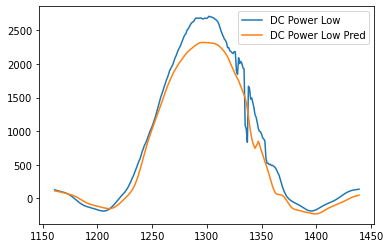

In [ ]:
df_low_final[['DC Power Low', 'DC Power Low Pred']].plot()

# **High Frequency domain model**

In [ ]:
model_high = tf.keras.Sequential()
model_high.add(tf.keras.layers.LSTM(128, input_shape=(wind_length, num_features), return_sequences=True))
model_high.add(tf.keras.layers.LeakyReLU(alpha=0.5))
model_high.add(tf.keras.layers.LSTM(128, return_sequences=True))
model_high.add(tf.keras.layers.LeakyReLU(alpha=0.5))
model_high.add(tf.keras.layers.Dropout(0.3))
model_high.add(tf.keras.layers.LSTM(64, return_sequences=False))
model_high.add(tf.keras.layers.Dropout(0.3))
model_high.add(tf.keras.layers.Dense(1))

In [ ]:
model_high.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_5 (LSTM)                (None, 9, 128)            68608     
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 9, 128)            0         
_________________________________________________________________
lstm_6 (LSTM)                (None, 9, 128)            131584    
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 9, 128)            0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 9, 128)            0         
_________________________________________________________________
lstm_7 (LSTM)                (None, 64)                49408     
_________________________________________________________________
dropout_3 (Dropout)          (None, 64)               

In [ ]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                                  patience=5,
                                                  mode='min')
model_high.compile(loss=tf.losses.MeanSquaredError(),
              optimizer=tf.optimizers.Adam(),
              metrics=[tf.metrics.MeanAbsoluteError()])
history = model_high.fit(train_generator_high, epochs=50,
                        validation_data=test_generator_high,
                        shuffle=False,
                        callbacks=[early_stopping])

Epoch 1/50
36/36 [==============================] - 8s 74ms/step - loss: 0.1923 - mean_absolute_error: 0.3665 - val_loss: 0.0390 - val_mean_absolute_error: 0.1637
Epoch 2/50
36/36 [==============================] - 1s 38ms/step - loss: 0.0335 - mean_absolute_error: 0.1502 - val_loss: 0.0225 - val_mean_absolute_error: 0.1242
Epoch 3/50
36/36 [==============================] - 1s 39ms/step - loss: 0.0245 - mean_absolute_error: 0.1290 - val_loss: 0.0195 - val_mean_absolute_error: 0.1181
Epoch 4/50
36/36 [==============================] - 1s 37ms/step - loss: 0.0221 - mean_absolute_error: 0.1221 - val_loss: 0.0190 - val_mean_absolute_error: 0.1152
Epoch 5/50
36/36 [==============================] - 1s 39ms/step - loss: 0.0207 - mean_absolute_error: 0.1173 - val_loss: 0.0175 - val_mean_absolute_error: 0.1116
Epoch 6/50
36/36 [==============================] - 1s 39ms/step - loss: 0.0196 - mean_absolute_error: 0.1149 - val_loss: 0.0164 - val_mean_absolute_error: 0.1077
Epoch 7/50
36/36 [====

In [ ]:
model_high.evaluate(test_generator_high, verbose=0)

[0.001061533228494227, 0.02185884676873684]

In [ ]:
predictions_high = model_low.predict(test_generator_high)

In [ ]:
predictions_high

array([[0.25569674],
       [0.259308  ],
       [0.26356775],
       [0.26832163],
       [0.27345023],
       [0.27870923],
       [0.28378785],
       [0.28858605],
       [0.29305092],
       [0.2970402 ],
       [0.30097872],
       [0.30510107],
       [0.30940455],
       [0.31415206],
       [0.31949824],
       [0.32547367],
       [0.33245045],
       [0.34027687],
       [0.3489904 ],
       [0.3586864 ],
       [0.36939368],
       [0.38087443],
       [0.39287364],
       [0.40524197],
       [0.4177705 ],
       [0.4302715 ],
       [0.442459  ],
       [0.45417657],
       [0.4652468 ],
       [0.47554532],
       [0.48496586],
       [0.49344882],
       [0.50101656],
       [0.5076496 ],
       [0.5134619 ],
       [0.51855356],
       [0.52315027],
       [0.5273847 ],
       [0.53137976],
       [0.53519696],
       [0.5389248 ],
       [0.54267013],
       [0.54648185],
       [0.5502576 ],
       [0.5539624 ],
       [0.55750966],
       [0.56074435],
       [0.563

In [ ]:
df_high_pred = pd.concat([pd.DataFrame(x_test_high[:,1:][wind_length:]), pd.DataFrame(predictions_high)], axis=1)

In [ ]:
df_high_pred

,0,1,2,3,0
0,0.042255,0.0,0.0,0.361169,0.255697
1,0.043300,0.0,0.0,0.371036,0.259308
2,0.044609,0.0,0.0,0.380489,0.263568
3,0.046353,0.0,0.0,0.389436,0.268322
4,0.048223,0.0,0.0,0.397910,0.273450
...,...,...,...,...,...
274,0.056532,0.0,0.0,0.360694,0.273812
275,0.053444,0.0,0.0,0.355425,0.266959
276,0.052556,0.0,0.0,0.350783,0.261114
277,0.053437,0.0,0.0,0.346562,0.256193


In [ ]:
rev_trans_high=scaler_high.inverse_transform(df_high_pred)

In [ ]:
df_high_final = df_high_input[predictions_high.shape[0]*-1:]

In [ ]:
df_high_final['DC Power High Pred'] = rev_trans_high[:,4]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
df_high_final

,Ambient Temp,Module Temp,GHI,GTI,DC Power High,DC Power High Pred
1161,24.77210,25.16922,0.0,0.0,-126.655002,-179.519309
1162,24.86908,25.21059,0.0,0.0,-121.709447,-177.709289
1163,24.91127,25.26245,0.0,0.0,-116.971613,-175.574247
1164,24.98851,25.33153,0.0,0.0,-112.487061,-173.191529
1165,25.05391,25.40558,0.0,0.0,-108.239951,-170.621004
...,...,...,...,...,...,...
1435,26.71674,25.73471,0.0,0.0,-126.892944,-170.439634
1436,26.65835,25.61238,0.0,0.0,-129.534151,-173.874271
1437,26.56718,25.57722,0.0,0.0,-131.860868,-176.803861
1438,26.55491,25.61210,0.0,0.0,-133.976511,-179.270393


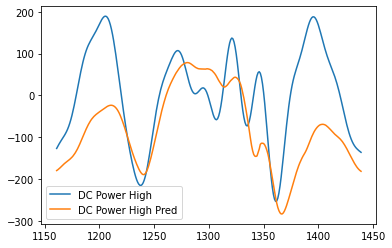

In [ ]:
df_high_final[['DC Power High', 'DC Power High Pred']].plot()

In [ ]:
df_final_clubbed = df_new.copy()
df_final_clubbed = df_final_clubbed[-279:]
df_final_clubbed['DC Power Pred'] = df_low_final['DC Power Low Pred'] + df_high_final['DC Power High Pred']
df_final_clubbed

,DateTime,Ambient Temp,Module Temp,GHI,GTI,DC Power,DC Power Pred
1161,2021-04-05 00:45:00,24.77210,25.16922,0.0,0.0,0.0,-68.202550
1162,2021-04-05 00:50:00,24.86908,25.21059,0.0,0.0,0.0,-68.268764
1163,2021-04-05 00:55:00,24.91127,25.26245,0.0,0.0,0.0,-68.839694
1164,2021-04-05 01:00:00,24.98851,25.33153,0.0,0.0,0.0,-69.713705
1165,2021-04-05 01:05:00,25.05391,25.40558,0.0,0.0,0.0,-70.618450
...,...,...,...,...,...,...,...
1435,2021-04-05 23:35:00,26.71674,25.73471,0.0,0.0,0.0,-139.959638
1436,2021-04-05 23:40:00,26.65835,25.61238,0.0,0.0,0.0,-138.636581
1437,2021-04-05 23:45:00,26.56718,25.57722,0.0,0.0,0.0,-137.301981
1438,2021-04-05 23:50:00,26.55491,25.61210,0.0,0.0,0.0,-136.027334


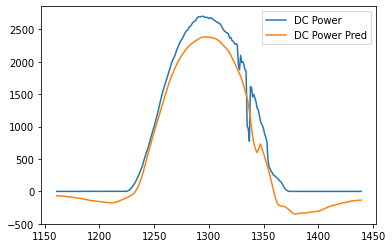

In [ ]:
df_final_clubbed[['DC Power', 'DC Power Pred']].plot()